# import libs


In [2]:
import os, torch, torch, tqdm
import sys, json, glob
import h5py
import numpy as np
import pandas as pd
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
import torch.nn.functional as F
from sklearn.metrics import precision_score, recall_score, f1_score
from sklearn.metrics import roc_curve, auc
from sklearn.manifold import TSNE
from scipy import interp
import SimpleITK as sitk
from PIL import Image
# import surface_distance as surfdist
sys.path.append("/home/zhang_istbi/data_disk/zhaobt/projects/tumor_cls/")

In [58]:
def acc(pred, y_true):
    res = 0
    for p, t in zip(pred, y_true):
        if p == t:
            res += 1
    return res/len(pred)

def cal_cls_res(label, pred, prob=None):
#     print("--------------------------------------------")
    p = precision_score(label, pred, average='binary')
    r = recall_score(label, pred, average='binary')
    f1score = f1_score(label, pred, average='binary')
    acc = np.sum(np.array(label)==np.array(pred))/len(pred)
    print("acc:", acc)
    print("precision_score:", p)
    print("recall_score:", r)
    print("f1_score:", f1score)
    roc_auc = None
    if prob is not None:
        fpr,tpr,threshold = roc_curve(label,prob) ###计算真正率和假正率
        roc_auc = auc(fpr,tpr)
        print("roc_auc:", roc_auc)
    return acc, p, r, f1score, roc_auc

def get_preb(prob):
    data = np.zeros_like(prob)
    data[prob>0.5] = 1
    return data

def merge_slice(index, pred, labels):
    data = {}
    label = []
    temp = -1
    temp_l = -1
    for idx, i in enumerate(index):
        if temp != i:
            temp = i
            label.append(labels[idx])
        if temp not in data:
            data[temp] = [pred[idx]]
        else:
            data[temp].append(pred[idx])
    return data, label

def votingBynum(data, cls_bound):
    pred_case = []
    prob_case = []
    for i in data:
        prob_case.append(sum(data[i])/len(data[i]))
        if sum(data[i])/len(data[i]) > cls_bound:
            pred_case.append(1)
        else:
            pred_case.append(0)
    return pred_case, prob_case

def votingByprob(pres_prob_case2, cls_bound):
    pred_case_2 = []
    prob_case_2 = []
    for idx, i in enumerate(pres_prob_case2):
    #     print(idx, i, label[i], np.mean(pres_prob_case2[i]))
        prob_case_2.append(np.mean(pres_prob_case2[i]))
        if np.mean(pres_prob_case2[i])> cls_bound:
            pred_case_2.append(1)
        else:
            pred_case_2.append(0)
    return pred_case_2, prob_case_2


def case_level_cls(labels, pred, indexs):
    data, label = merge_slice(indexs, pred, labels)
    max_acc = 0
    max_bound = 0
    for i in np.arange(0,1,0.01):
        pred_case_temp, _ = votingBynum(data, i)
        if acc(label, pred_case_temp) > max_acc:
            max_acc = acc(label, pred_case_temp)
            max_bound = i
    opt_pred, mean_prob= votingBynum(data, max_bound)
    cal_cls_res(label, opt_pred, mean_prob)
    print("max_bound：", max_bound)
    return label, np.array(mean_prob)
    
def case_level_cls_v2(labels, pres_prob, indexs):
    pres_prob_case2, label = merge_slice(indexs, pres_prob, labels)
    max_acc = 0
    max_bound = 0
    for i in np.arange(0,1,0.01):
        pred_case_temp, _ = votingByprob(pres_prob_case2, i)
        if acc(label, pred_case_temp) > max_acc:
            max_acc = acc(label, pred_case_temp)
            max_bound = i
    opt_pres, mean_prob = votingByprob(pres_prob_case2, 0.3)
    cal_cls_res(label, opt_pres, np.array(mean_prob))
    print("max_bound：", max_bound)
    return label, np.array(mean_prob)

def vis_roc(label_set, pred_set):
    tprs = []
    aucs = []
    mean_fpr = np.linspace(0,1,1000)
    i=1
    for label, pred in zip(label_set, pred_set):
        fpr,tpr,threshold = roc_curve(label, pred)
        roc_auc = auc(fpr,tpr)
        tprs.append(interp(mean_fpr, fpr, tpr))
        aucs.append(roc_auc)
        plt.plot(fpr,tpr,alpha=0.7, label='fold %d (AUC = %0.2f)' % (i, roc_auc))
        i += 1
    plt.plot([0, 1], [0, 1], linestyle='--', lw=2, color='r',
             label='Chance', alpha=.8)

    mean_tpr = np.mean(tprs, axis=0)
    mean_tpr[-1] = 1.0
    mean_auc = auc(mean_fpr, mean_tpr)
    std_auc = np.std(aucs)
    plt.plot(mean_fpr, mean_tpr, color='black',
             label=r'Mean(%0.2f $\pm$ %0.2f)' % (mean_auc, std_auc),
             lw=2, alpha=.8)

    std_tpr = np.std(tprs, axis=0)
    tprs_upper = np.minimum(mean_tpr + std_tpr, 1)
    tprs_lower = np.maximum(mean_tpr - std_tpr, 0)
    plt.fill_between(mean_fpr, tprs_lower, tprs_upper, color='grey', alpha=.2,
                     label=r'$\pm$ 1 std. dev.')
    plt.xlim([-0.05, 1.05])
    plt.ylim([-0.05, 1.05])
    plt.xlabel('False Positive Rate', fontsize=13)
    plt.ylabel('True Positive Rate',  fontsize=13)
    plt.title('Receiver operating characteristic example', fontsize=16)
    plt.legend(loc="lower right")
    plt.show()
#       breakak
# vis_roc([fold1_label, fold2_label, fold3_label, fold4_label, fold5_label],
#         [fold1_pred_prob, fold2_pred_prob, fold3_pred_prob, fold4_pred_prob, fold5_pred_prob])

# read res

In [3]:
def get_label_index(path, cls_label=1):
    labeled_f_val = h5py.File(path, 'r')
    labels = labeled_f_val['label'][:]
    indexs = labeled_f_val['meta_info'][:]
    labeled_f_val.close()
    temp = np.zeros_like(labels)
    temp[labels==cls_label]=1
    return temp, indexs

fold1_label, fold1_index = get_label_index(r"../../../dataset/tumor_cls/cross_val_h5_dataset/fold1_2d_mix_test.h5", cls_label=1)
fold2_label, fold2_index = get_label_index(r"../../../dataset/tumor_cls/cross_val_h5_dataset/fold2_2d_mix_test.h5", cls_label=1)
fold3_label, fold3_index = get_label_index(r"../../../dataset/tumor_cls/cross_val_h5_dataset/fold3_2d_mix_test.h5", cls_label=1)
fold4_label, fold4_index = get_label_index(r"../../../dataset/tumor_cls/cross_val_h5_dataset/fold4_2d_mix_test.h5", cls_label=1)
fold5_label, fold5_index = get_label_index(r"../../../dataset/tumor_cls/cross_val_h5_dataset/fold5_2d_mix_test.h5", cls_label=1)

In [4]:
fold1_label, fold1_index = get_label_index(r"../../../dataset/tumor_cls/cross_val_h5_dataset_baisC_5fold/fold1_2d_final_test.h5", cls_label=1)
fold2_label, fold2_index = get_label_index(r"../../../dataset/tumor_cls/cross_val_h5_dataset_baisC_5fold/fold2_2d_final_test.h5", cls_label=1)
fold3_label, fold3_index = get_label_index(r"../../../dataset/tumor_cls/cross_val_h5_dataset_baisC_5fold/fold3_2d_final_test.h5", cls_label=1)
fold4_label, fold4_index = get_label_index(r"../../../dataset/tumor_cls/cross_val_h5_dataset_baisC_5fold/fold4_2d_final_test.h5", cls_label=1)
fold5_label, fold5_index = get_label_index(r"../../../dataset/tumor_cls/cross_val_h5_dataset_baisC_5fold/fold5_2d_final_test.h5", cls_label=1)

In [5]:
fold1_dir = "../cpts/cls/resnest101_2d_cls_seg_fold1/pred-train-epoch100.npy"
fold2_dir = "../cpts/cls/resnest101_2d_cls_seg_fold2/pred-train-epoch100.npy"
fold3_dir = "../cpts/cls/resnest101_2d_cls_seg_fold3/pred-train-epoch100.npy"
fold4_dir = "../cpts/cls/resnest101_2d_cls_seg_fold4/pred-train-epoch100.npy"
fold5_dir = "../cpts/cls/resnest101_2d_cls_seg_fold5/pred-train-epoch100.npy"

In [6]:
fold1_dir = '../cpts/cls_final/xgb_4_classes/fold1/test_pred_tumors.npy'
fold2_dir = '../cpts/cls_final/xgb_4_classes/fold2/test_pred_tumors.npy'
fold3_dir = '../cpts/cls_final/xgb_4_classes/fold3/test_pred_tumors.npy'
fold4_dir = '../cpts/cls_final/xgb_4_classes/fold4/test_pred_tumors.npy'
fold5_dir = '../cpts/cls_final/xgb_4_classes/fold5/test_pred_tumors.npy'

In [7]:
fold1_pred_prob = np.load(fold1_dir)
fold2_pred_prob = np.load(fold2_dir)
fold3_pred_prob = np.load(fold3_dir)
fold4_pred_prob = np.load(fold4_dir)
fold5_pred_prob = np.load(fold5_dir)

fold1_pred = get_preb(fold1_pred_prob)
fold2_pred = get_preb(fold2_pred_prob)
fold3_pred = get_preb(fold3_pred_prob)
fold4_pred = get_preb(fold4_pred_prob)
fold5_pred = get_preb(fold5_pred_prob)


print(fold1_pred_prob.shape)
print(fold1_pred.shape)
print(fold1_pred_prob)
print(np.sum(fold1_pred_prob-fold1_pred))

(4, 1781)
(4, 1781)
[[1 1 1 ... 1 1 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 1 0 0]
 [0 1 1 ... 0 0 0]]
0


In [8]:
# fpr,tpr,threshold = roc_curve(fold1_label, fold1_pred_prob)
# print(fpr.shape)
# print(tpr.shape)
# print(threshold.shape)

In [9]:
# fold1_res = cal_cls_res(fold1_label, fold1_pred, fold1_pred_prob)
# fold2_res = cal_cls_res(fold2_label, fold2_pred, fold2_pred_prob)
# fold3_res = cal_cls_res(fold3_label, fold3_pred, fold3_pred_prob)
# fold4_res = cal_cls_res(fold4_label, fold4_pred, fold4_pred_prob)
# fold5_res = cal_cls_res(fold5_label, fold5_pred, fold5_pred_prob)

res==>:2
acc: 0.9259259259259259
precision_score: 0.0
recall_score: 0.0
f1_score: 0.0
roc_auc: nan
max_bound： 0.96
acc: 1.0
precision_score: 0.0
recall_score: 0.0
f1_score: 0.0
roc_auc: nan
max_bound： 0.98
acc: 0.9382716049382716
precision_score: 0.0
recall_score: 0.0
f1_score: 0.0
roc_auc: nan
max_bound： 0.96
acc: 0.9876543209876543
precision_score: 0.0
recall_score: 0.0
f1_score: 0.0
roc_auc: nan
max_bound： 0.98


/home/zhang_istbi/miniconda3/envs/pt10/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/zhang_istbi/miniconda3/envs/pt10/lib/python3.8/site-packages/sklearn/metrics/_ranking.py:999: UndefinedMetricWarning: No positive samples in y_true, true positive value should be meaningless
  warnings.warn(
/home/zhang_istbi/miniconda3/envs/pt10/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/zhang_istbi/miniconda3/envs/pt10/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Recall is ill-defined and 

acc: 1.0
precision_score: 0.0
recall_score: 0.0
f1_score: 0.0
roc_auc: nan
max_bound： 0.86


/home/zhang_istbi/miniconda3/envs/pt10/lib/python3.8/site-packages/sklearn/metrics/_ranking.py:999: UndefinedMetricWarning: No positive samples in y_true, true positive value should be meaningless
  warnings.warn(
/tmp/ipykernel_11669/1839971479.py:105: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead
  tprs.append(interp(mean_fpr, fpr, tpr))
/home/zhang_istbi/miniconda3/envs/pt10/lib/python3.8/site-packages/sklearn/metrics/_ranking.py:999: UndefinedMetricWarning: No positive samples in y_true, true positive value should be meaningless
  warnings.warn(
/tmp/ipykernel_11669/1839971479.py:105: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead
  tprs.append(interp(mean_fpr, fpr, tpr))
/home/zhang_istbi/miniconda3/envs/pt10/lib/python3.8/site-packages/sklearn/metrics/_ranking.py:999: UndefinedMetricWarning: No positive samples in y_true, true positive value should be meaning

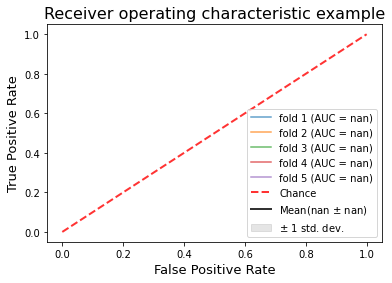

res==>:0
acc: 0.7407407407407407
precision_score: 0.9117647058823529
recall_score: 0.6326530612244898
f1_score: 0.746987951807229
roc_auc: 0.7815688775510204
max_bound： 0.04
acc: 0.654320987654321
precision_score: 0.7741935483870968
recall_score: 0.5333333333333333
f1_score: 0.631578947368421
roc_auc: 0.6765432098765432
max_bound： 0.06
acc: 0.654320987654321
precision_score: 0.8285714285714286
recall_score: 0.5686274509803921
f1_score: 0.6744186046511628
roc_auc: 0.7202614379084967
max_bound： 0.0
acc: 0.6666666666666666
precision_score: 0.7037037037037037
recall_score: 0.5
f1_score: 0.5846153846153846
roc_auc: 0.6692166462668299
max_bound： 0.0
acc: 0.75
precision_score: 0.8666666666666667
recall_score: 0.6046511627906976
f1_score: 0.7123287671232877
roc_auc: 0.7748156551332955
max_bound： 0.0


/tmp/ipykernel_11669/1839971479.py:105: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead
  tprs.append(interp(mean_fpr, fpr, tpr))
/tmp/ipykernel_11669/1839971479.py:105: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead
  tprs.append(interp(mean_fpr, fpr, tpr))
/tmp/ipykernel_11669/1839971479.py:105: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead
  tprs.append(interp(mean_fpr, fpr, tpr))
/tmp/ipykernel_11669/1839971479.py:105: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead
  tprs.append(interp(mean_fpr, fpr, tpr))
/tmp/ipykernel_11669/1839971479.py:105: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead
  tprs.append(interp(mean_fpr, fpr, tpr))


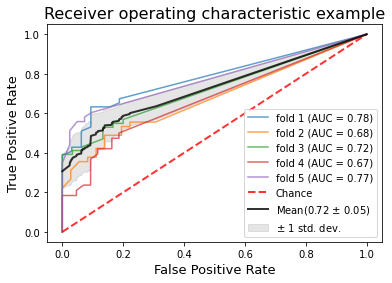

/home/zhang_istbi/miniconda3/envs/pt10/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/zhang_istbi/miniconda3/envs/pt10/lib/python3.8/site-packages/sklearn/metrics/_ranking.py:999: UndefinedMetricWarning: No positive samples in y_true, true positive value should be meaningless
  warnings.warn(


res==>:3
acc: 0.9876543209876543
precision_score: 0.0
recall_score: 0.0
f1_score: 0.0
roc_auc: nan
max_bound： 0.74
acc: 1.0
precision_score: 0.0
recall_score: 0.0
f1_score: 0.0
roc_auc: nan
max_bound： 0.92
acc: 0.9876543209876543
precision_score: 0.0
recall_score: 0.0
f1_score: 0.0
roc_auc: nan
max_bound： 0.9500000000000001
acc: 1.0
precision_score: 0.0
recall_score: 0.0
f1_score: 0.0
roc_auc: nan
max_bound： 0.9500000000000001
acc: 1.0
precision_score: 0.0
recall_score: 0.0
f1_score: 0.0
roc_auc: nan
max_bound： 0.67


/home/zhang_istbi/miniconda3/envs/pt10/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/zhang_istbi/miniconda3/envs/pt10/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/zhang_istbi/miniconda3/envs/pt10/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1570: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, "true nor predicted", "F-score is", len(true_sum))
/home/zhang_istbi/miniconda3/e

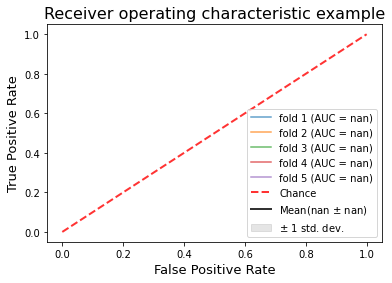

res==>:1
acc: 0.9259259259259259
precision_score: 0.8823529411764706
recall_score: 0.9375
f1_score: 0.9090909090909091
roc_auc: 0.9626913265306123
max_bound： 0.34
acc: 0.8888888888888888
precision_score: 0.8292682926829268
recall_score: 0.9444444444444444
f1_score: 0.883116883116883
roc_auc: 0.9080246913580247
max_bound： 0.55
acc: 0.8888888888888888
precision_score: 0.8620689655172413
recall_score: 0.8333333333333334
f1_score: 0.847457627118644
roc_auc: 0.8973856209150327
max_bound： 0.4
acc: 0.8641975308641975
precision_score: 0.8636363636363636
recall_score: 0.8837209302325582
f1_score: 0.8735632183908046
roc_auc: 0.8873929008567931
max_bound： 0.32
acc: 0.9404761904761905
precision_score: 0.9285714285714286
recall_score: 0.9512195121951219
f1_score: 0.9397590361445782
roc_auc: 0.9741917186613727
max_bound： 0.4


/tmp/ipykernel_11669/1839971479.py:105: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead
  tprs.append(interp(mean_fpr, fpr, tpr))
/tmp/ipykernel_11669/1839971479.py:105: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead
  tprs.append(interp(mean_fpr, fpr, tpr))
/tmp/ipykernel_11669/1839971479.py:105: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead
  tprs.append(interp(mean_fpr, fpr, tpr))
/tmp/ipykernel_11669/1839971479.py:105: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead
  tprs.append(interp(mean_fpr, fpr, tpr))
/tmp/ipykernel_11669/1839971479.py:105: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead
  tprs.append(interp(mean_fpr, fpr, tpr))


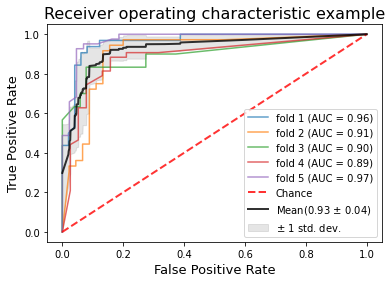

NameError: name 'labels' is not defined

In [10]:
index_temp = [2, 0, 3, 1]
for idx, i in enumerate(index_temp):
    print('res==>:{}'.format(i))
    temp_y = np.zeros_like(fold1_label)
    temp_y[fold1_label==i] = 1
    num_labe1, num_prob1 = case_level_cls(temp_y, fold1_pred[idx, :], fold1_index)
    
    temp_y = np.zeros_like(fold2_label)
    temp_y[fold2_label==i] = 1
    num_labe2, num_prob2 = case_level_cls(temp_y, fold2_pred[idx, :], fold2_index)
    
    temp_y = np.zeros_like(fold3_label)
    temp_y[fold3_label==i] = 1
    num_labe3, num_prob3 = case_level_cls(temp_y, fold3_pred[idx, :], fold3_index)
    
    temp_y = np.zeros_like(fold4_label)
    temp_y[fold4_label==i] = 1
    num_labe4, num_prob4 = case_level_cls(temp_y, fold4_pred[idx, :], fold4_index)
    
    temp_y = np.zeros_like(fold5_label)
    temp_y[fold5_label==i] = 1
    num_labe5, num_prob5 = case_level_cls(temp_y, fold5_pred[idx, :], fold5_index)
    vis_roc([num_labe1, num_labe2, num_labe3, num_labe4, num_labe5],
        [num_prob1, num_prob2, num_prob3, num_prob4, num_prob5])
    
#     cal_cls_res(temp_y, np.array(test_pred_tumors)[idx, :], np.array(test_pred_prob_tumors)[idx, :])
print(np.max(labels))

In [ ]:
num_labe1, num_prob1 = case_level_cls(fold1_label, fold1_pred, fold1_index)
num_labe2, num_prob2 = case_level_cls(fold2_label, fold2_pred, fold2_index)
num_labe3, num_prob3 = case_level_cls(fold3_label, fold3_pred, fold3_index)
num_labe4, num_prob4 = case_level_cls(fold4_label, fold4_pred, fold4_index)
num_labe5, num_prob5 = case_level_cls(fold5_label, fold5_pred, fold5_index)
vis_roc([num_labe1, num_labe2, num_labe3, num_labe4, num_labe5],
        [num_prob1, num_prob2, num_prob3, num_prob4, num_prob5])

In [ ]:
# case_level_cls_v2(fold1_label, fold1_pred_prob, fold1_index)
# case_level_cls_v2(fold2_label, fold2_pred_prob, fold2_index)
# case_level_cls_v2(fold3_label, fold3_pred_prob, fold3_index)
# case_level_cls_v2(fold4_label, fold4_pred_prob, fold4_index)
# case_level_cls_v2(fold5_label, fold5_pred_prob, fold5_index)

weiht_labe1, weiht_prob1 = case_level_cls_v2(fold1_label, fold1_pred_prob, fold1_index)
weiht_labe2, weiht_prob2 = case_level_cls_v2(fold2_label, fold2_pred_prob, fold2_index)
weiht_labe3, weiht_prob3 = case_level_cls_v2(fold3_label, fold3_pred_prob, fold3_index)
weiht_labe4, weiht_prob4 = case_level_cls_v2(fold4_label, fold4_pred_prob, fold4_index)
weiht_labe5, weiht_prob5 = case_level_cls_v2(fold5_label, fold5_pred_prob, fold5_index)
vis_roc([weiht_labe1, weiht_labe2, weiht_labe3, weiht_labe4, weiht_labe5],
        [weiht_prob1, weiht_prob2, weiht_prob3, weiht_prob4, weiht_prob5])

# EXPERTS

In [ ]:
root_dir = '../data/expert_res/'

In [ ]:
t1p_res_expert = glob.glob(root_dir+'*T1+2*')

In [ ]:
t1p_res_expert

In [ ]:
df_1 = pd.read_excel(t1p_res_expert[1])

In [ ]:
df_1

In [ ]:
def get_data_xlsx(path):
    df_1 = pd.read_excel(path)
    true_labels = []
    preds = []
    for i in df_1.iterrows():
    #     print(i[1])
        true_label = i[1]['pathology']
        if "hemangioblastoma" in i[1]['pathology']:  # 血管细胞瘤
            label = 1
        elif "angiocavernoma" in i[1]['pathology']:  # 海绵状血管瘤
            label = 0
        elif "III-IV_glioma" in i[1]['pathology']:  # 3-4型胶质瘤
            label = 2
        elif "pilocytic_astrocytoma" in i[1]['pathology']:
            label = 3
        else:
            raise Exception("Error path")
    #     print(label)


        if i[1]['hemangioblastoma'] == 1:
            pred = 1
        elif i[1]['angiocavernoma'] == 1:
            pred = 0
        elif i[1]['III-IV_glioma'] == 1:
            pred = 2
        elif i[1]['pilocytic_astrocytoma'] == 1:
            pred = 3
    #     print(pred)
        true_labels.append(label)
        preds.append(pred)
    #     break
    true_labels = np.array(true_labels)
    preds = np.array(preds)
    return true_labels, preds




In [ ]:
acc(true_labels, preds)

In [ ]:
def show_res(true_labels, preds):
    reses = []
    for i in range(4):
        print('res==>:{}'.format(i))
        temp_y = np.zeros_like(true_labels)
        temp_pred = np.zeros_like(true_labels) 

        temp_y[true_labels==i] = 1
        temp_pred[preds==i] = 1
        res = cal_cls_res(temp_y, temp_pred, temp_pred)
        reses.append(res)
    return reses
# acc, p, r, f1score, roc_auc

In [ ]:
final_data = []
for j in t1p_res_expert:
    print("==============================================",j)
    labels, preds = get_data_xlsx(j)
    print(acc(labels, preds))
    reses = show_res(true_labels, preds)
    reses = np.array(reses)
    final_data.append(reses)
# print(reses)

In [ ]:
final_data_arr = np.concatenate(final_data, axis=0)

In [ ]:
final_data_arr.shape

In [ ]:
a = [[i]*4 for i in t1p_res_expert]
b = []
for j in a:
    b+=j
c = ['angiocavernoma','hemangioblastoma','III-IV_glioma','pilocytic_astrocytoma']*4

In [ ]:
data = {'expert name':b, 'tumor type':c, 'acc':final_data_arr[:,0], 'precision_score':final_data_arr[:,1],
       'recall_score':final_data_arr[:,2], 'f1_score':final_data_arr[:,3], 'roc_auc':final_data_arr[:,4]}

In [ ]:
df_tosave = pd.DataFrame(data)

In [ ]:
df_tosave

In [ ]:
df_tosave.to_excel('../data/expert_res/res_experts.xlsx', sheet_name='sheet1')

# fig1

In [69]:
# labeled_f_val = h5py.File(r"../../../dataset/tumor_cls/cross_val_h5_dataset_baisC_5fold/fold5_2d_final_test.h5", 'r')
# labeled_f_val = h5py.File(r"../../../dataset/tumor_cls/cross_val_h5_dataset_baisC_5fold/fold5_2d_final_test.h5", 'r')

# labels = labeled_f_val['label'][:]
# imgs= labeled_f_val['img'][:]
# masks = labeled_f_val['mask'][:]
# indexs = labeled_f_val['meta_info'][:]
# labeled_f_val.close()

labeled_f_val = h5py.File(r"../../../dataset/tumor_cls/h5_dataset_expert/2d_deskull_test.h5", 'r')
labels = labeled_f_val['label'][:]
imgs= labeled_f_val['img'][:]
masks = labeled_f_val['mask'][:]
indexs = labeled_f_val['index_info'][:]
print(labeled_f_val['index_info'])
# labeled_f_val.close()
labels[labels != 1] = 0
val_cls_dataset = data_generator.cls_val_2D_age(labeled_f_val['img'],
                                                labeled_f_val['mask'], labels,
                                                labeled_f_val['age_info'], labeled_f_val['sex_info'], )
val_dataLoader = DataLoader(val_cls_dataset, batch_size=1, shuffle=False)

<HDF5 dataset "index_info": shape (3062,), type "<i8">


([], [])

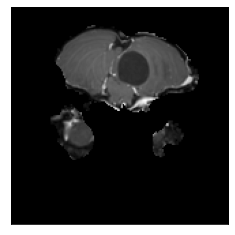

In [81]:
plt.imshow(imgs[16,:,:], cmap='gray')
plt.xticks([])
plt.yticks([])

(160, 160)
float32
[0. 1.]


([], [])

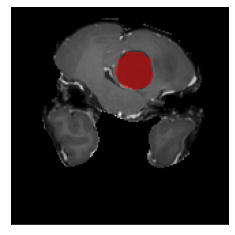

In [66]:
plt.imshow(imgs[23,:,:], cmap='gray')
temp = masks[23,:,:].copy()
temp = temp.astype('float32')
print(temp.shape)
print(temp.dtype)
print(np.unique(temp))
temp[temp==0]=np.nan
plt.imshow(temp,cmap='hsv', alpha=0.5)
plt.xticks([])
plt.yticks([])

In [ ]:
plt.imshow(imgs[,:,:], cmap='gray')
plt.xticks([])
plt.yticks([])

# result version 2

In [69]:
root_dir = '../data/expert_res/'
t1p_res_expert = glob.glob(root_dir+'*T1+2*')
df_1 = pd.read_excel(t1p_res_expert[1])
df_1

,number,name,age,pilocytic_astrocytoma,angiocavernoma,hemangioblastoma,III-IV_glioma,pathology
0,1,bai_lei,51,NaN,NaN,1.0,NaN,hemangioblastoma
1,2,bai_zhi_yang,36,NaN,NaN,NaN,1.0,III-IV_glioma
2,3,cai_chun_jun,39,NaN,1.0,NaN,NaN,angiocavernoma
3,4,cao_yi_wen,39,NaN,1.0,NaN,NaN,III-IV_glioma
4,5,chen_ai_ping,47,NaN,NaN,NaN,1.0,angiocavernoma
...,...,...,...,...,...,...,...,...
95,96,zhou_chao,36,NaN,NaN,NaN,1.0,angiocavernoma
96,97,zhou_he_hua,63,NaN,NaN,1.0,NaN,hemangioblastoma
97,98,zhou_he_ming,75,NaN,1.0,NaN,NaN,angiocavernoma
98,99,zhu_ya_fang,70,NaN,NaN,1.0,NaN,hemangioblastoma


In [70]:
df_2 = pd.read_excel('../data/expert_res/v2_pred_res_macacc.xlsx')
df_2

,Unnamed: 0,datasets,tumor_type,name,glabel,gp_temp,gpred_temp,gmax_temp,alabel,ap_temp,apred_temp,amax_temp,plabel,pp_temp,ppred_temp,pmax_temp,hlabel,hp_temp,hpred_temp,hmax_temp
0,0,tumor_dataset3,hemangioblastoma,pu_dan_hui,0,0.366667,0,0.67,0,0.000000,0,0.22,0,0.000000,0,0.07,1,0.733333,1,0.36
1,1,tumor_dataset1,hemangioblastoma,yang_yang,0,0.000000,0,0.67,0,0.000000,0,0.22,0,0.000000,0,0.07,1,0.945946,1,0.36
2,2,tumor_dataset1,angiocavernoma,mou_han_wei,0,0.000000,0,0.67,1,1.000000,1,0.22,0,0.000000,0,0.07,0,0.000000,0,0.36
3,3,tumor_dataset1,hemangioblastoma,chen_xian_ming,0,0.000000,0,0.67,0,0.000000,0,0.22,0,0.000000,0,0.07,1,0.750000,1,0.36
4,4,tumor_dataset1,angiocavernoma,dong_zheng,0,0.000000,0,0.67,1,0.258065,1,0.22,0,0.000000,0,0.07,0,0.096774,0,0.36
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
403,403,tumor_dataset2,hemangioblastoma,xu_li,0,0.432432,0,0.58,0,0.000000,0,0.11,0,0.027027,0,0.46,1,0.594595,1,0.44
404,404,tumor_dataset2,pilocytic_astrocytoma,ma_shu_min,0,0.000000,0,0.58,0,0.500000,1,0.11,1,0.000000,0,0.46,0,0.000000,0,0.44
405,405,tumor_dataset1,III-IV_glioma,yan_ju_xiang,1,0.080000,0,0.58,0,0.280000,1,0.11,0,0.000000,0,0.46,0,0.000000,0,0.44
406,406,tumor_dataset2,hemangioblastoma,shen_chun_lin,0,0.000000,0,0.58,0,0.000000,0,0.11,0,0.000000,0,0.46,1,1.000000,1,0.44


In [72]:
# selected_res = []
aa = df_1['name'].tolist()
res = df_2.loc[df_2['name'].isin(aa)]
# res = df_2
res.to_excel('../data/expert_res/v2_pred_res_select.xlsx', sheet_name='sheet1')
res

,Unnamed: 0,datasets,tumor_type,name,glabel,gp_temp,gpred_temp,gmax_temp,alabel,ap_temp,apred_temp,amax_temp,plabel,pp_temp,ppred_temp,pmax_temp,hlabel,hp_temp,hpred_temp,hmax_temp
5,5,tumor_dataset2,hemangioblastoma,bai_lei,0,0.289474,0,0.67,0,0.000000,0,0.22,0,0.000000,0,0.07,1,0.815789,1,0.36
8,8,tumor_dataset1,III-IV_glioma,cao_yi_wen,1,0.000000,0,0.67,0,0.500000,1,0.22,0,0.000000,0,0.07,0,0.166667,0,0.36
12,12,tumor_dataset2,angiocavernoma,xiang_jie,0,0.600000,0,0.67,1,0.000000,0,0.22,0,0.000000,0,0.07,0,0.000000,0,0.36
18,18,tumor_dataset1,angiocavernoma,wang_qiang,0,0.000000,0,0.67,1,0.800000,1,0.22,0,0.000000,0,0.07,0,0.100000,0,0.36
23,23,tumor_dataset2,III-IV_glioma,xiang_mei_ping,1,0.000000,0,0.67,0,0.605263,1,0.22,0,0.131579,1,0.07,0,0.000000,0,0.36
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
395,395,tumor_dataset1,angiocavernoma,zheng_wei,0,0.000000,0,0.58,1,0.500000,1,0.11,0,0.000000,0,0.46,0,0.000000,0,0.44
398,398,tumor_dataset2,hemangioblastoma,gao_hong,0,0.000000,0,0.58,0,0.000000,0,0.11,0,0.000000,0,0.46,1,1.000000,1,0.44
399,399,tumor_dataset2,III-IV_glioma,wang_zhi_cheng,1,0.375000,0,0.58,0,0.250000,1,0.11,0,0.000000,0,0.46,0,0.125000,0,0.44
404,404,tumor_dataset2,pilocytic_astrocytoma,ma_shu_min,0,0.000000,0,0.58,0,0.500000,1,0.11,1,0.000000,0,0.46,0,0.000000,0,0.44


In [73]:
# for i in cc.iterrows():
# #     print(i[1])
# #     print(i[1]['glabel']+i[1]['plabel']+i[1]['hlabel']+i[1]['alabel'])
#     print(i[1]['gpred_temp']+i[1]['ppred_temp']+i[1]['hpred_temp']+i[1]['apred_temp'])

In [74]:
temp_y = res['glabel'].tolist()
temp_pred = res['gpred_temp'].tolist()
temp_prob = res['gp_temp'].tolist()
stat_res = cal_cls_res(temp_y, temp_pred, temp_prob)

acc: 0.85
precision_score: 0.6666666666666666
recall_score: 0.3333333333333333
f1_score: 0.4444444444444444
roc_auc: 0.7598238482384824


In [75]:
temp_y = res['plabel'].tolist()
temp_pred = res['ppred_temp'].tolist()
temp_prob = res['pp_temp'].tolist()
stat_res = cal_cls_res(temp_y, temp_pred, temp_prob)

acc: 0.75
precision_score: 0.6
recall_score: 0.32142857142857145
f1_score: 0.41860465116279066
roc_auc: 0.696924603174603


In [76]:
temp_y = res['hlabel'].tolist()
temp_pred = res['hpred_temp'].tolist()
temp_prob = res['hp_temp'].tolist()
stat_res = cal_cls_res(temp_y, temp_pred, temp_prob)

acc: 0.85
precision_score: 0.675
recall_score: 0.9310344827586207
f1_score: 0.7826086956521738
roc_auc: 0.9341913550267119


In [77]:
temp_y = res['alabel'].tolist()
temp_pred = res['apred_temp'].tolist()
temp_prob = res['ap_temp'].tolist()
stat_res = cal_cls_res(temp_y, temp_pred, temp_prob)

acc: 0.9
precision_score: 0.8
recall_score: 0.8
f1_score: 0.8000000000000002
roc_auc: 0.8949333333333334


# result version 3
age_cls

In [ ]:
data = open("../data/name_age/age_dataset.json", "r")
age_dataset = json.load(data)
data.close()
stat_ages = {}
for i in age_dataset:
    temp = []
    for j in age_dataset[i]:
        temp.append(age_dataset[i][j])
    print(i, np.mean(temp),"±",np.std(temp))
    stat_ages[i] = np.mean(temp)

In [ ]:
45.09051724137931 - 2*13.88

In [ ]:
ages = []
for i in res.iterrows():
    try:
#                 print(idx,i, age_dataset[name[6]][name[7]])
        ages.append(age_dataset[i[1]['tumor_type']][i[1]['name']])
    except:
        print('no data')
        ages.append(stat_ages[i[1]['tumor_type']])

In [ ]:
temp_y = res['hlabel'].tolist()
temp_pred = res['hpred_temp'].tolist()
temp_prob = res['hp_temp'].tolist()

ans = 0
h_cases = 0
for i in range(100):
    if temp_y[i]==1 and 17.33<=ages[i]<=72.85:
#         pass
        h_cases += 1
    elif temp_y[i]==1:
        ans+=1
        h_cases += 1
print(ans, h_cases)        
    

In [ ]:
ans = 0
h_cases = 0
for i in range(100):
    if temp_pred[i]==1 and 17.33<=ages[i]<=72.85:
#         pass
        h_cases += 1
    elif temp_pred[i]==1:
        ans+=1
        h_cases += 1
print(ans, h_cases)   

In [ ]:
stat_res = cal_cls_res(temp_y, temp_pred, temp_prob)

# fig4

In [ ]:
expert_fn = '../../../dataset/tumor_cls/tumor_dataset2/hemangioblastoma/li_ke_lu/for_train/T1P_biasC.nii.gz'
nn_fn = '../../../dataset/tumor_cls/tumor_dataset2/hemangioblastoma/ying_zheng/for_train/T1P_biasC.nii.gz'
expert_fp = '../../../dataset/tumor_cls/tumor_dataset1/angiocavernoma/ma_jing_bo//for_train/T1P_biasC.nii.gz'
nn_fp = '../../../dataset/tumor_cls/tumor_dataset2/pilocytic_astrocytoma/ye_qin_yong/for_train/T1P_biasC.nii.gz'

In [84]:
expert_fn = '../../../dataset/tumor_cls/tumor_dataset2/hemangioblastoma/li_ke_lu/for_train/T1P_biasC.nii.gz'
nn_fn = '../../../dataset/tumor_cls/tumor_dataset2/hemangioblastoma/xiao_wang_gao/for_train/T1P_biasC.nii.gz'
expert_fp = '../../../dataset/tumor_cls/tumor_dataset1/angiocavernoma/ma_jing_bo//for_train/T1P_biasC.nii.gz'
nn_fp = '../../../dataset/tumor_cls/tumor_dataset2/pilocytic_astrocytoma/ye_qin_yong/for_train/T1P_biasC.nii.gz'

In [85]:
data = sitk.ReadImage(nn_fn)
data = sitk.GetArrayFromImage(data)
print(data.shape)

(16, 512, 512)


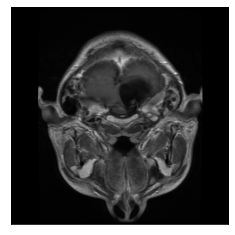

In [86]:
plt.imshow(data[1,:,:], cmap='gray')
plt.xticks([])
plt.yticks([])
plt.show()

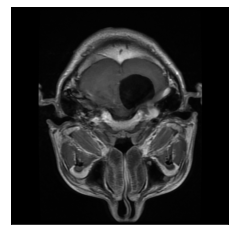

In [87]:
plt.imshow(data[2,:,:], cmap='gray')
plt.xticks([])
plt.yticks([])
plt.show()

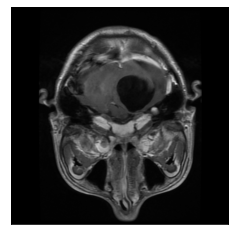

In [88]:
plt.imshow(data[3,:,:], cmap='gray')
plt.xticks([])
plt.yticks([])
plt.show()

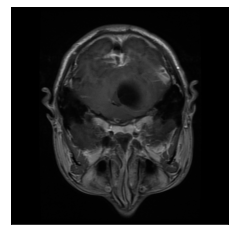

In [89]:
plt.imshow(data[4,:,:], cmap='gray')
plt.xticks([])
plt.yticks([])
plt.show()

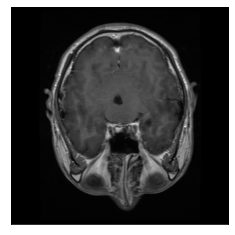

In [90]:
plt.imshow(data[5,:,:], cmap='gray')
plt.xticks([])
plt.yticks([])
plt.show()

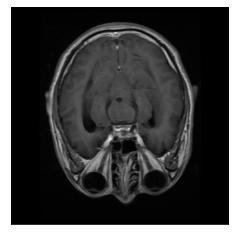

In [91]:
plt.imshow(data[6,:,:], cmap='gray')
plt.xticks([])
plt.yticks([])
plt.show()

# grad cam fig5

In [4]:
import torch.nn.functional as F
sys.path.append("/home/zhang_istbi/data_disk/zhaobt/projects/tumor_cls/")

from nets import Losses
from utils import data_generator
from nets import unet, resnet
from utils import file_io
from utils import logger
from utils import model_io

pathes = ["../cpts/cls_expert/2d_xuemu_deskull_prior/model/400_model.pth",
          "../cpts/cls_expert/2d_PA_deskull_prior/model/400_model.pth",
          "../cpts/cls_expert/2d_haimian_deskull_prior/model/400_model.pth",
          "../cpts/cls_expert/2d_giloma_deskull_prior/model/400_model.pth",
         ]
checkpoint = torch.load(pathes[0])
model = unet.UnetPP_Cls_age(encoder_name='resnet18', in_channels=1, classes=2, aux_params=dict(
                            pooling='avg',  # one of 'avg', 'max'
                            dropout=0,  # dropout ratio, default is None
                            activation=None,  # activation function, default is None
                            classes=2,  # define number of output labels
                            ))
#     model = unet.UnetPlusPlus_Cls('resnet18', 2, 2 )
#     print(model)
model.load_state_dict(checkpoint['state_dict'])

<All keys matched successfully>

In [15]:
class CamExtractor():
    """
        Extracts cam features from the model
    """

    def __init__(self, model, cls):
        self.model = model
        self.cls = cls
        self.gradients = []

    def save_gradient(self, grad):
        self.gradients.append(grad)

    def forward_pass_on_convolutions(self, x):
        """
            Does a forward pass on convolutions, hooks the function at given layer
        """
        conv_output = []
        x = self.model.conv1(x)
        x = self.model.bn1(x)
        x = self.model.relu(x)
        x = self.model.maxpool(x)

        x = self.model.layer1(x)
        x.register_hook(self.save_gradient)
        conv_output.append(x)  # Save the convolution output on that layer

        x = self.model.layer2(x)
        x.register_hook(self.save_gradient)
        conv_output.append(x)

        x = self.model.layer3(x)
        x.register_hook(self.save_gradient)
        conv_output.append(x)

        x = self.model.layer4(x)
        x.register_hook(self.save_gradient)
        conv_output.append(x)

        return conv_output, x
    def forward_pass(self, x):
        """
            Does a full forward pass on the model
        """
        # Forward pass on the convolutions
        conv_output, x = self.forward_pass_on_convolutions(x)
        x = self.cls(x)
        return conv_output, x


In [23]:

class GradCam():
    """
        Produces class activation map
    """

    def __init__(self, model, cls):
        self.model = model.cpu()
        self.cls = cls.cpu()
        self.model.eval()
        self.cls.eval()
        # Define extractor
        self.extractor = CamExtractor(self.model, self.cls)

    def generate_cam(self, input_image, target_layer, target_class=None):

        # Full forward pass
        # conv_output is the output of convolutions at specified layer
        # model_output is the final output of the model (1, 1000)
        conv_output, model_output = self.extractor.forward_pass(input_image)
        if target_class is None:
            target_class = np.argmax(model_output.data.numpy())
        # Target for backprop
        one_hot_output = torch.FloatTensor(1, model_output.size()[-1]).zero_()
        one_hot_output[0][target_class] = 1

        # Zero grads
        self.model.zero_grad()
        self.cls.zero_grad()
        # Backward pass with specified target
        model_output.backward(gradient=one_hot_output, retain_graph=True)

        # Get hooked gradients,gradients
        # layer0:(1,512,7,7), layer1:(1,256,14,14), layer2:(1,128,28,28), layer3:(1,64,56,56),
        # 与后面conv_output是反的，因此需要逆序处理
        guided_gradients = self.extractor.gradients[-1 - target_layer].data.numpy()[0]
        print('guided_gradients1',len(self.extractor.gradients))
        print('guided_gradients2',guided_gradients.shape)
        # Get convolution outputs
        # layer0.shape:(64,56,56) layer1:(128,28,28) layer2:(256,14,14) layer3:(512,7,7)
        target = conv_output[target_layer].data.numpy()[0]
        # Get weights from gradients
        weights = np.mean(guided_gradients, axis=(1, 2))  # Take averages for each gradient
        print('guided_gradients3',weights.shape)
        print('target',target.shape)
        # Create empty numpy array for cam
        cam = np.ones(target.shape[1:], dtype=np.float32)

        # Have a look at issue #11 to check why the above is np.ones and not np.zeros
        # Multiply each weight with its conv output and then, sum
        for i, w in enumerate(weights):
            cam += w * target[i, :, :]
        print('cam',cam.shape)
        cam = np.maximum(cam, 0)
        cam = (cam - np.min(cam)) / (np.max(cam) - np.min(cam))  # Normalize between 0-1
        cam = np.uint8(cam * 255)  # Scale between 0-255 to visualize
        cam_resize = Image.fromarray(cam).resize((input_image.shape[2],
                                                  input_image.shape[3]), Image.ANTIALIAS)
        cam = np.uint8(cam_resize) / 255

        return model_output, cam


In [6]:
labeled_f_train = h5py.File(r"../../../dataset/tumor_cls/h5_dataset_expert/2d_deskull_train.h5", 'r')
train_labels = labeled_f_train['label'][:]
train_imgs= labeled_f_train['img'][:]
train_masks = labeled_f_train['mask'][:]
train_indexs = labeled_f_train['meta_info'][:]

# np.save('../cpts/cls_final/xgb_4_classes/fold1/train_indexs.npy', train_indexs)
# np.save('../cpts/cls_final/xgb_4_classes/fold1/train_labels.npy', train_labels)
labeled_f_train.close()

KeyError: "Unable to open object (object 'meta_info' doesn't exist)"

In [9]:
train_cls_dataset = data_generator.cls_generator_2D(train_imgs,
                                                    train_masks, train_labels,
                                                     rotate_degree=0,
                                                     noise_sigma=(0, 1e-9), )
train_dataLoader = DataLoader(train_cls_dataset, batch_size=1, shuffle=False)

In [19]:
labeled_f_val = h5py.File(r"../../../dataset/tumor_cls/h5_dataset_expert/2d_deskull_train.h5", 'r')
labels = labeled_f_val['label'][:]
imgs= labeled_f_val['img'][:]
masks = labeled_f_val['mask'][:]
indexs = labeled_f_val['index_info'][:]
print(labeled_f_val['index_info'])
# labeled_f_val.close()
labels[labels != 1] = 0
val_cls_dataset = data_generator.cls_val_2D_age(labeled_f_val['img'],
                                                labeled_f_val['mask'], labels,
                                                labeled_f_val['age_info'], labeled_f_val['sex_info'], )
val_dataLoader = DataLoader(val_cls_dataset, batch_size=1, shuffle=False)
# labeled_f_val.close()


<HDF5 dataset "index_info": shape (9348,), type "<i8">


In [9]:
path = "../cpts/cls_expert/2d_xuemu_deskull_prior/model/400_model.pth"
print("running {}".format(path))
checkpoint = torch.load(path)
model.load_state_dict(checkpoint['state_dict'])

running ../cpts/cls_expert/2d_xuemu_deskull_prior/model/400_model.pth


<All keys matched successfully>

In [13]:
grad_cam_enc = model.encoder
grad_cam_cls = model.classification_head
print(grad_cam_cls.state_dict())

OrderedDict([('3.weight', tensor([[-0.0479,  0.0538, -0.0338,  ..., -0.0302,  0.0111,  0.0532],
        [ 0.0265, -0.0304,  0.0378,  ...,  0.0276, -0.0362, -0.0335]])), ('3.bias', tensor([ 0.8449, -0.7770]))])


In [17]:
Gcam = GradCam(grad_cam_enc, grad_cam_cls)

0
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([1])
guided_gradients1 16935
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 1


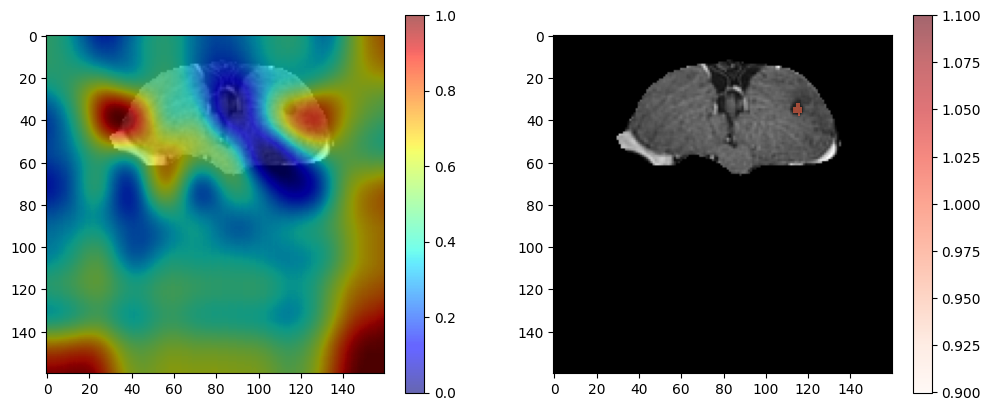

(2,)
1
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([1])
guided_gradients1 16939
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 1


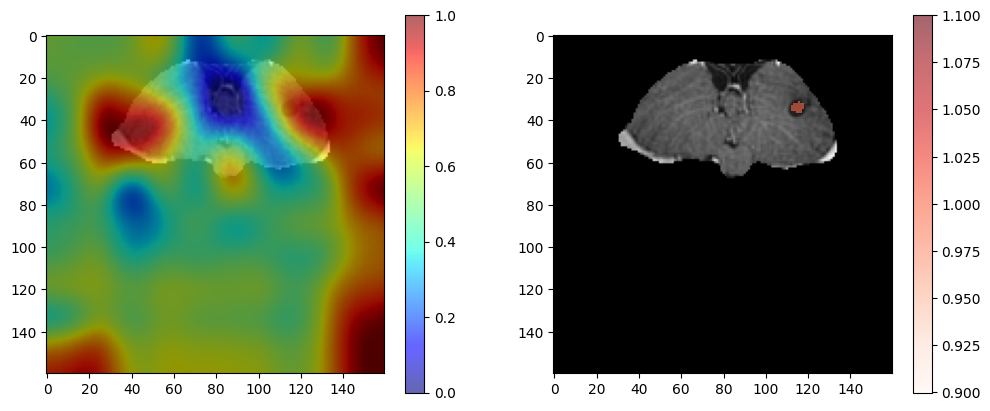

(2,)
2
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([1])
guided_gradients1 16943
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 1


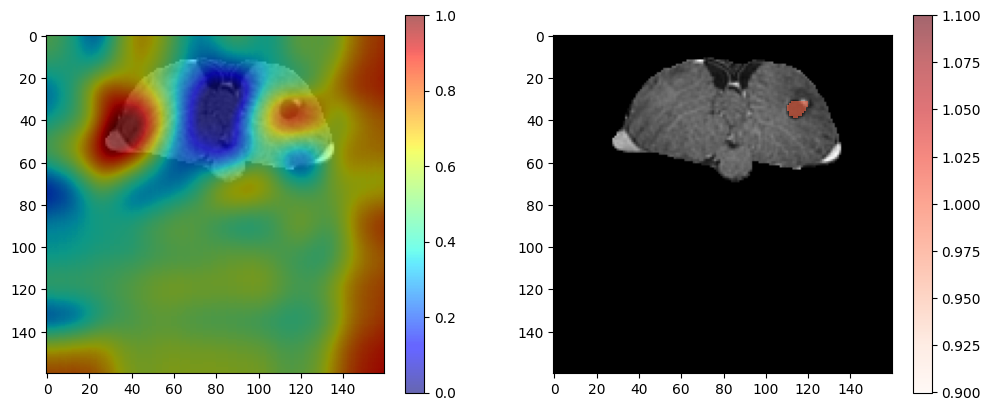

(2,)
3
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([1])
guided_gradients1 16947
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 1


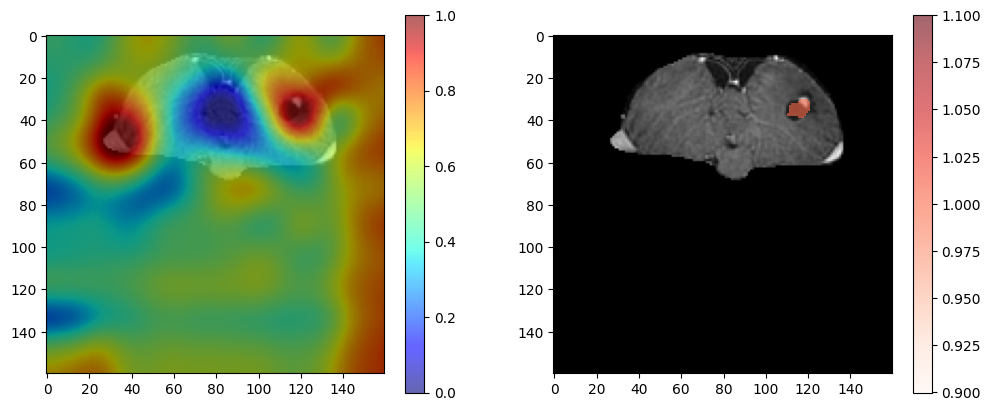

(2,)
4
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([1])
guided_gradients1 16951
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 1


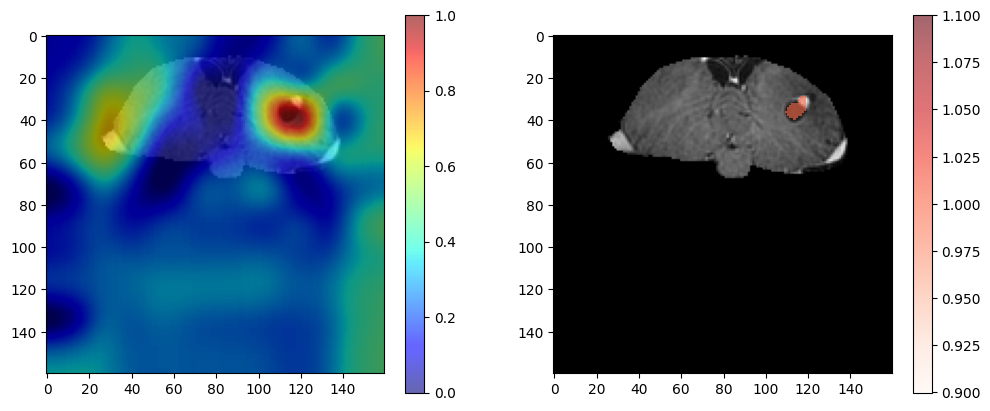

(2,)
5
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([1])
guided_gradients1 16955
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 1


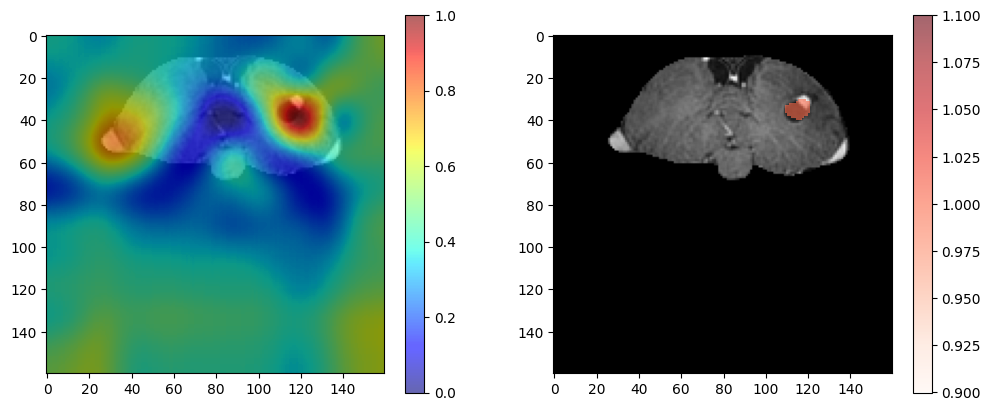

(2,)
6
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([1])
guided_gradients1 16959
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 1


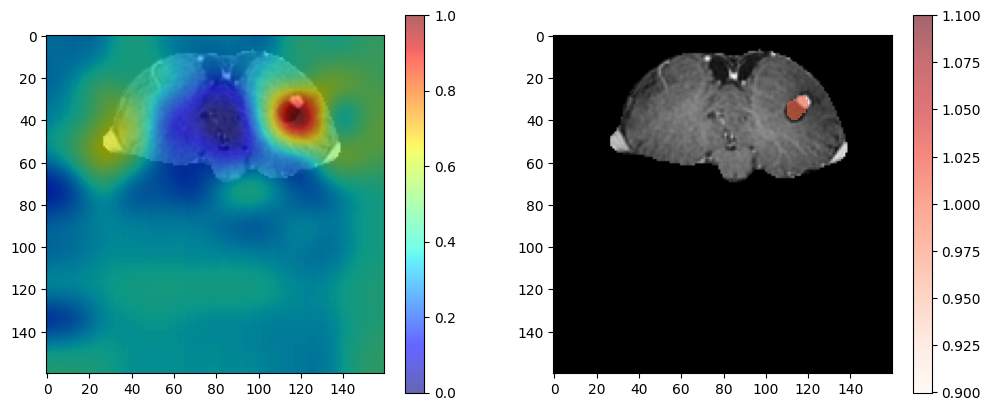

(2,)
7
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([1])
guided_gradients1 16963
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 1


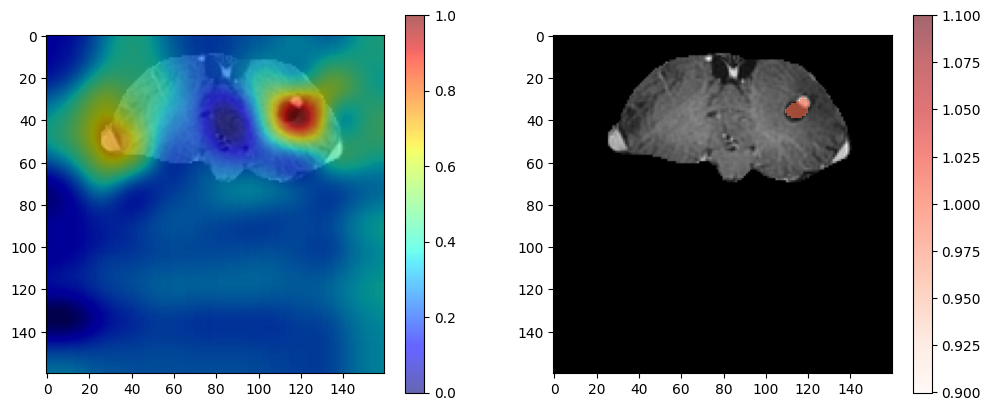

(2,)
8
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([1])
guided_gradients1 16967
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 1


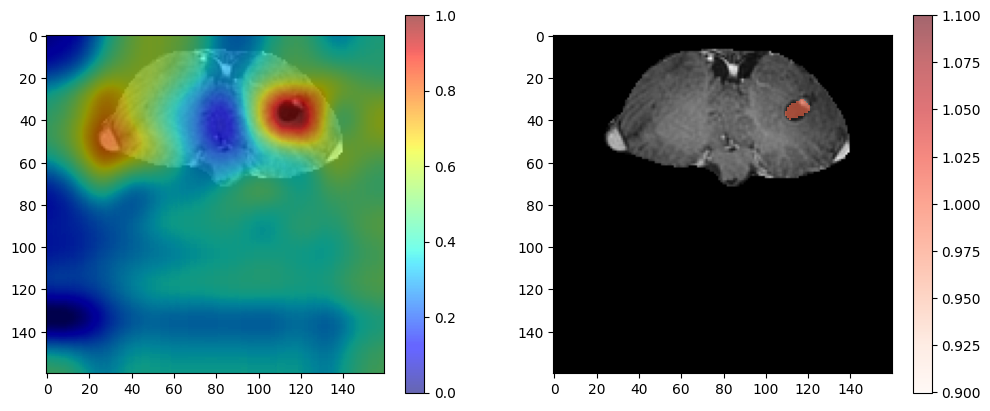

(2,)
9
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([1])
guided_gradients1 16971
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 1


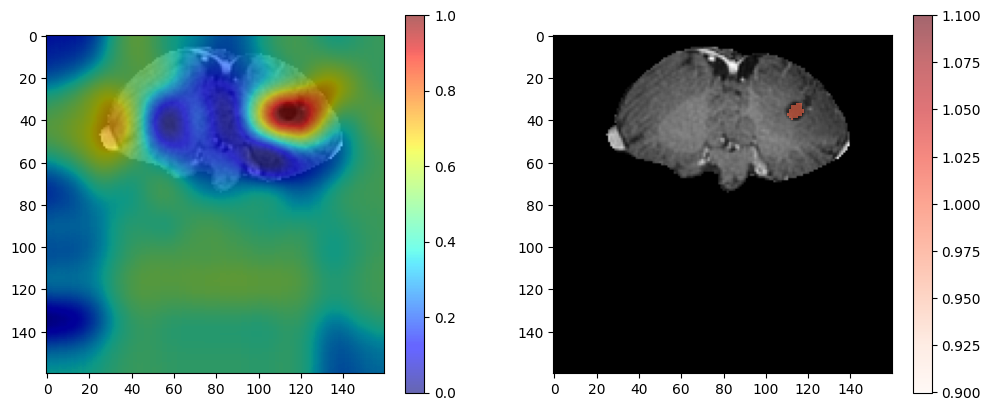

(2,)
10
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([1])
guided_gradients1 16975
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 1


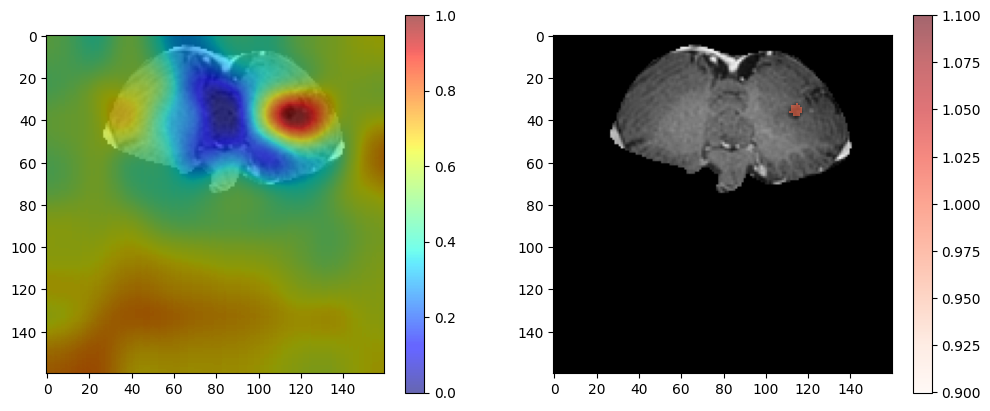

(2,)
11
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([0])
guided_gradients1 16979
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 0


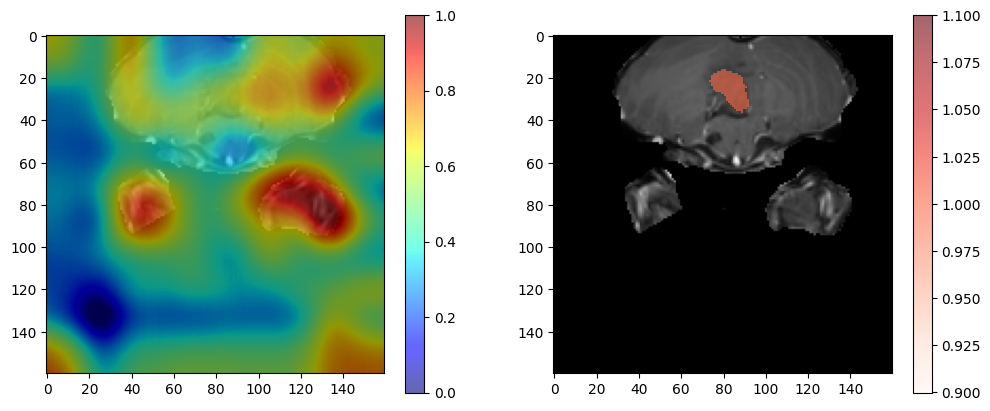

(2,)
12
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([0])
guided_gradients1 16983
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 0


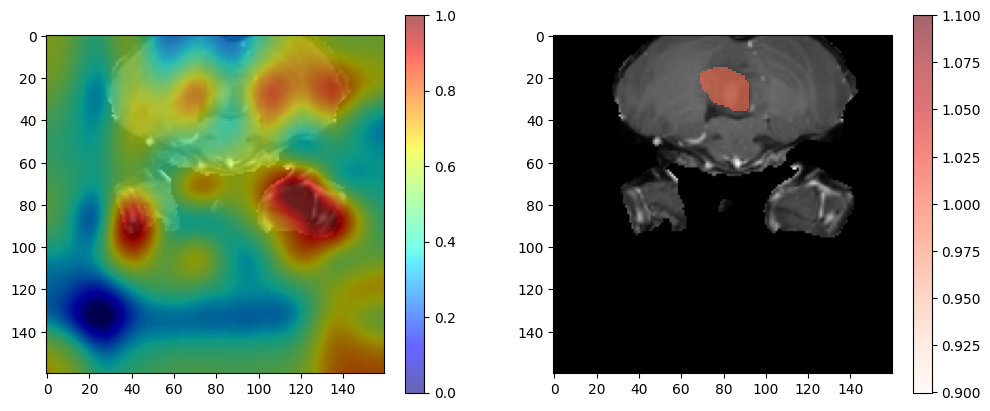

(2,)
13
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([0])
guided_gradients1 16987
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 0


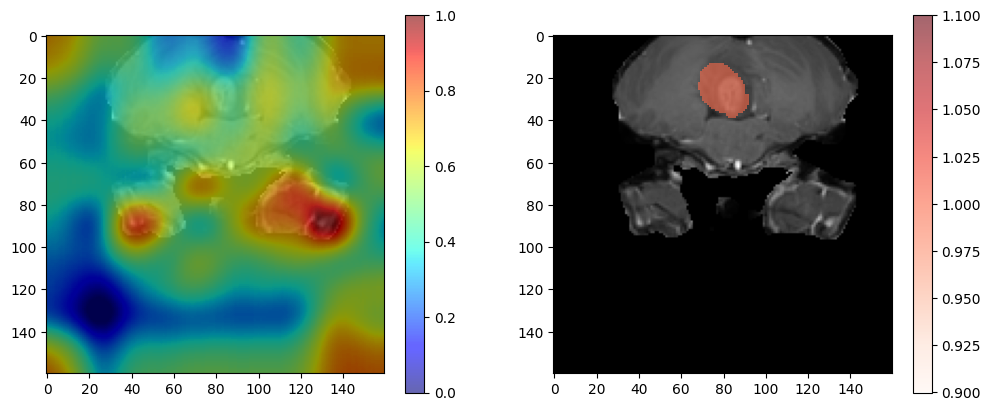

(2,)
14
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([0])
guided_gradients1 16991
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 0


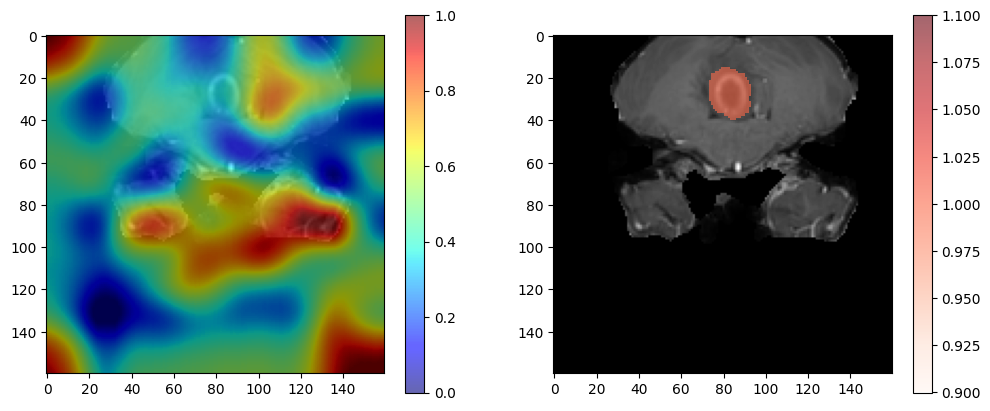

(2,)
15
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([0])
guided_gradients1 16995
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 0


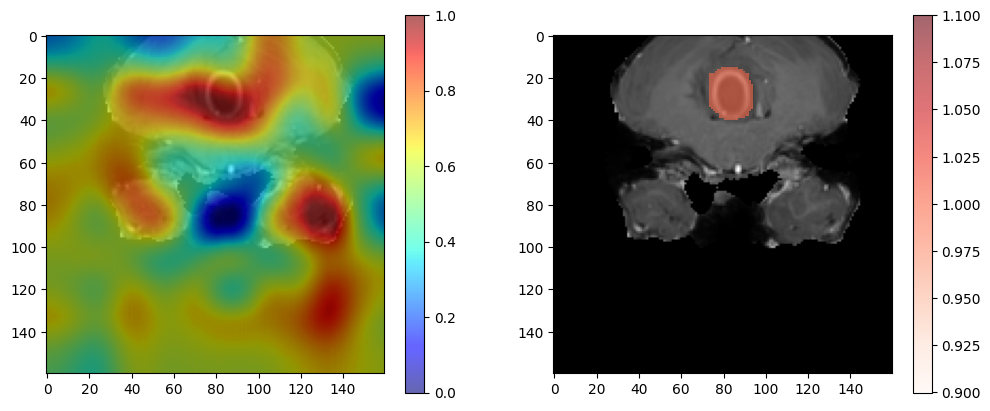

(2,)
16
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([0])
guided_gradients1 16999
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 0


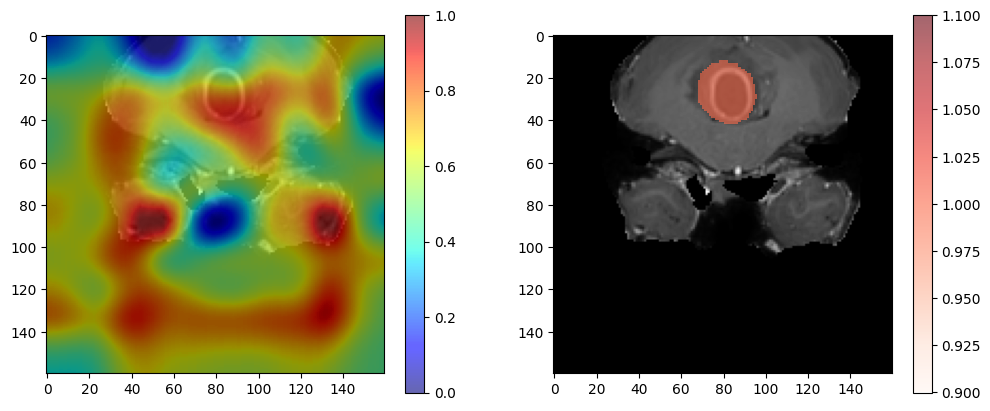

(2,)
17
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([0])
guided_gradients1 17003
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 0


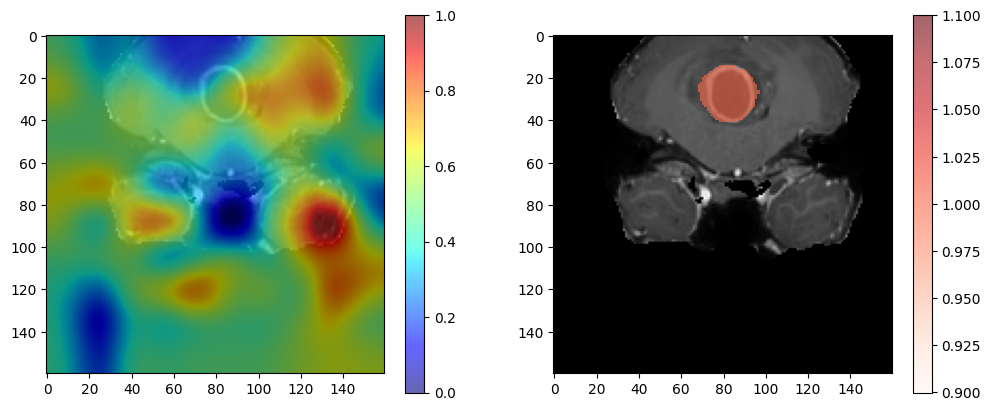

(2,)
18
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([0])
guided_gradients1 17007
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 0


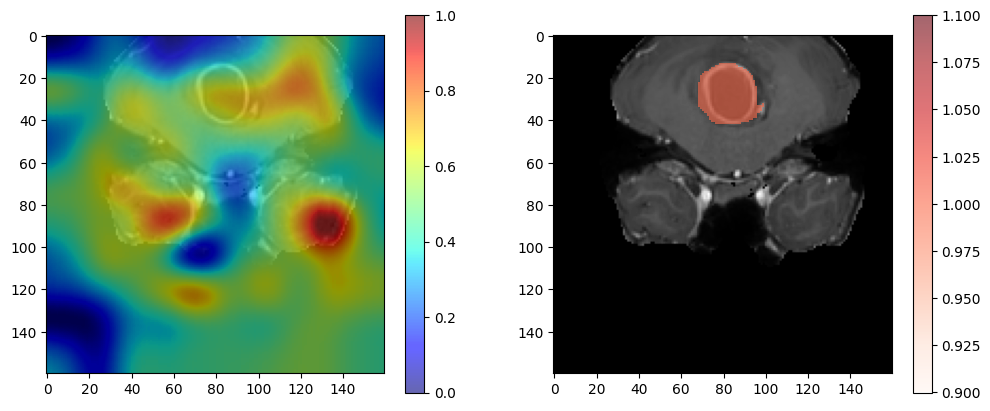

(2,)
19
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([0])
guided_gradients1 17011
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 0


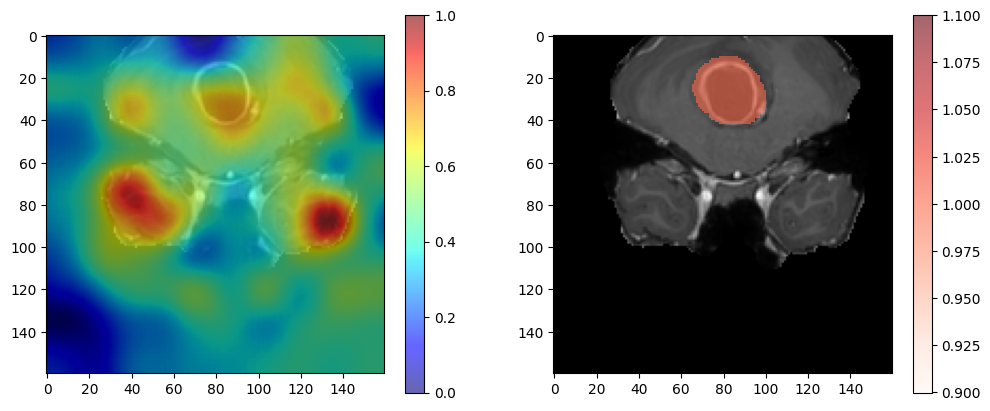

(2,)
20
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([0])
guided_gradients1 17015
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 0


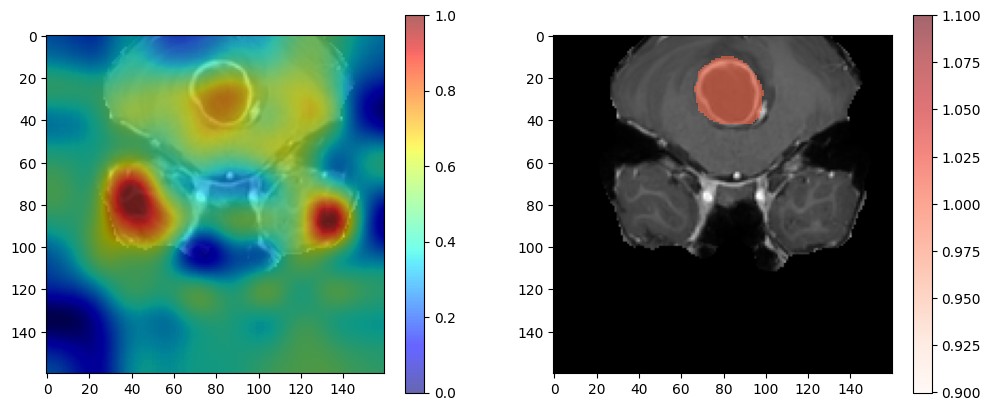

(2,)
21
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([0])
guided_gradients1 17019
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 0


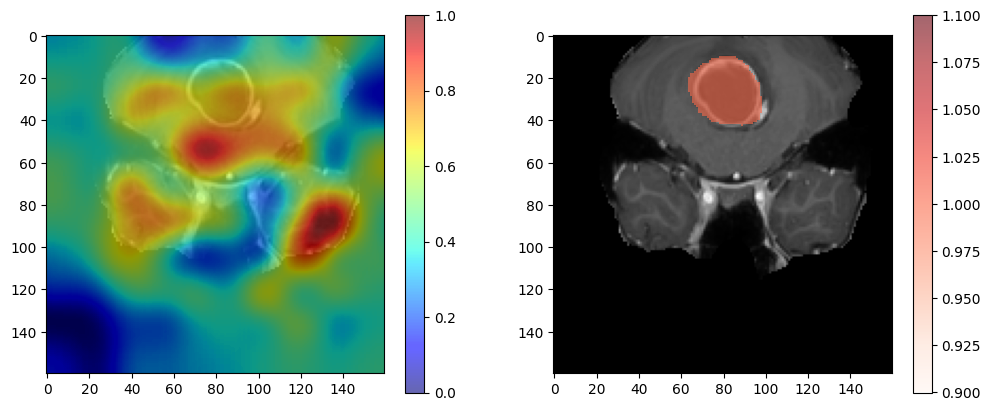

(2,)
22
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([0])
guided_gradients1 17023
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 0


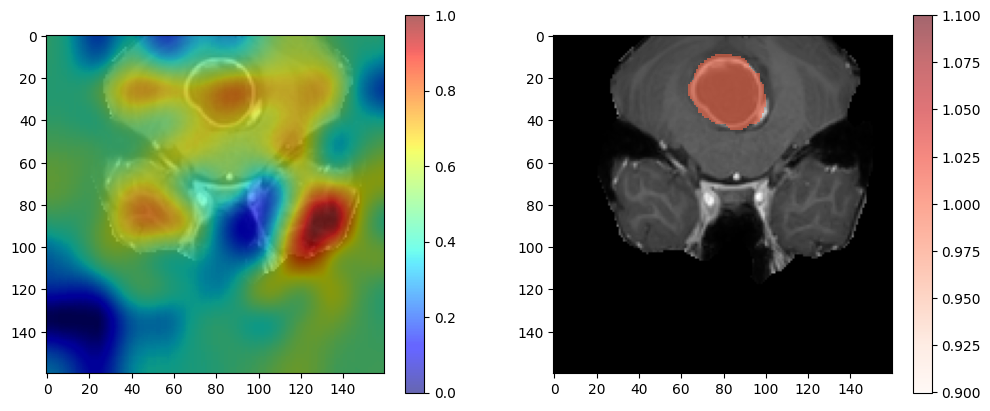

(2,)
23
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([0])
guided_gradients1 17027
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 0


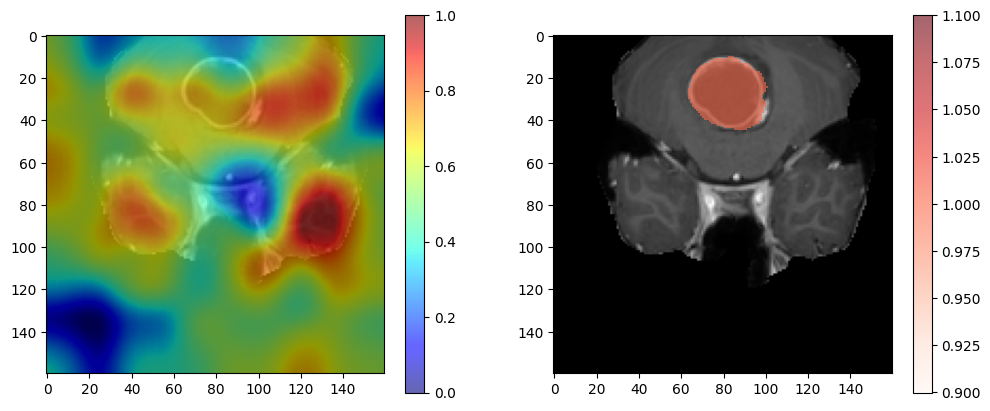

(2,)
24
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([0])
guided_gradients1 17031
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 0


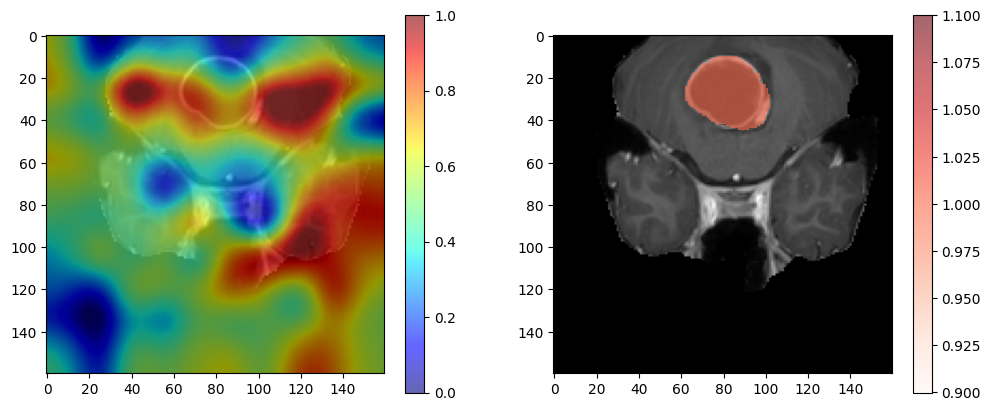

(2,)
25
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([0])
guided_gradients1 17035
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 0


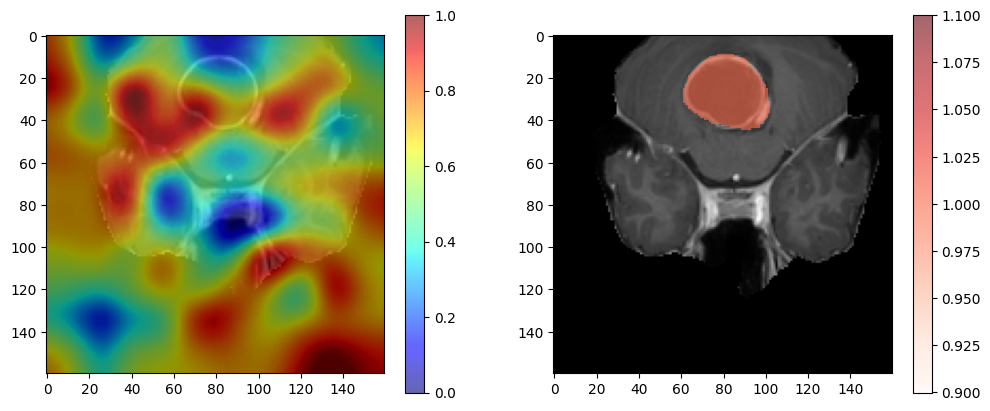

(2,)
26
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([0])
guided_gradients1 17039
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 0


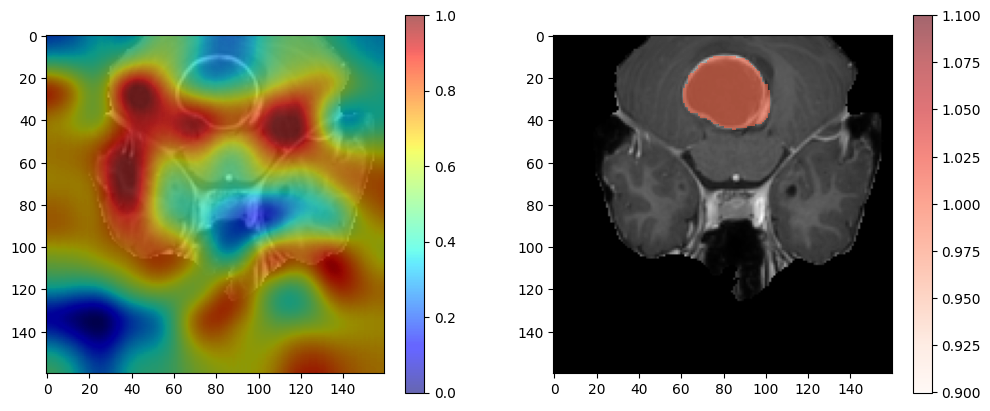

(2,)
27
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([0])
guided_gradients1 17043
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 0


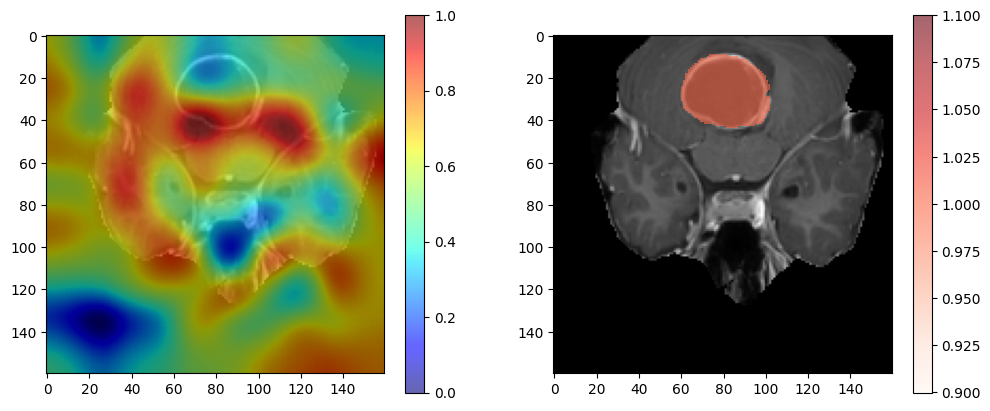

(2,)
28
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([0])
guided_gradients1 17047
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 0


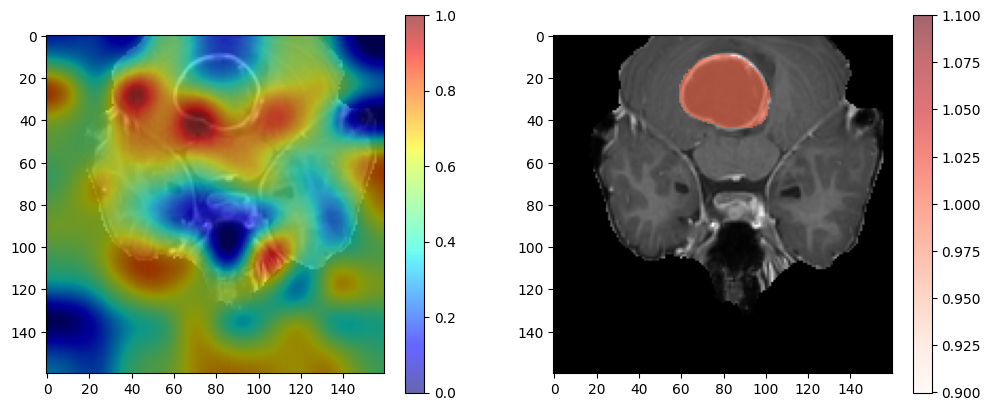

(2,)
29
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([0])
guided_gradients1 17051
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 0


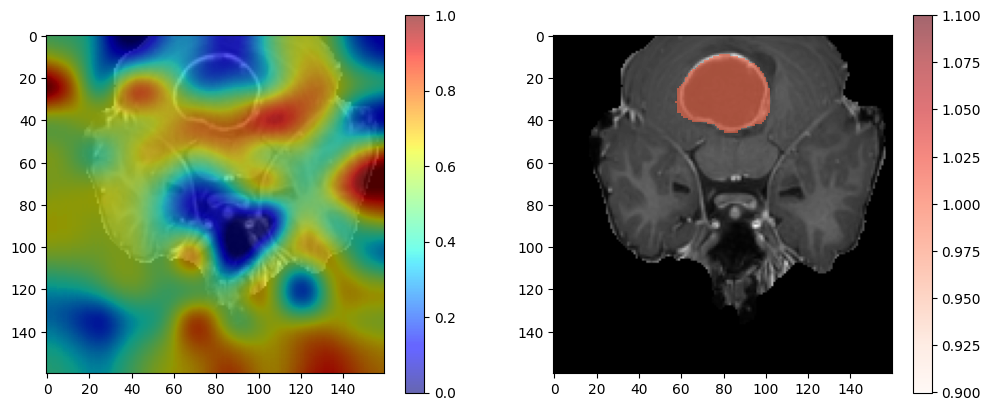

(2,)
30
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([0])
guided_gradients1 17055
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 0


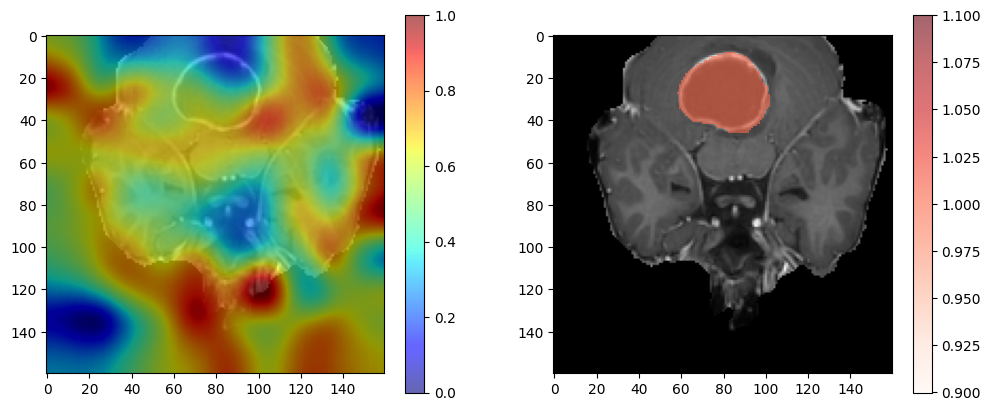

(2,)
31
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([0])
guided_gradients1 17059
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 0


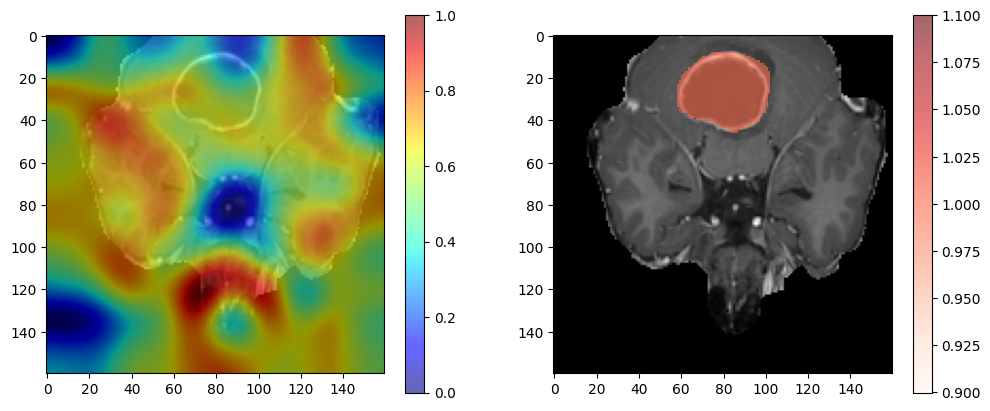

(2,)
32
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([0])
guided_gradients1 17063
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 0


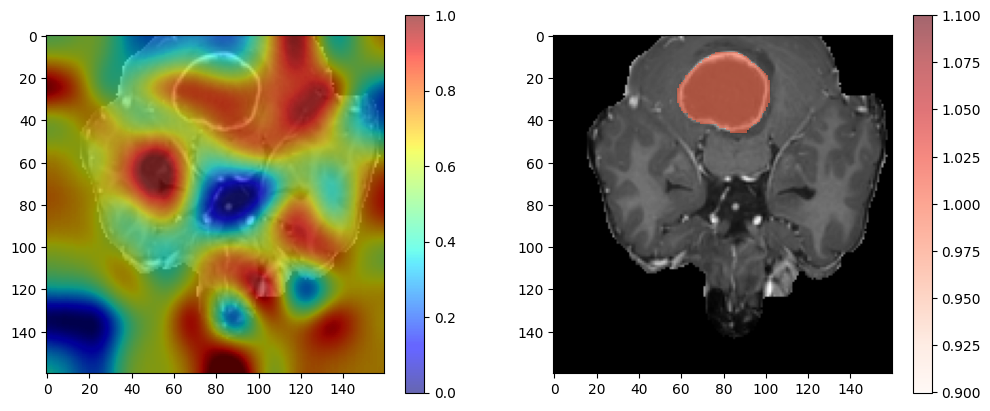

(2,)
33
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([0])
guided_gradients1 17067
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 0


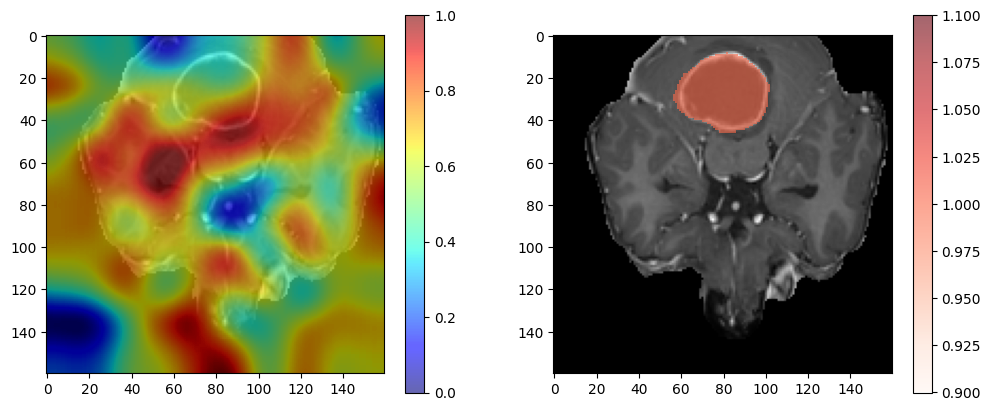

(2,)
34
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([0])
guided_gradients1 17071
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 0


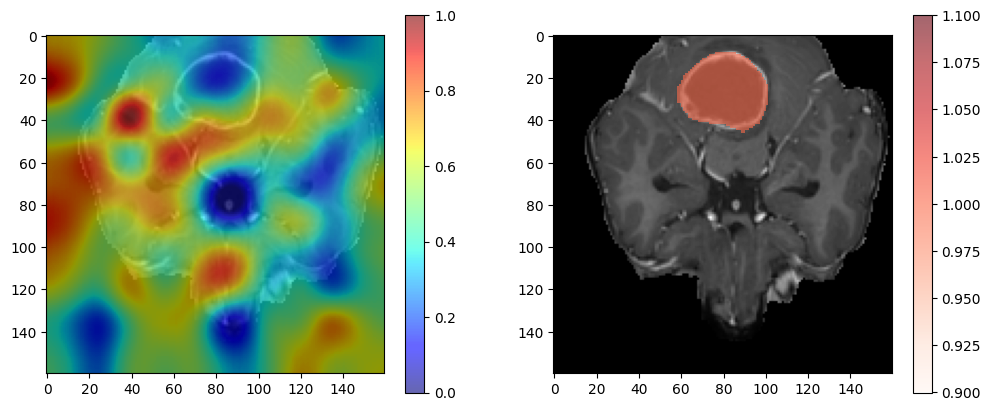

(2,)
35
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([0])
guided_gradients1 17075
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 0


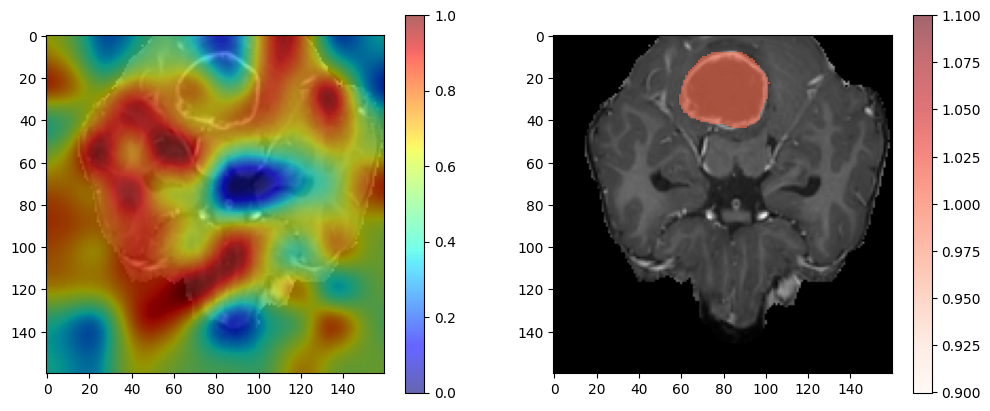

(2,)
36
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([0])
guided_gradients1 17079
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 0


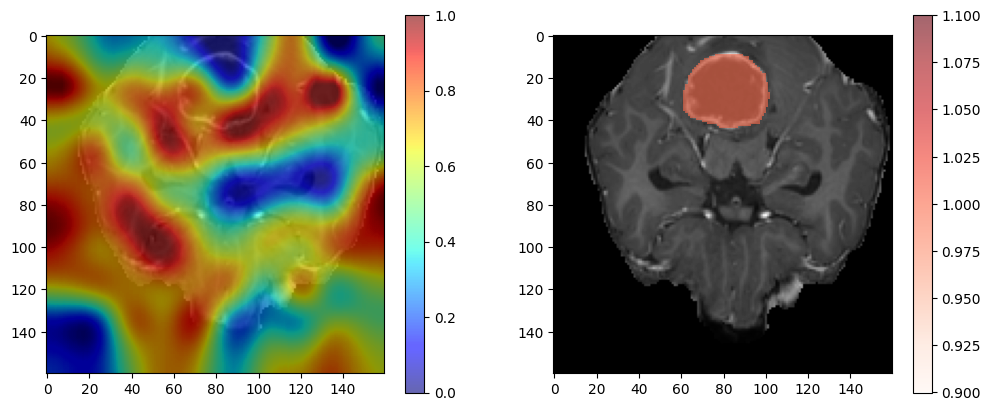

(2,)
37
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([0])
guided_gradients1 17083
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 0


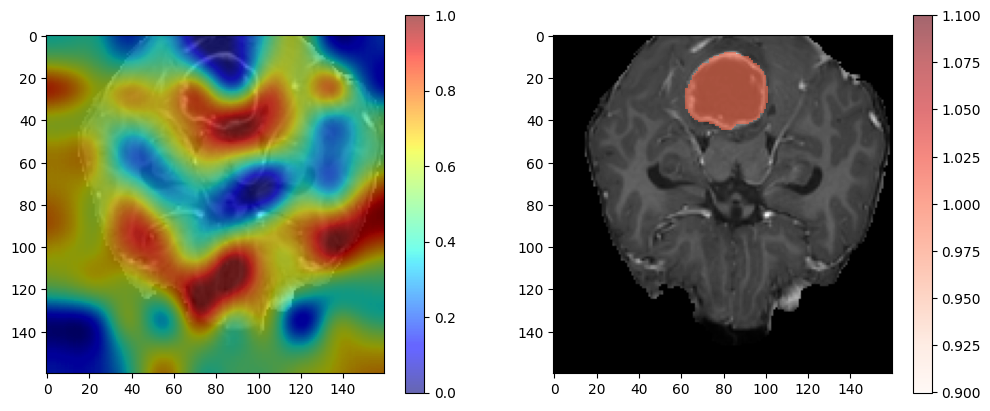

(2,)
38
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([0])
guided_gradients1 17087
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 0


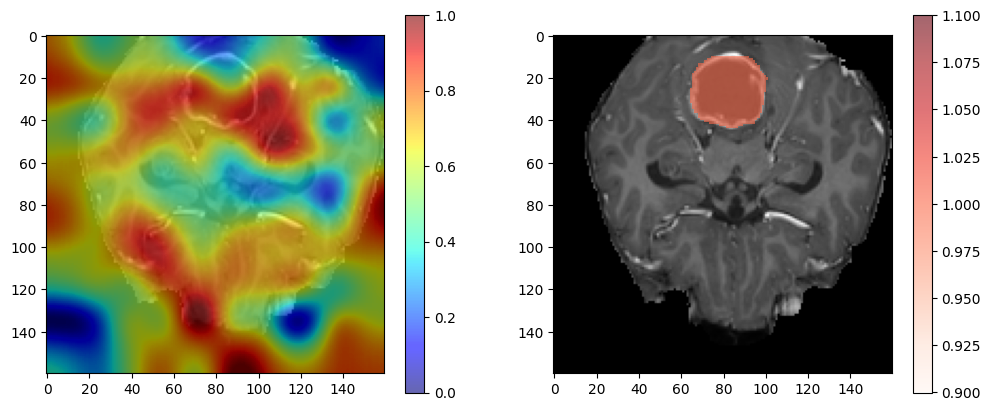

(2,)
39
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([0])
guided_gradients1 17091
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 0


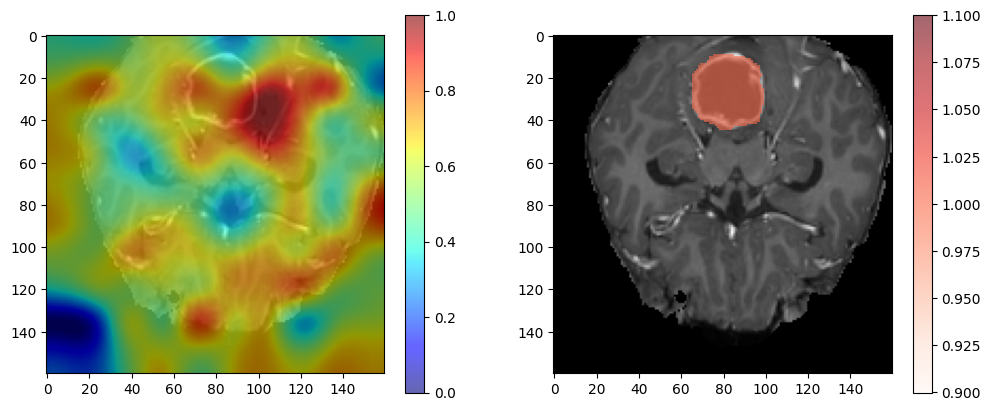

(2,)
40
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([0])
guided_gradients1 17095
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 0


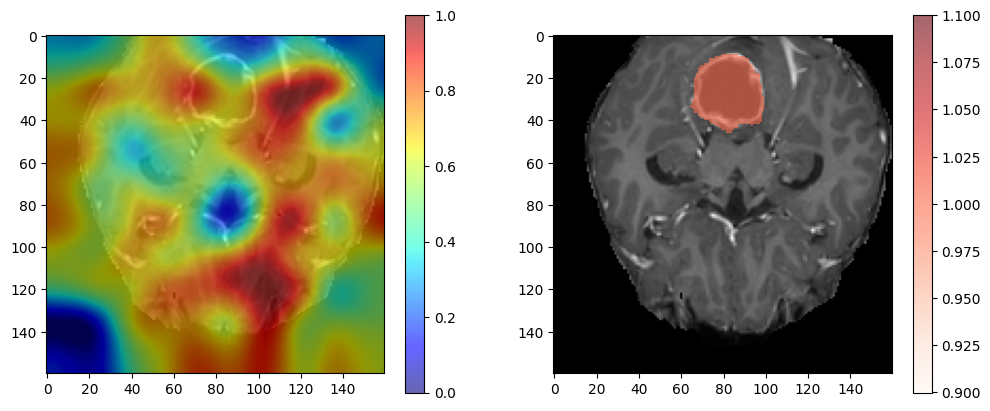

(2,)
41
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([0])
guided_gradients1 17099
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 0


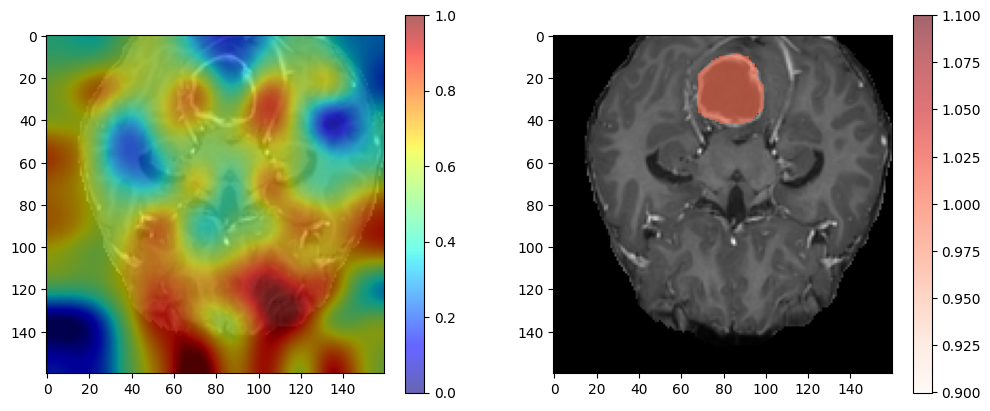

(2,)
42
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([0])
guided_gradients1 17103
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 0


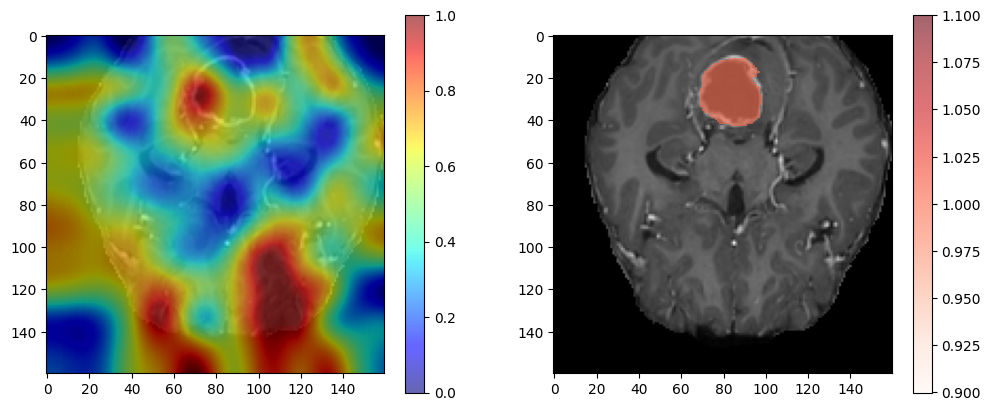

(2,)
43
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([0])
guided_gradients1 17107
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 0


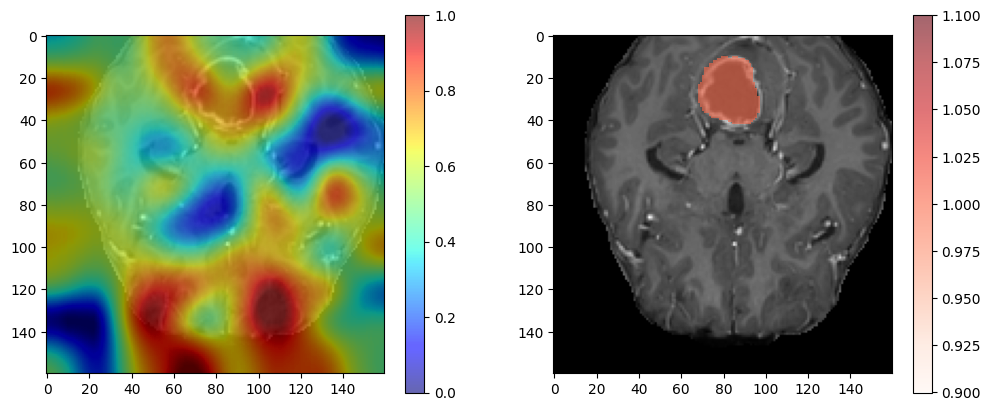

(2,)
44
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([0])
guided_gradients1 17111
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 0


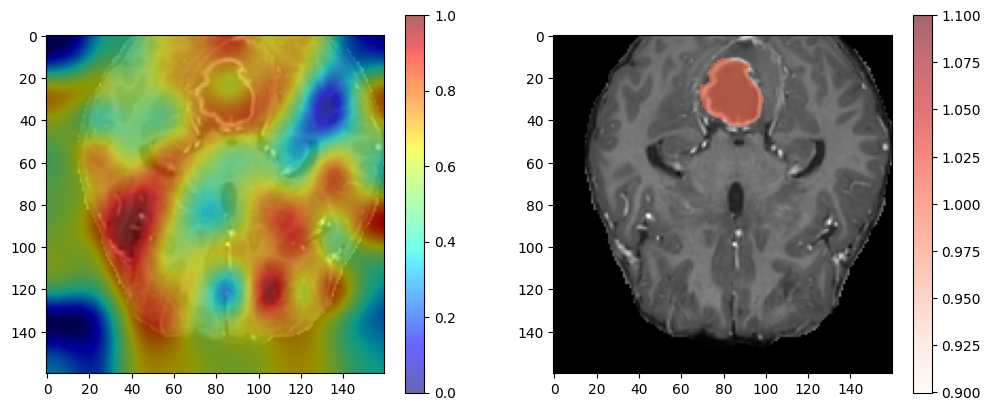

(2,)
45
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([0])
guided_gradients1 17115
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 0


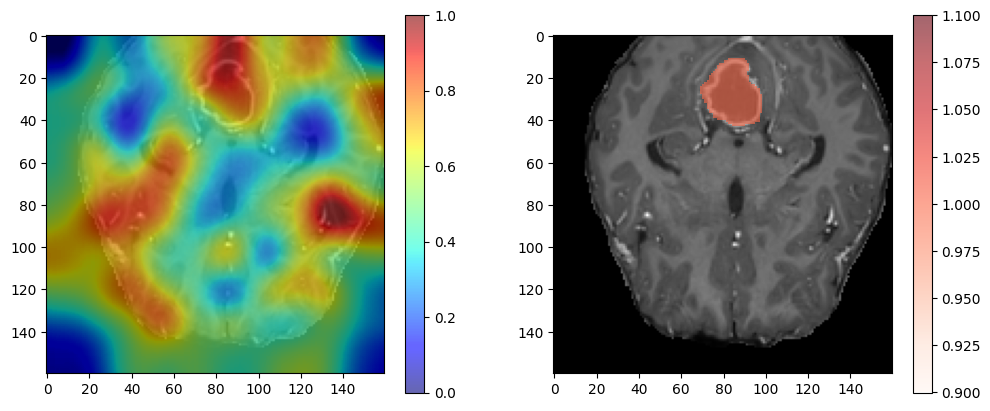

(2,)
46
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([0])
guided_gradients1 17119
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 0


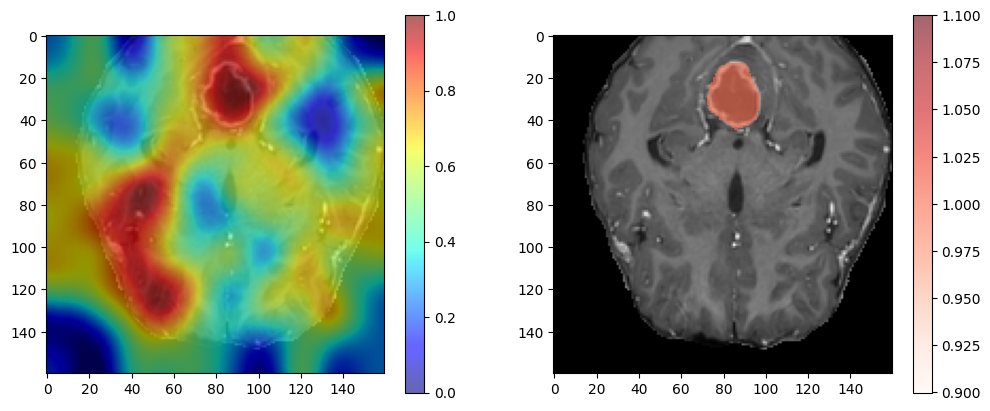

(2,)
47
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([0])
guided_gradients1 17123
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 0


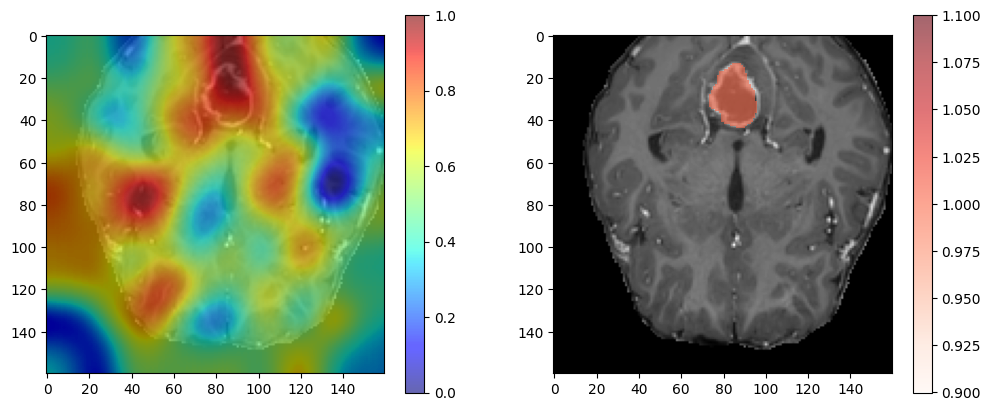

(2,)
48
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([0])
guided_gradients1 17127
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 0


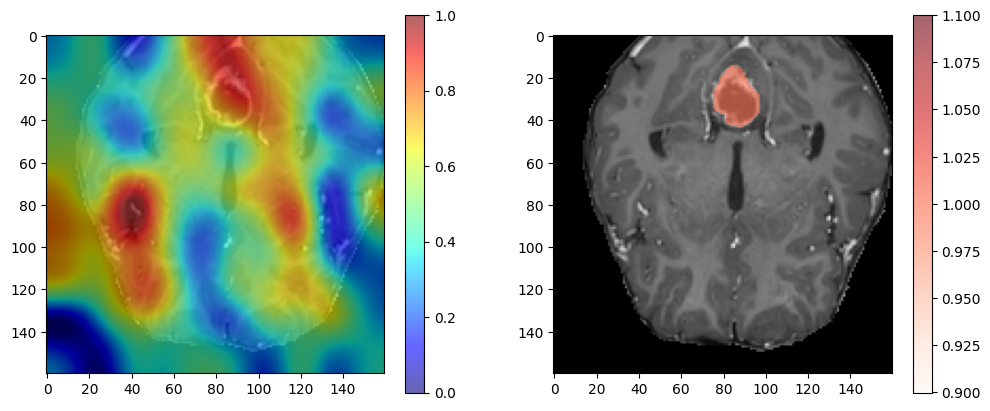

(2,)
49
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([0])
guided_gradients1 17131
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 0


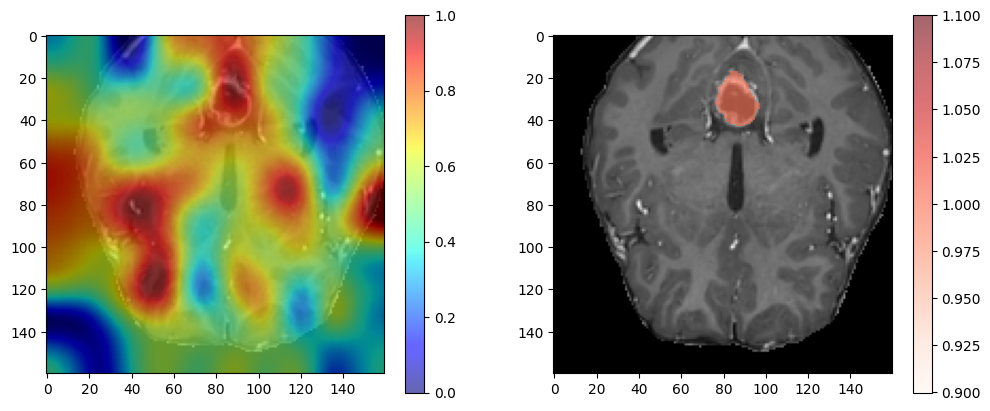

(2,)
50
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([0])
guided_gradients1 17135
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 0


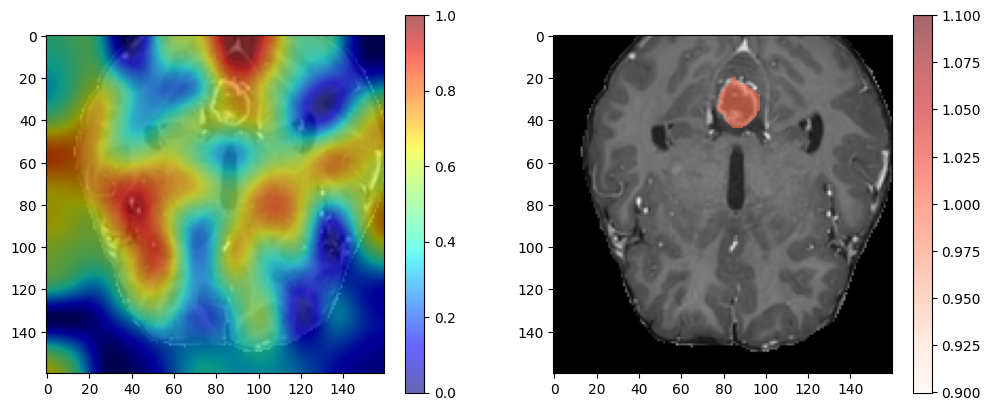

(2,)
51
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([0])
guided_gradients1 17139
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 0


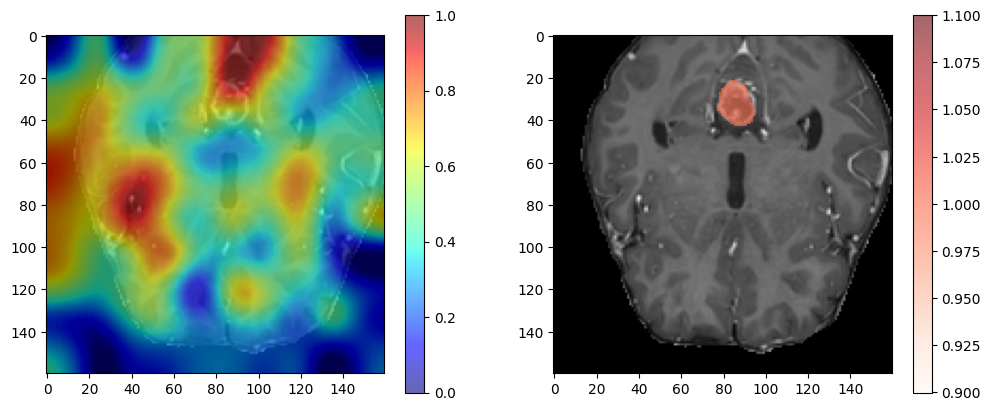

(2,)
52
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([0])
guided_gradients1 17143
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 0


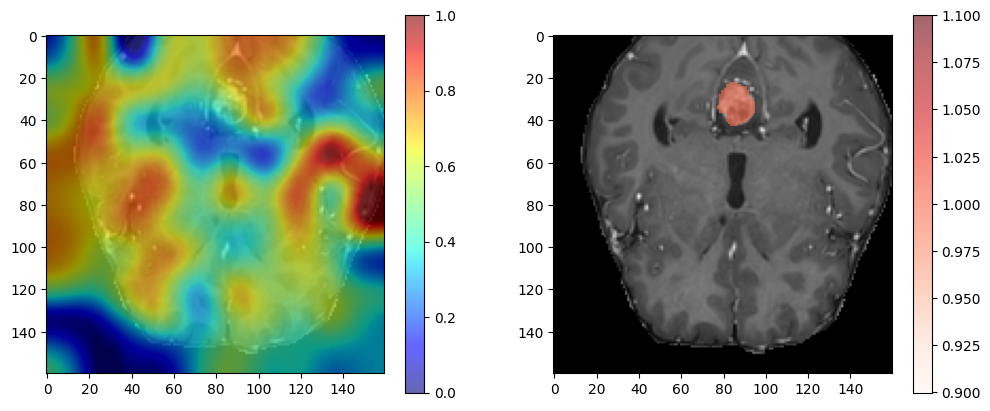

(2,)
53
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([0])
guided_gradients1 17147
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 0


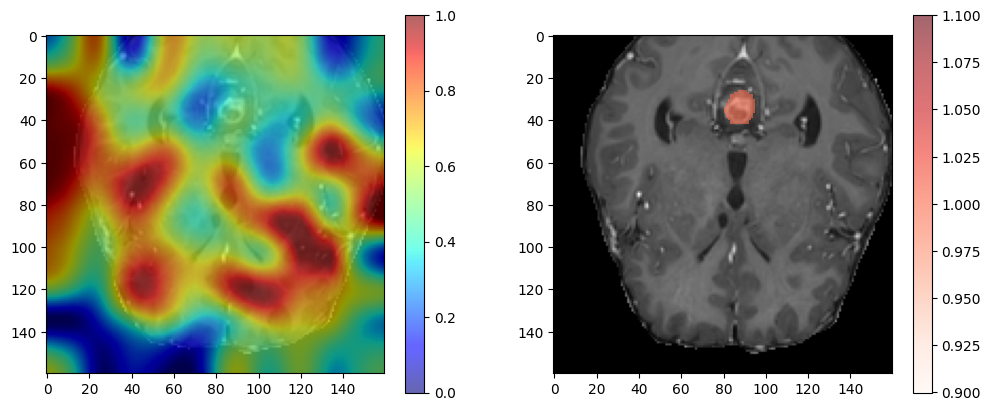

(2,)
54
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([0])
guided_gradients1 17151
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 0


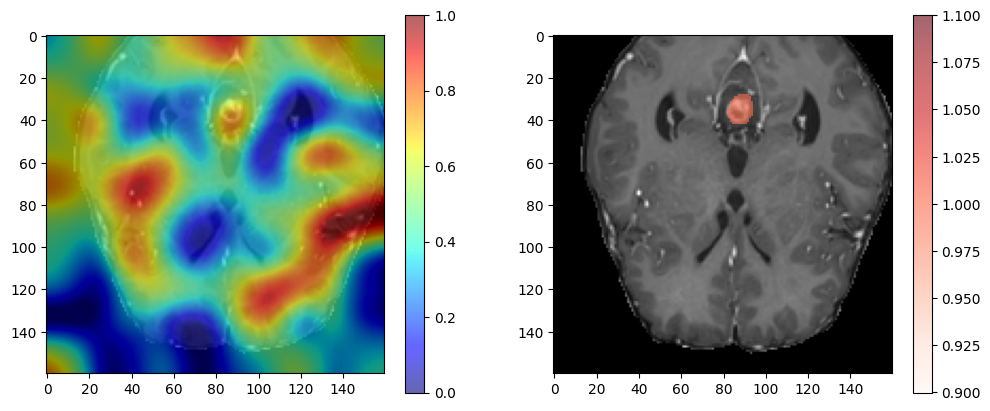

(2,)
55
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([0])
guided_gradients1 17155
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 0


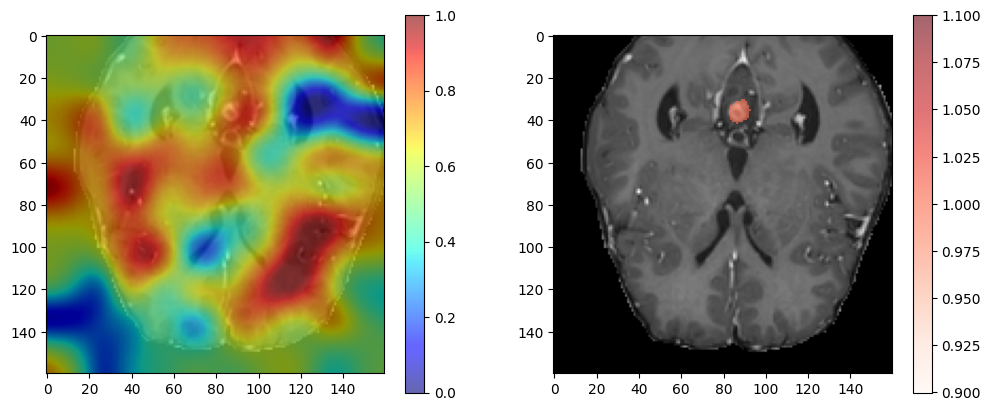

(2,)
56
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([0])
guided_gradients1 17159
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 0


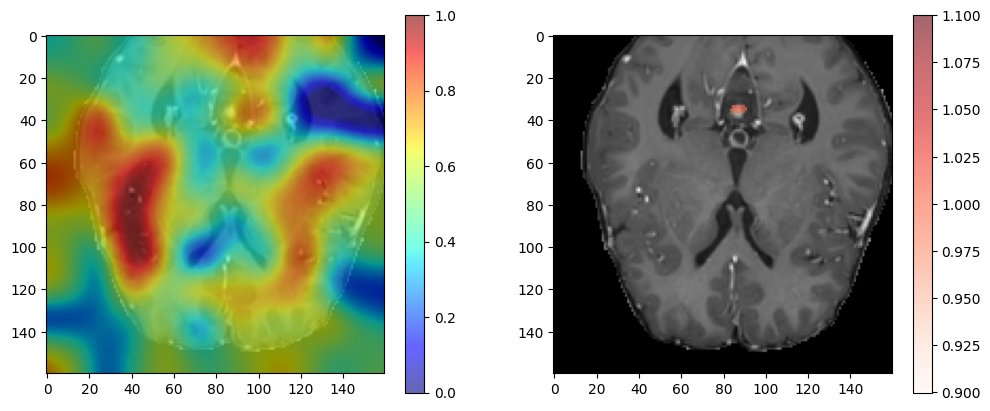

(2,)
57
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([1])
guided_gradients1 17163
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 1


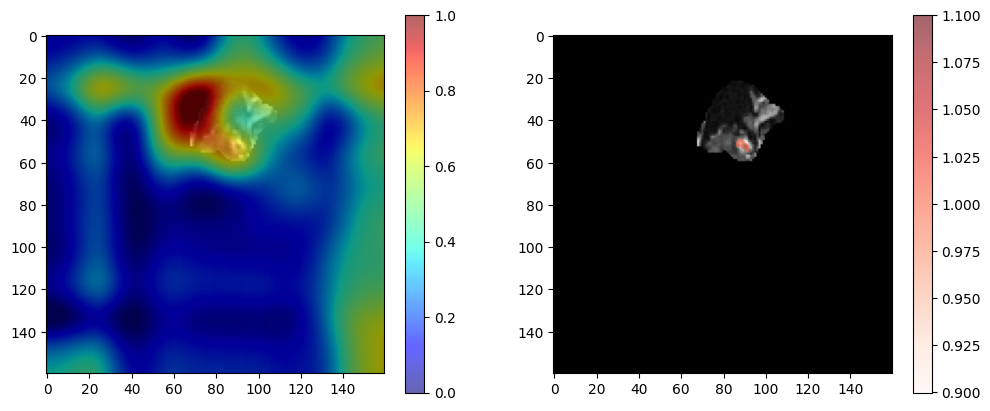

(2,)
58
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([1])
guided_gradients1 17167
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 1


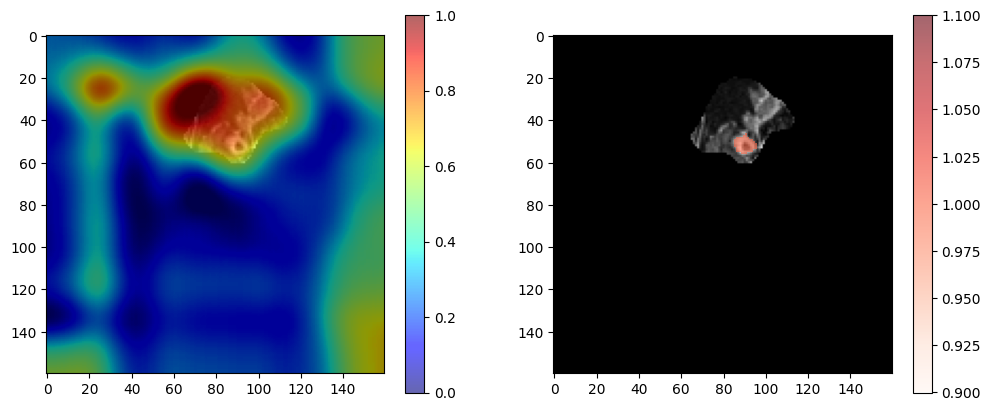

(2,)
59
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([1])
guided_gradients1 17171
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 1


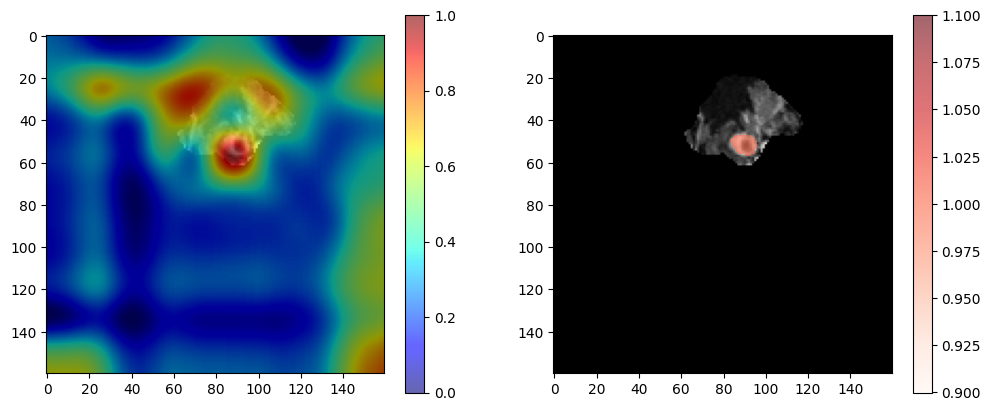

(2,)
60
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([1])
guided_gradients1 17175
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 1


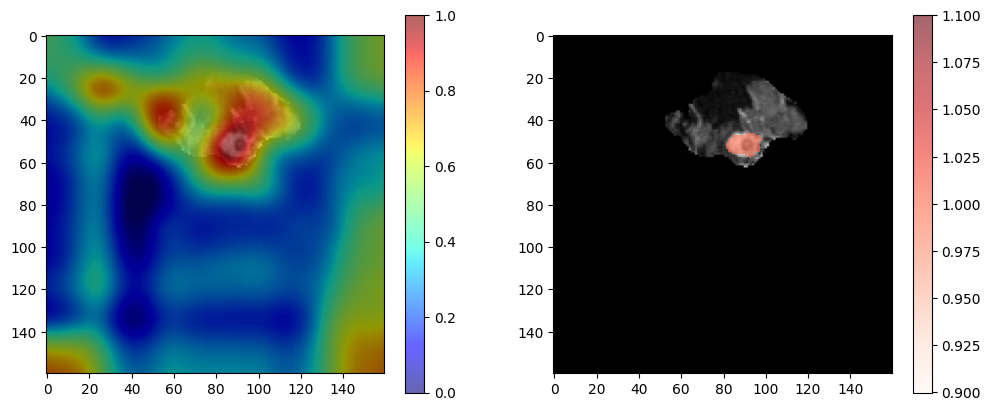

(2,)
61
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([1])
guided_gradients1 17179
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 1


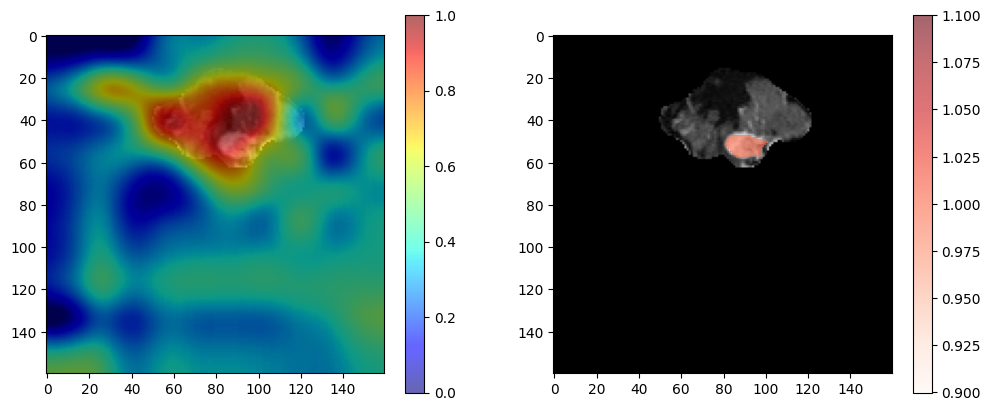

(2,)
62
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([1])
guided_gradients1 17183
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 1


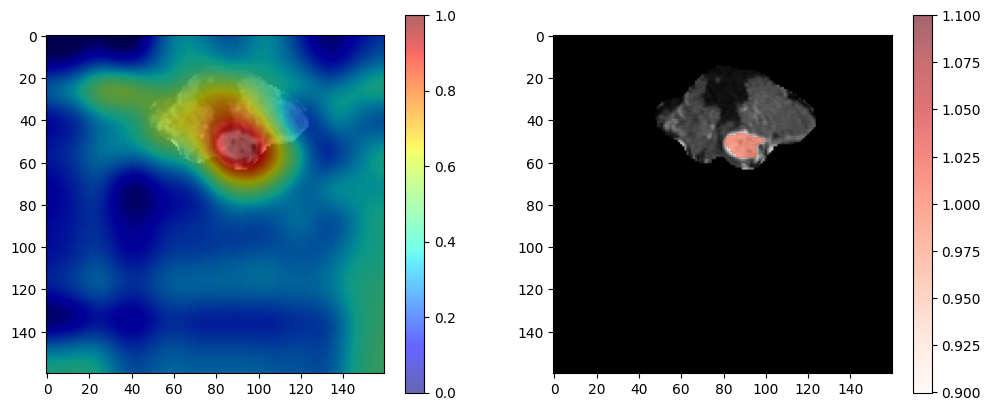

(2,)
63
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([1])
guided_gradients1 17187
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 1


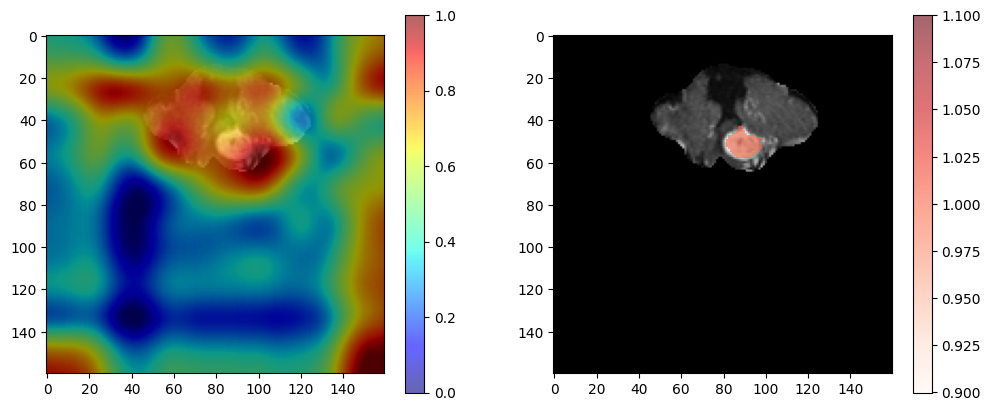

(2,)
64
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([1])
guided_gradients1 17191
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 1


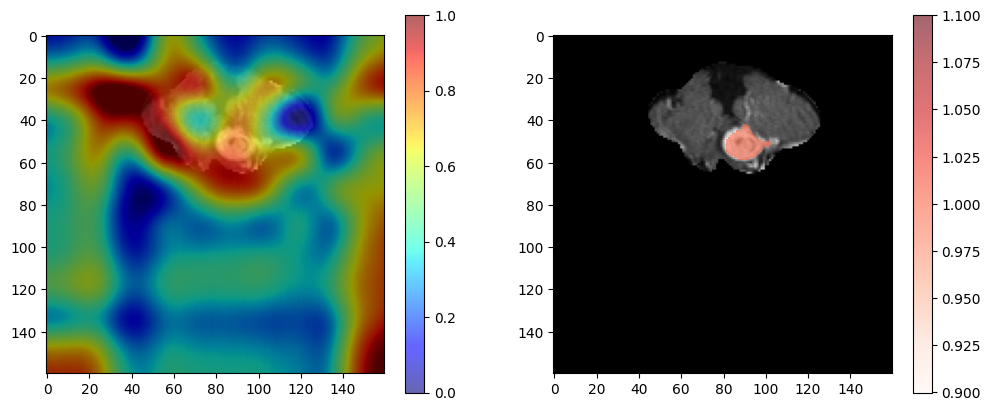

(2,)
65
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([1])
guided_gradients1 17195
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 1


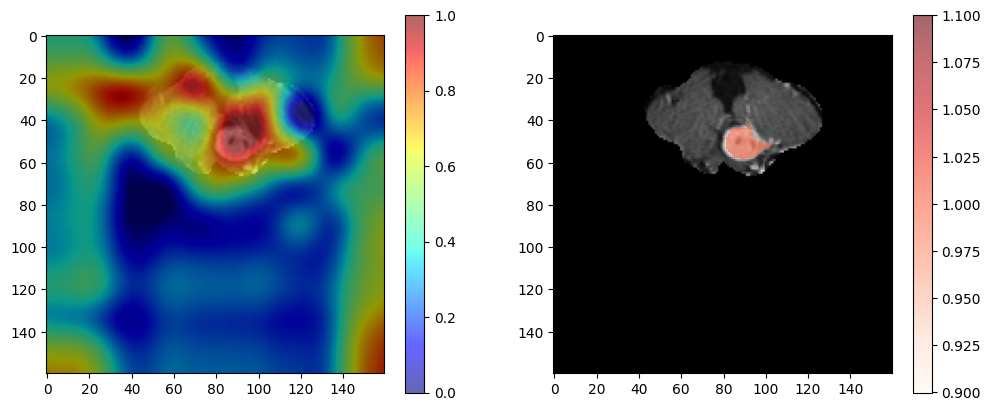

(2,)
66
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([1])
guided_gradients1 17199
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 1


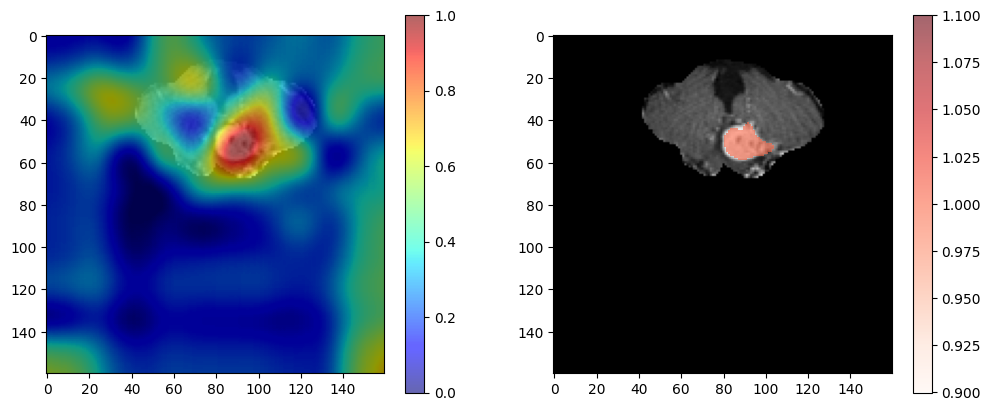

(2,)
67
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([1])
guided_gradients1 17203
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 1


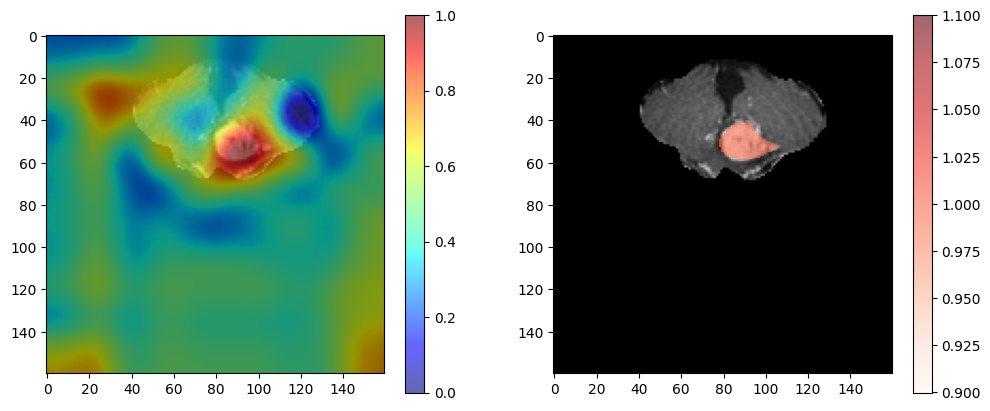

(2,)
68
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([1])
guided_gradients1 17207
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 1


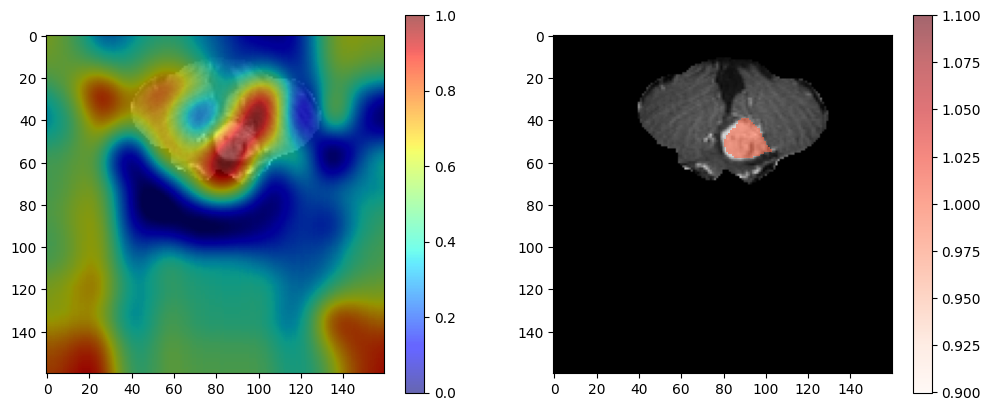

(2,)
69
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([1])
guided_gradients1 17211
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 1


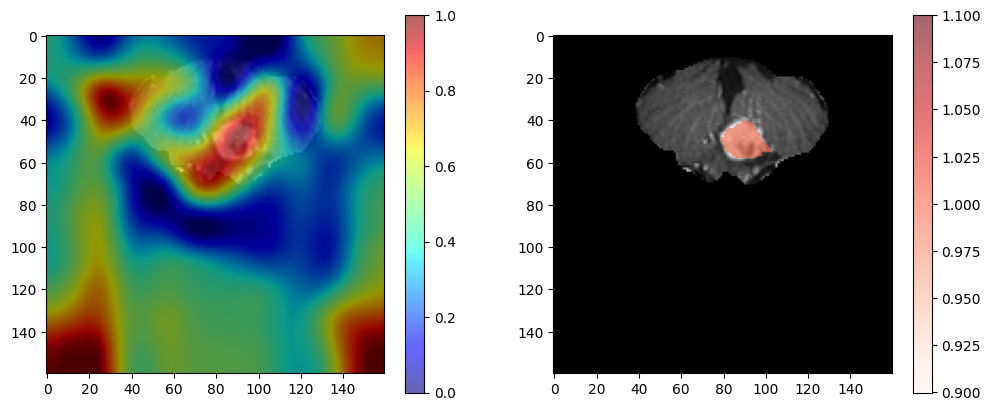

(2,)
70
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([1])
guided_gradients1 17215
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 1


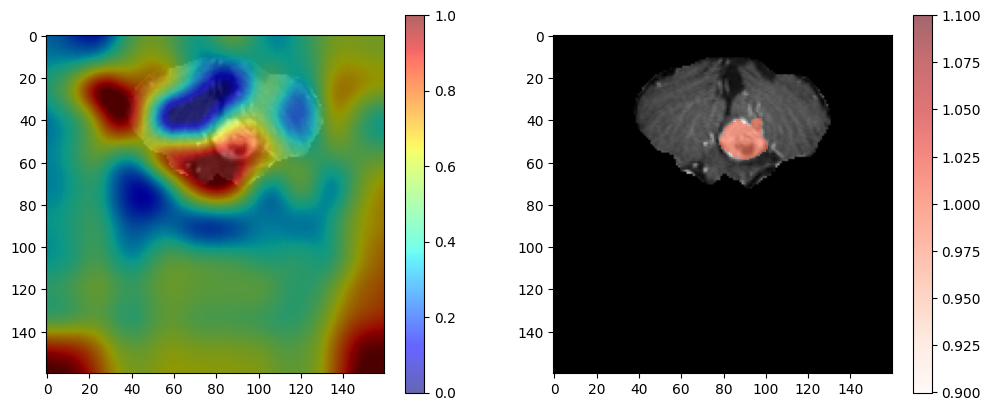

(2,)
71
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([1])
guided_gradients1 17219
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 1


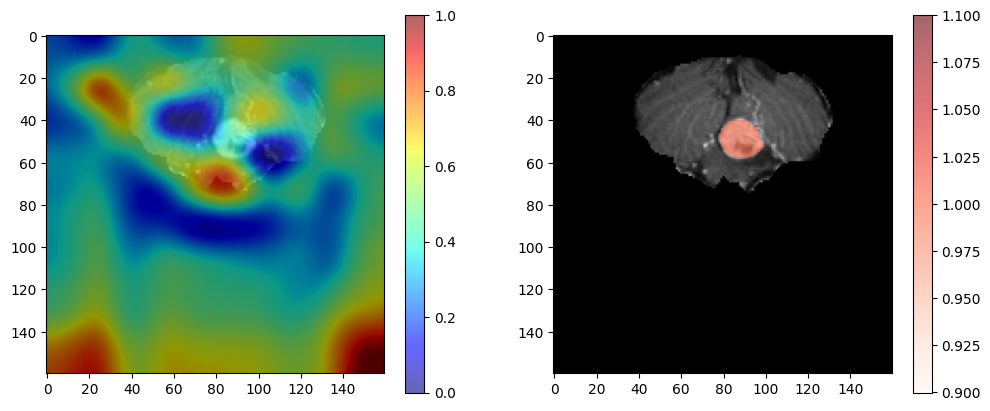

(2,)
72
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([1])
guided_gradients1 17223
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 1


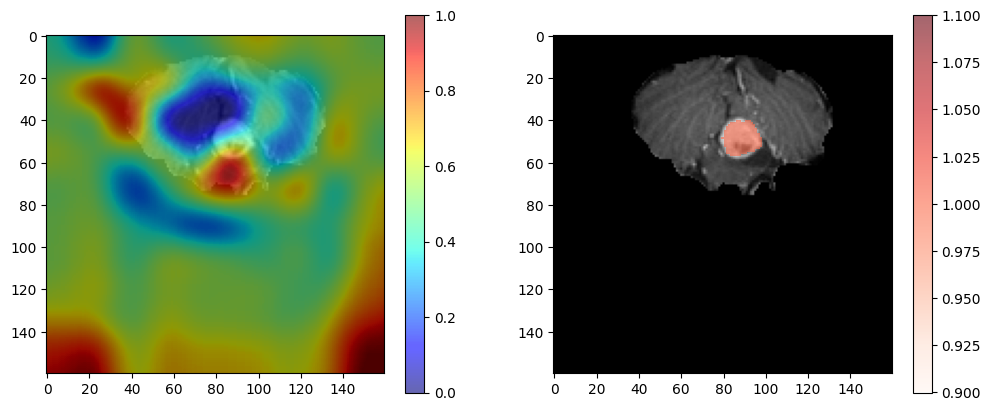

(2,)
73
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([1])
guided_gradients1 17227
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 1


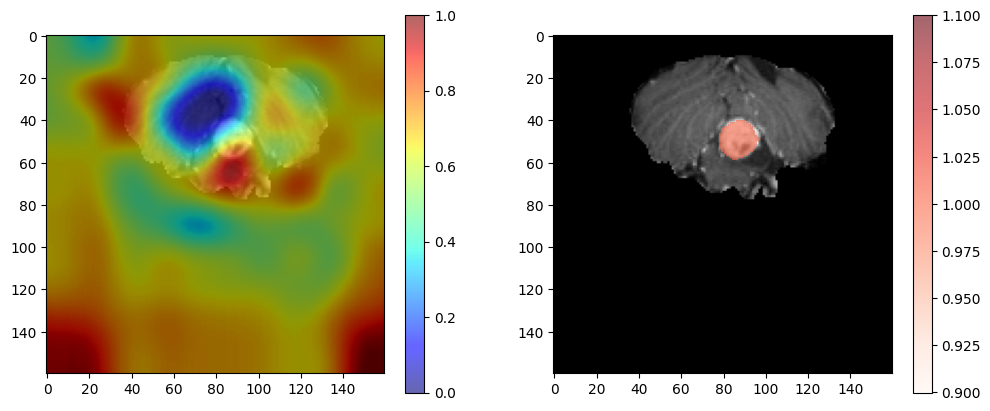

(2,)
74
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([1])
guided_gradients1 17231
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 1


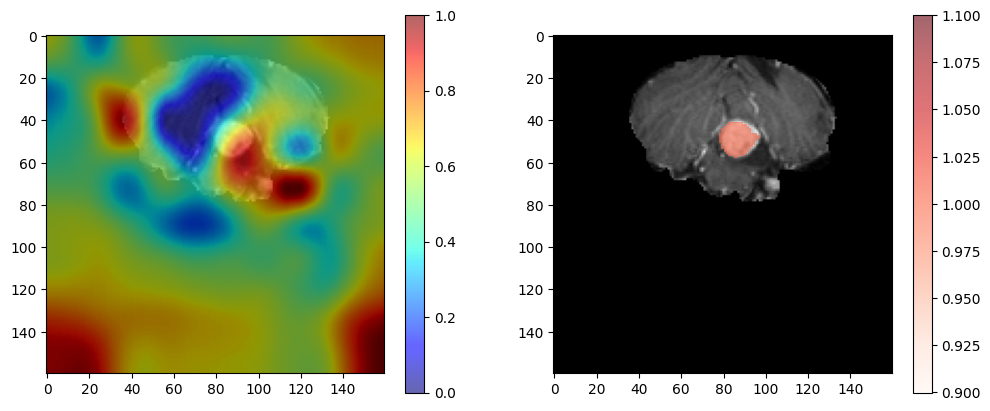

(2,)
75
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([1])
guided_gradients1 17235
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 1


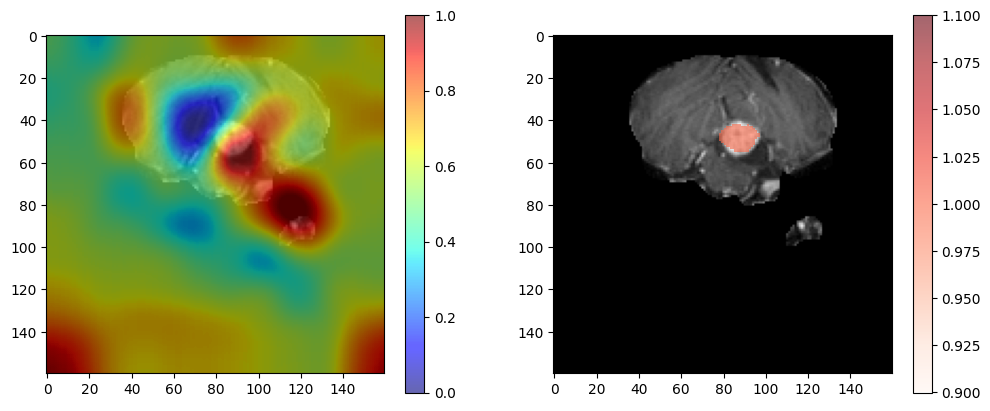

(2,)
76
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([1])
guided_gradients1 17239
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 1


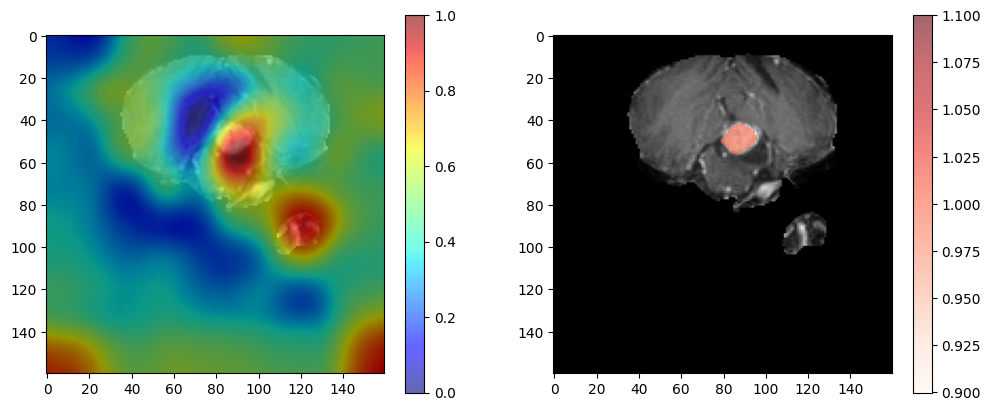

(2,)
77
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([1])
guided_gradients1 17243
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 1


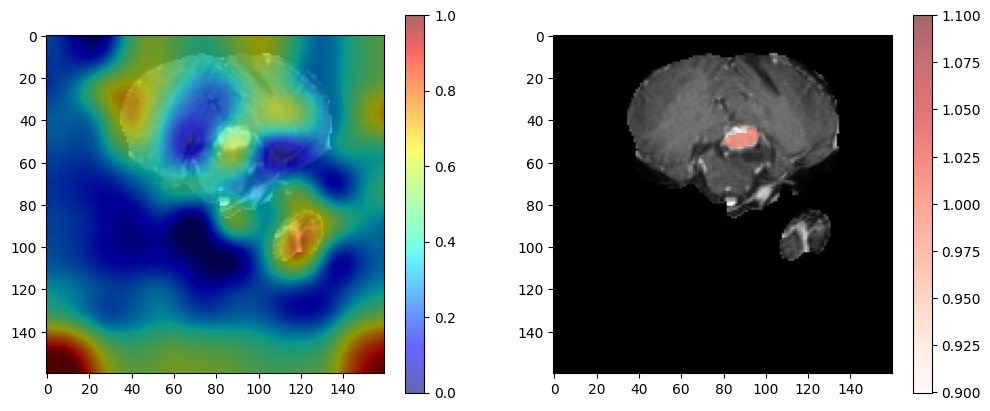

(2,)
78
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([1])
guided_gradients1 17247
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 1


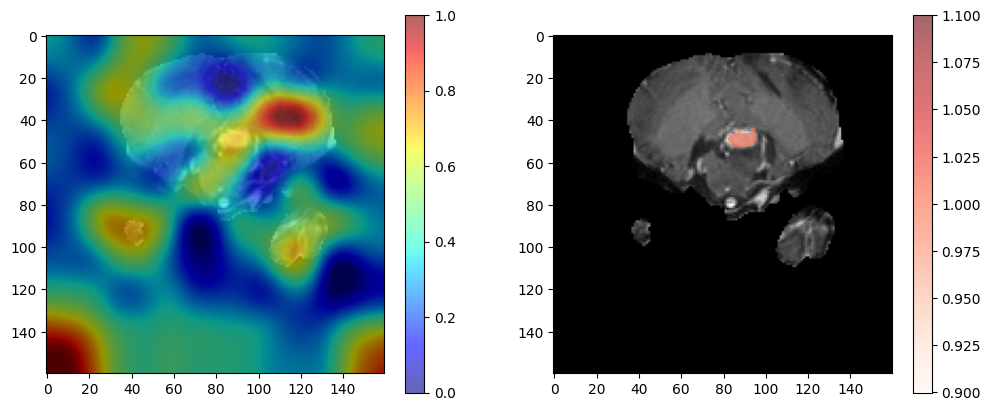

(2,)
79
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([1])
guided_gradients1 17251
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 1


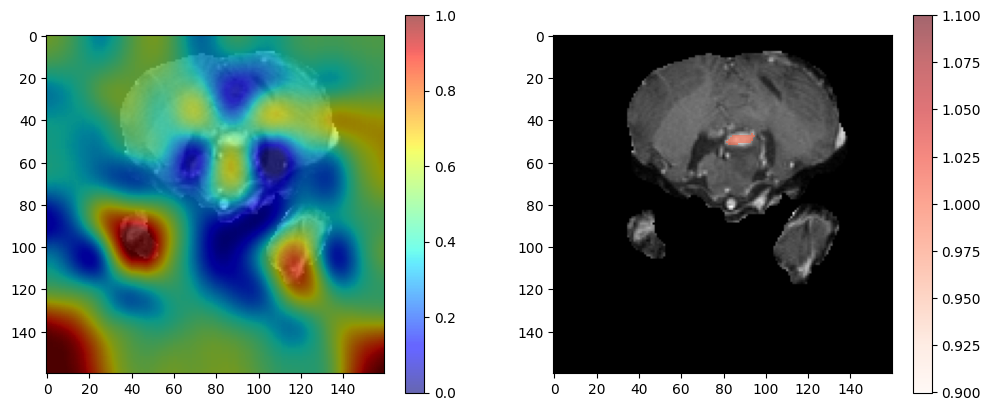

(2,)
80
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([1])
guided_gradients1 17255
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 1


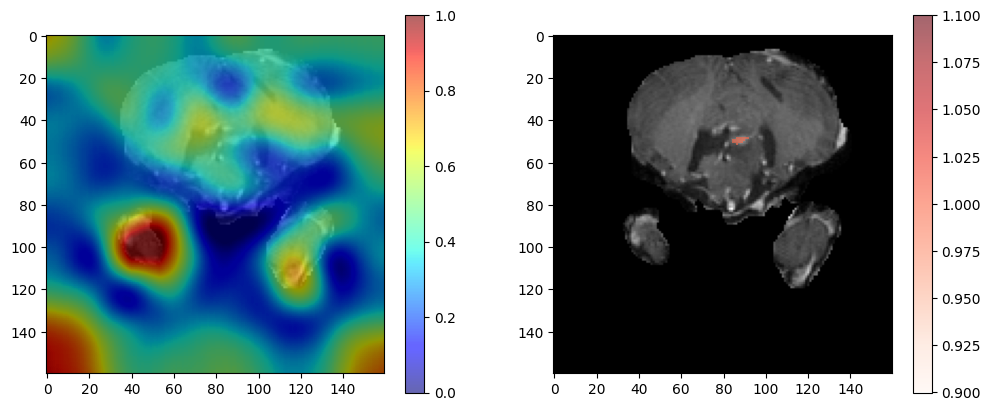

(2,)
81
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([0])
guided_gradients1 17259
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 0


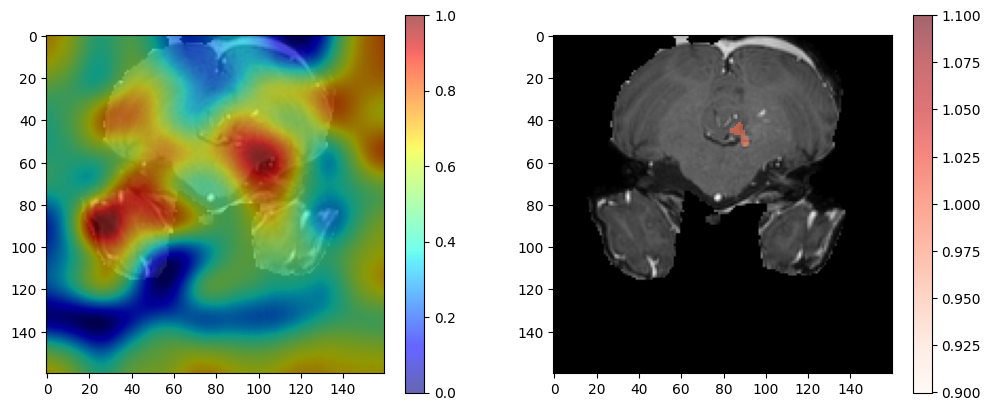

(2,)
82
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([0])
guided_gradients1 17263
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 0


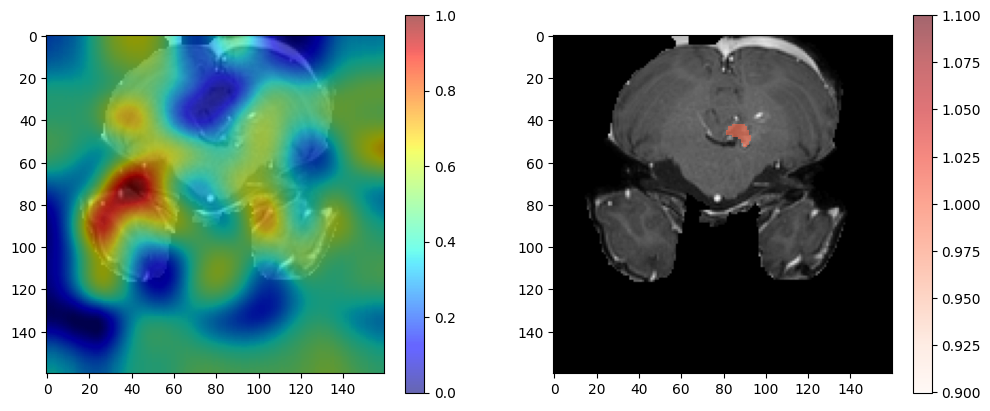

(2,)
83
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([0])
guided_gradients1 17267
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 0


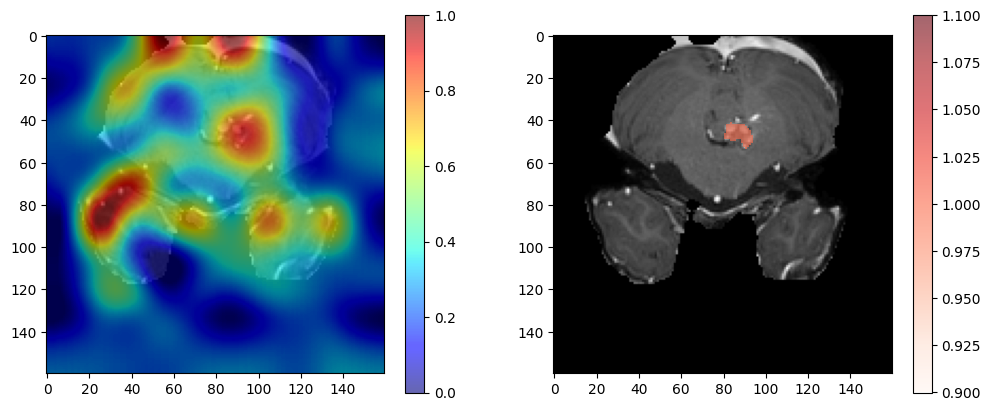

(2,)
84
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([0])
guided_gradients1 17271
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 0


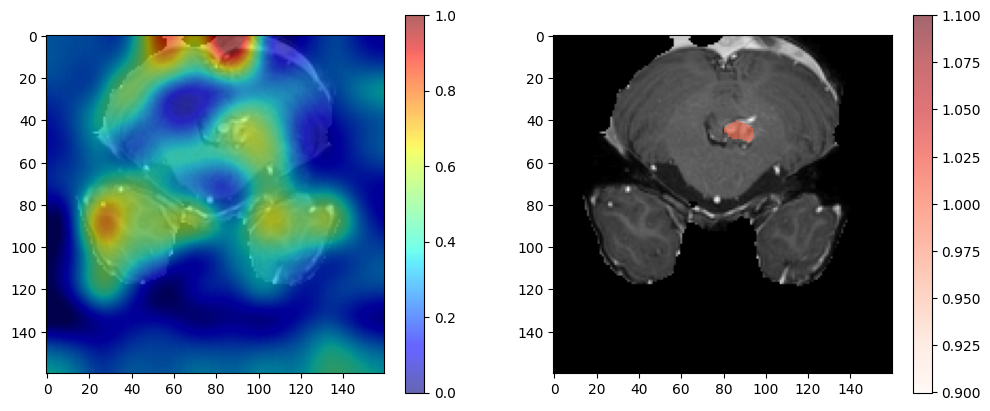

(2,)
85
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([0])
guided_gradients1 17275
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 0


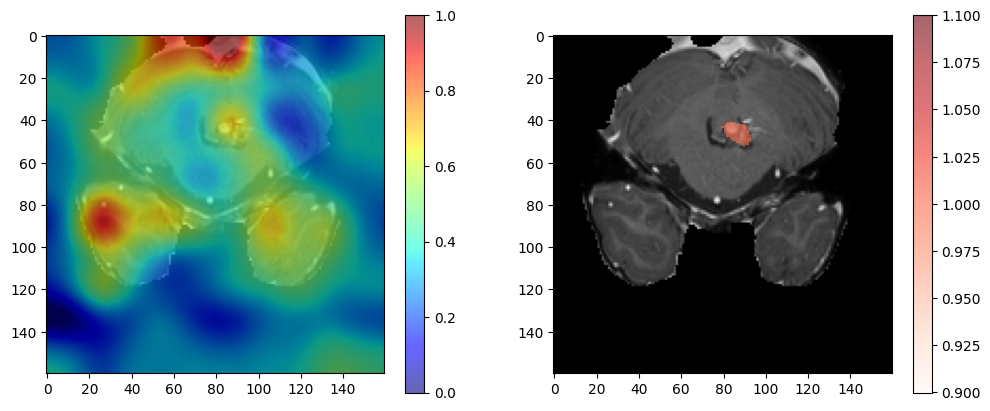

(2,)
86
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([0])
guided_gradients1 17279
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 0


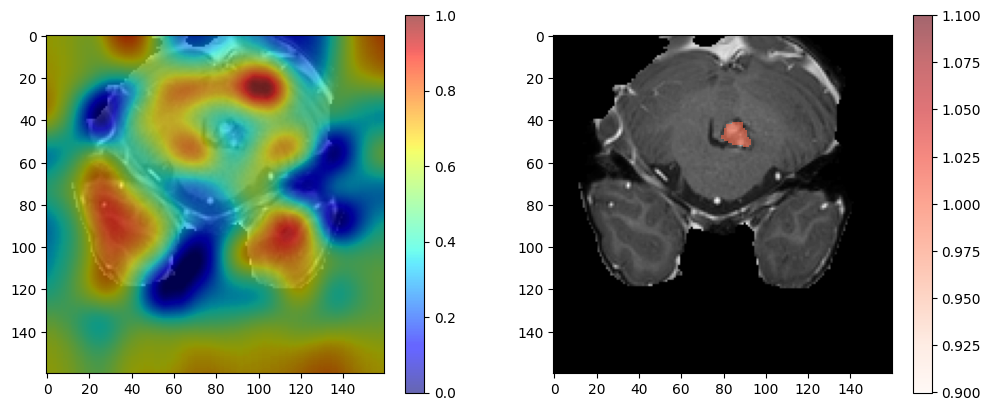

(2,)
87
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([0])
guided_gradients1 17283
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 0


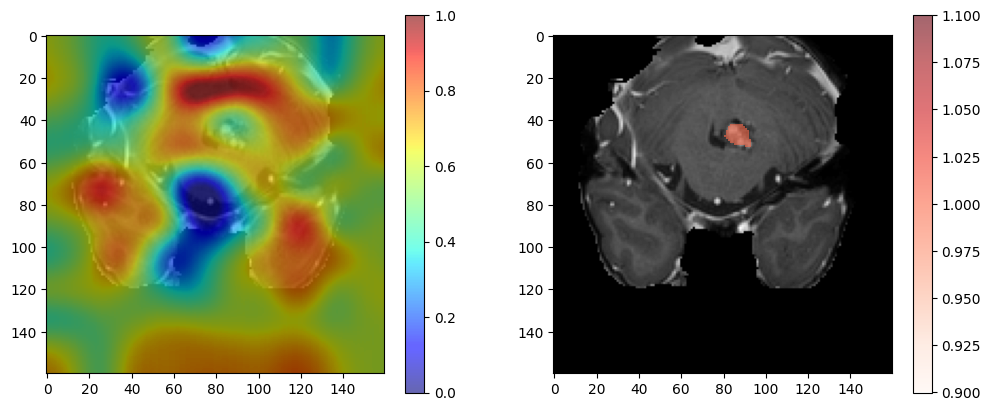

(2,)
88
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([0])
guided_gradients1 17287
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 0


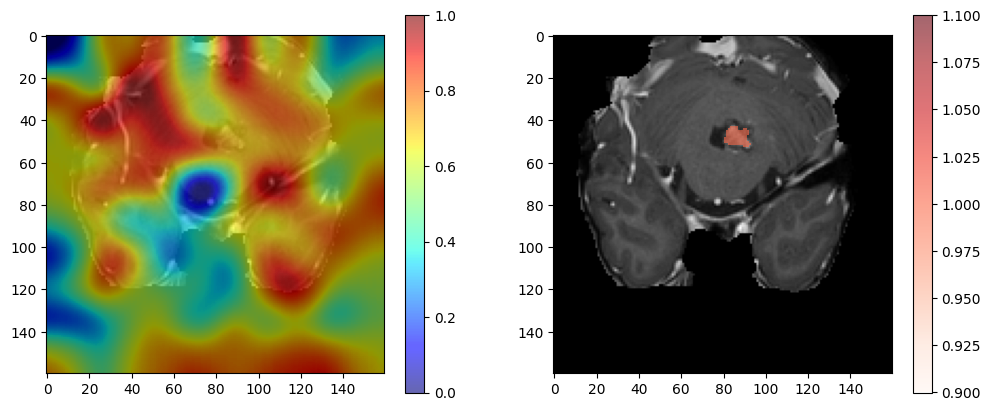

(2,)
89
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([0])
guided_gradients1 17291
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 0


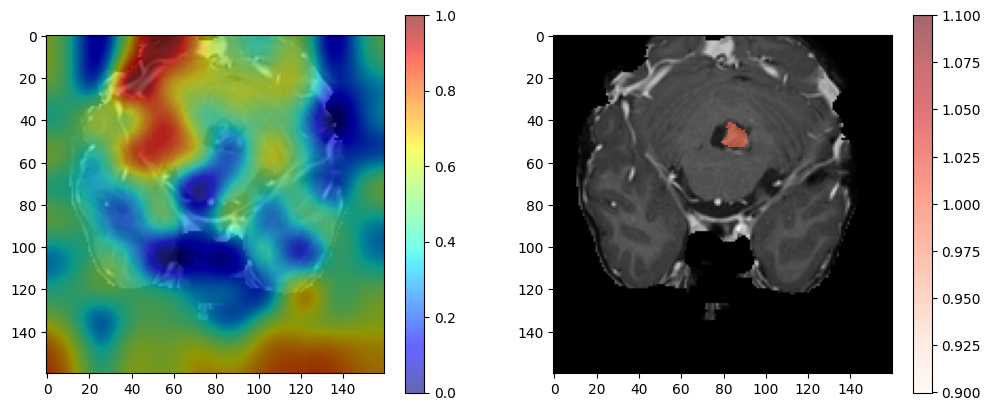

(2,)
90
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([0])
guided_gradients1 17295
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 0


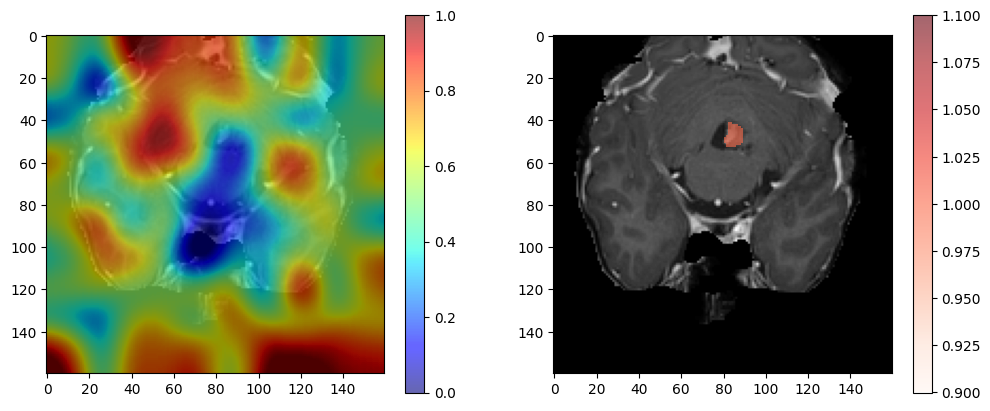

(2,)
91
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([0])
guided_gradients1 17299
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 0


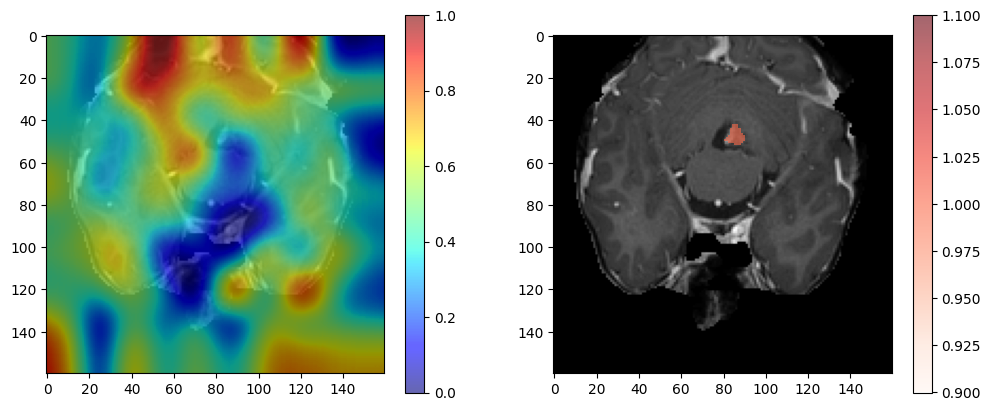

(2,)
92
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([0])
guided_gradients1 17303
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 0


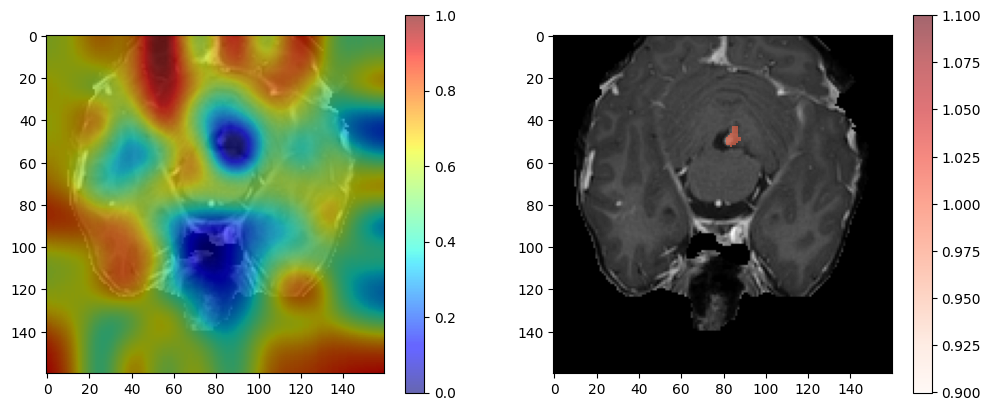

(2,)
93
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([0])
guided_gradients1 17307
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 0


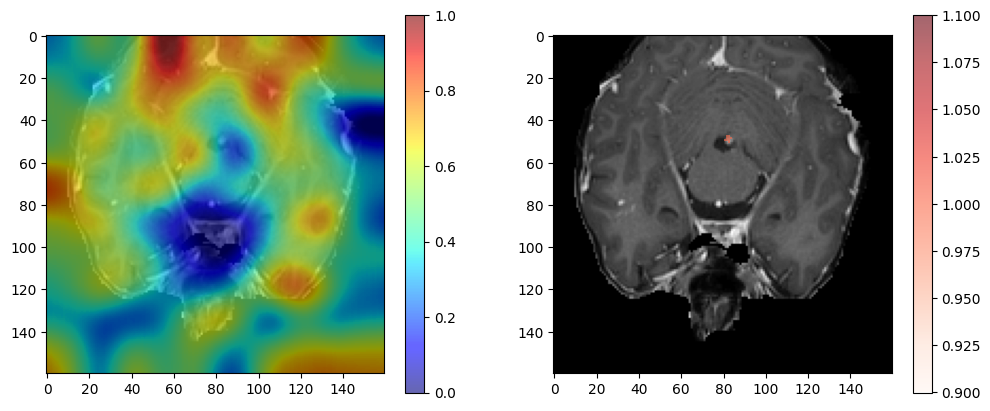

(2,)
94
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([0])
guided_gradients1 17311
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 0


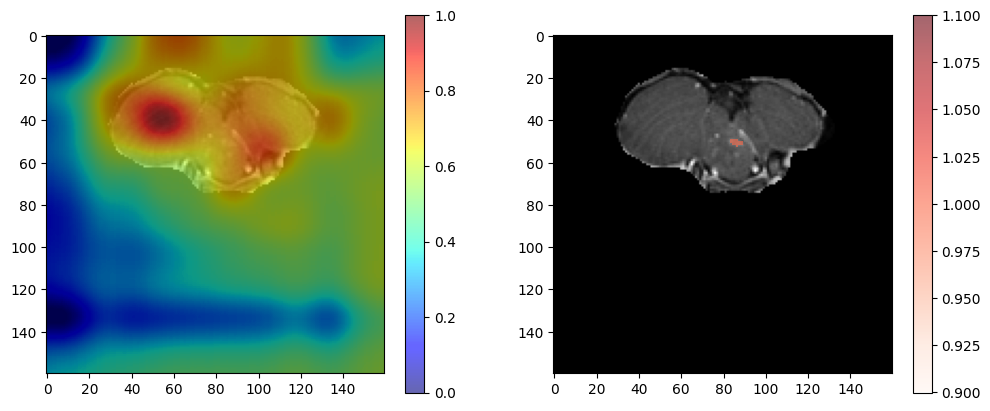

(2,)
95
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([0])
guided_gradients1 17315
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 0


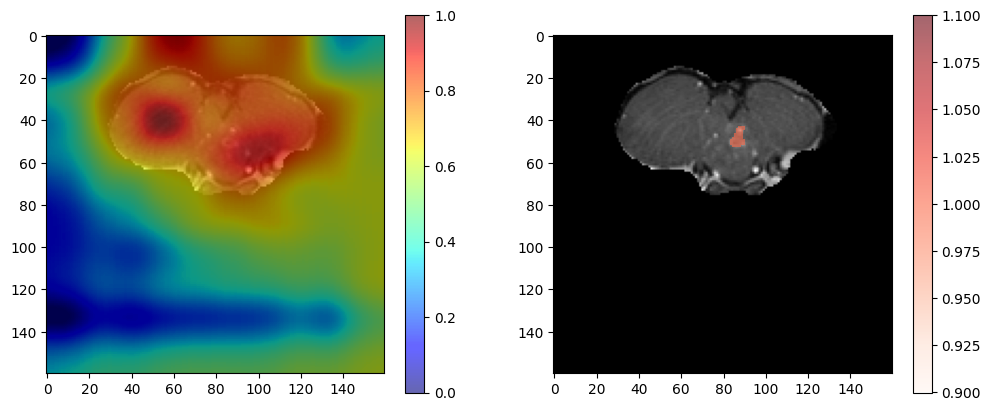

(2,)
96
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([0])
guided_gradients1 17319
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 0


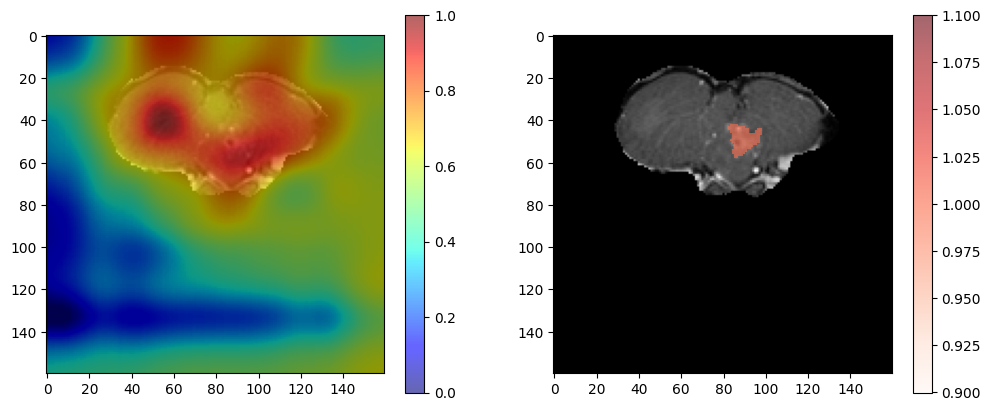

(2,)
97
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([0])
guided_gradients1 17323
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 0


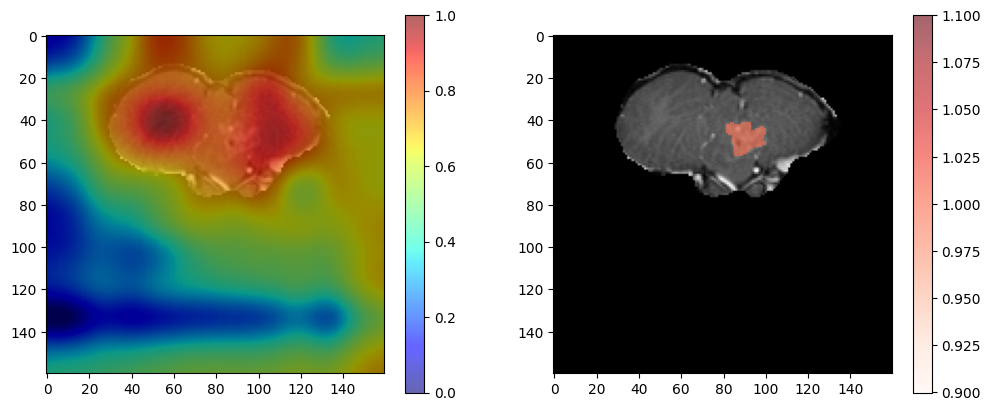

(2,)
98
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([0])
guided_gradients1 17327
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 0


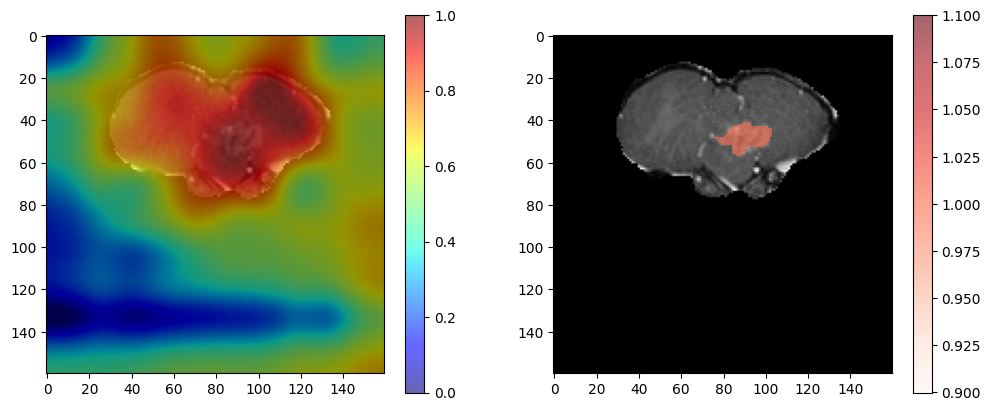

(2,)
99
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([0])
guided_gradients1 17331
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 0


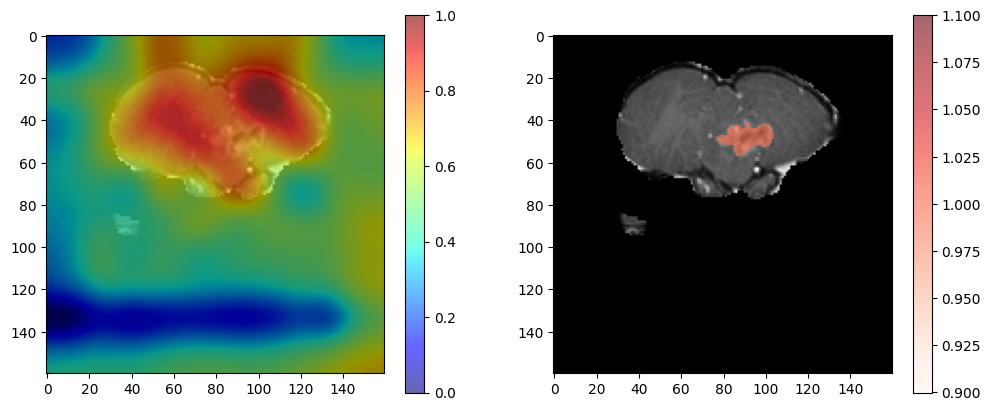

(2,)
100
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([0])
guided_gradients1 17335
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 0


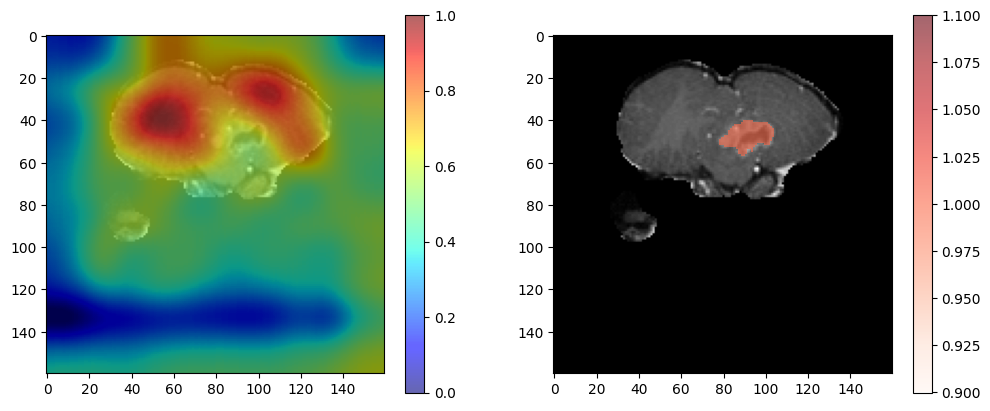

(2,)
101
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([0])
guided_gradients1 17339
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 0


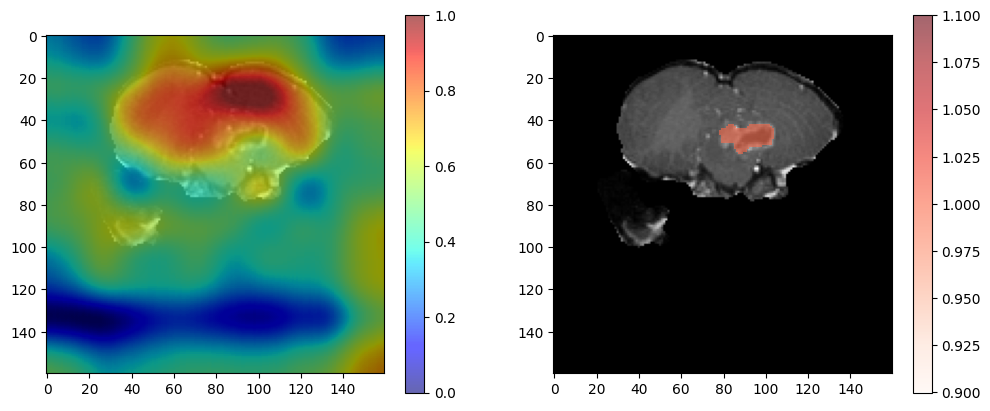

(2,)
102
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([0])
guided_gradients1 17343
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 0


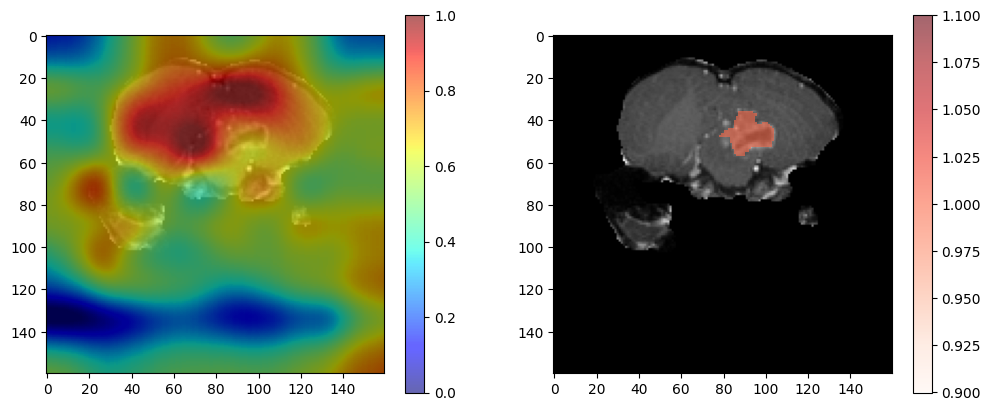

(2,)
103
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([0])
guided_gradients1 17347
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 0


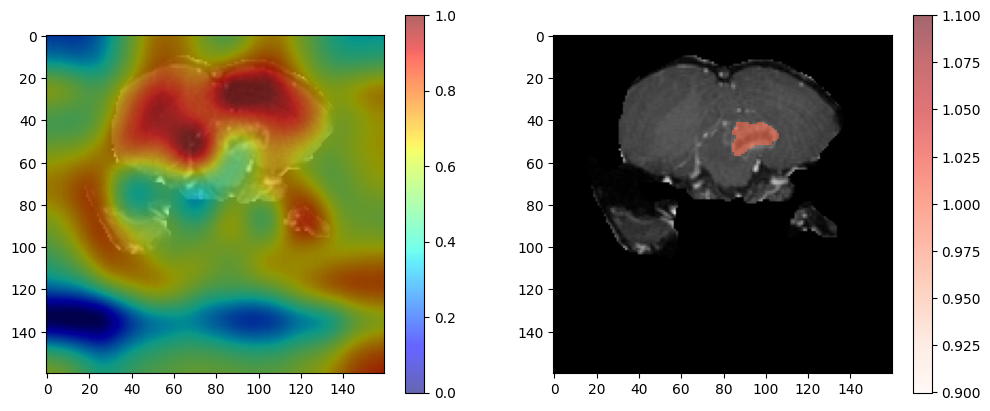

(2,)
104
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([0])
guided_gradients1 17351
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 0


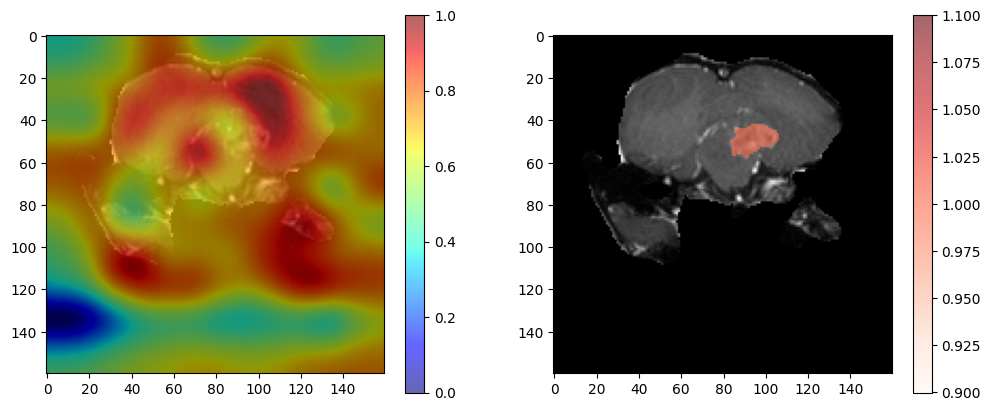

(2,)
105
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([0])
guided_gradients1 17355
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 0


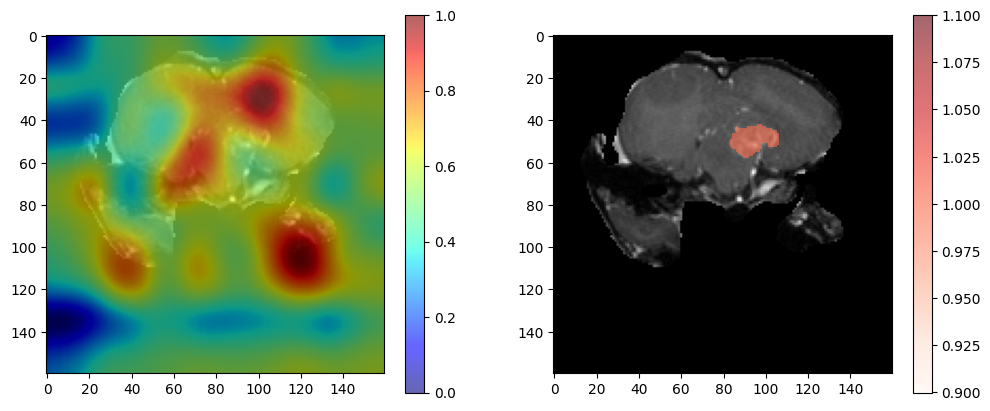

(2,)
106
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([0])
guided_gradients1 17359
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 0


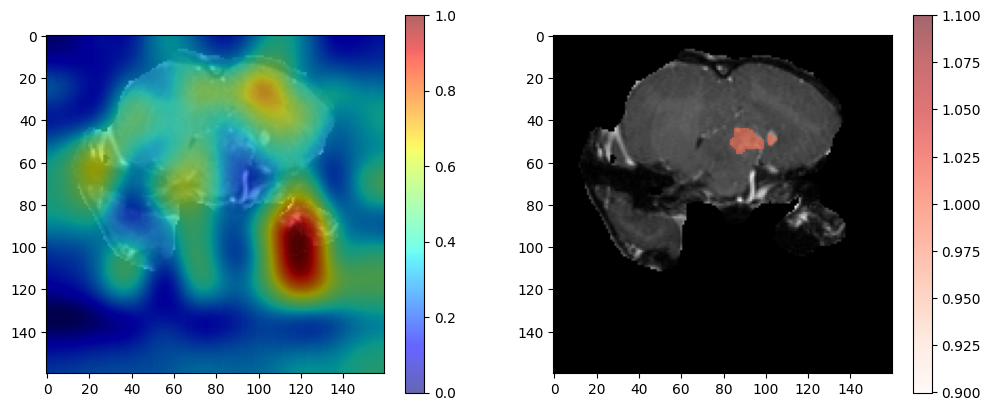

(2,)
107
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([0])
guided_gradients1 17363
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 0


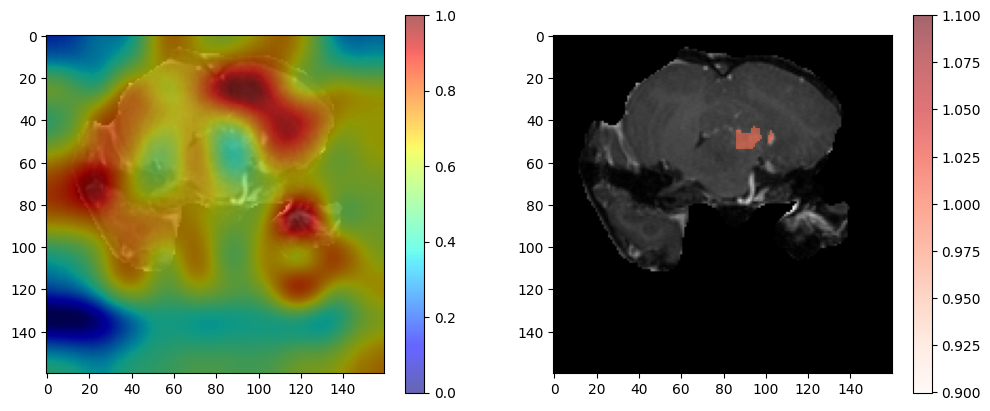

(2,)
108
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([0])
guided_gradients1 17367
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 0


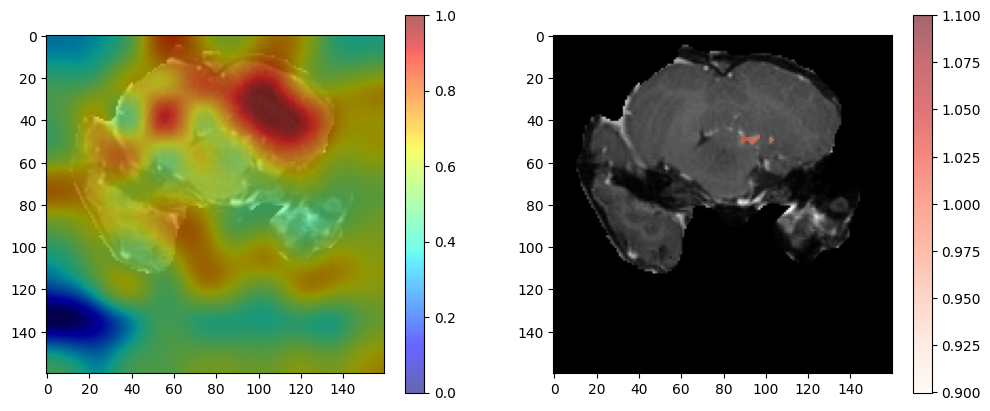

(2,)
109
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([1])
guided_gradients1 17371
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 1


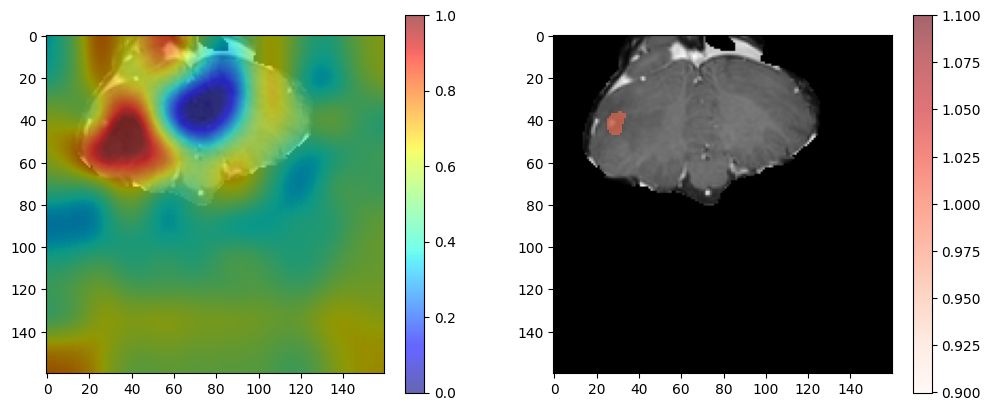

(2,)
110
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([1])
guided_gradients1 17375
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 1


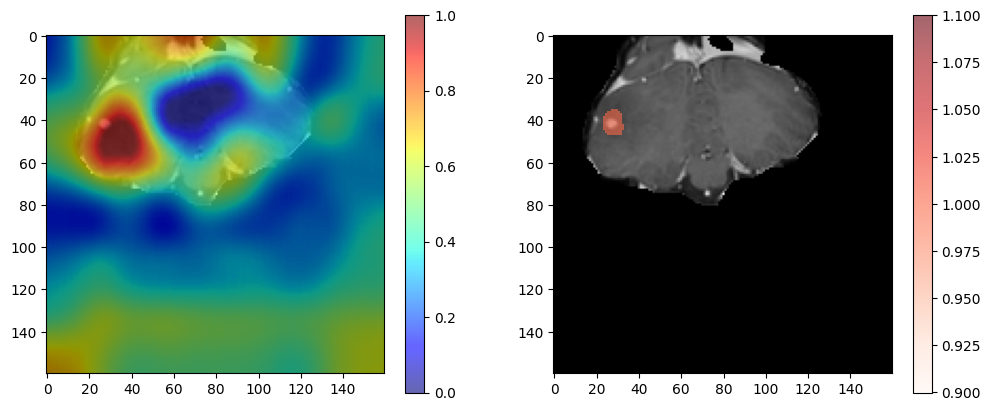

(2,)
111
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([1])
guided_gradients1 17379
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 1


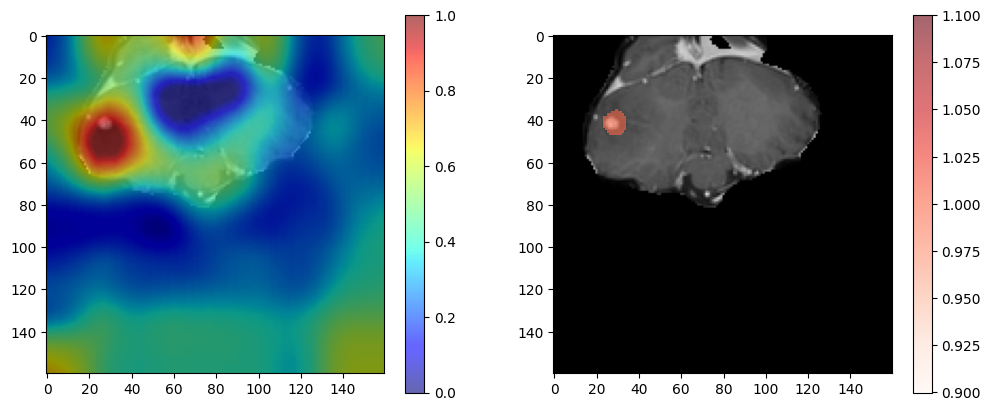

(2,)
112
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([1])
guided_gradients1 17383
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 1


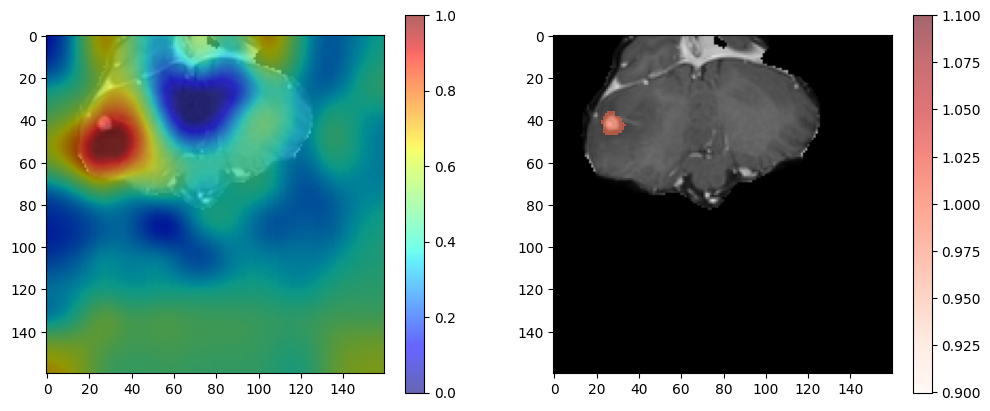

(2,)
113
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([1])
guided_gradients1 17387
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 1


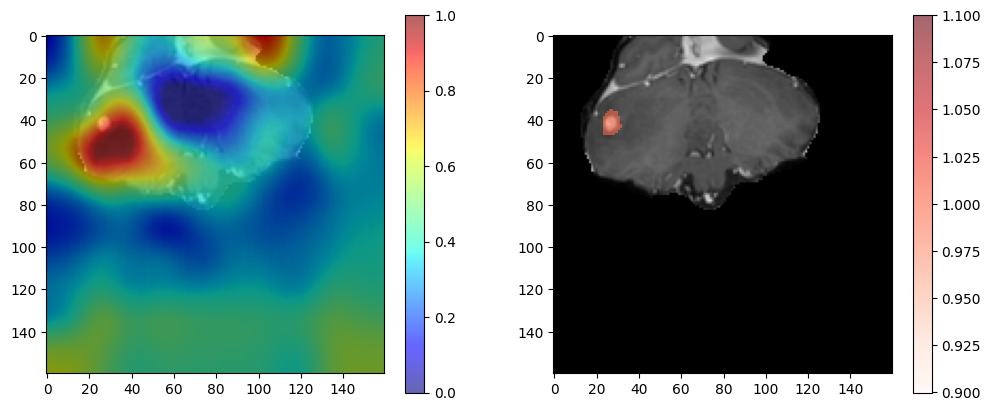

(2,)
114
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([1])
guided_gradients1 17391
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 1


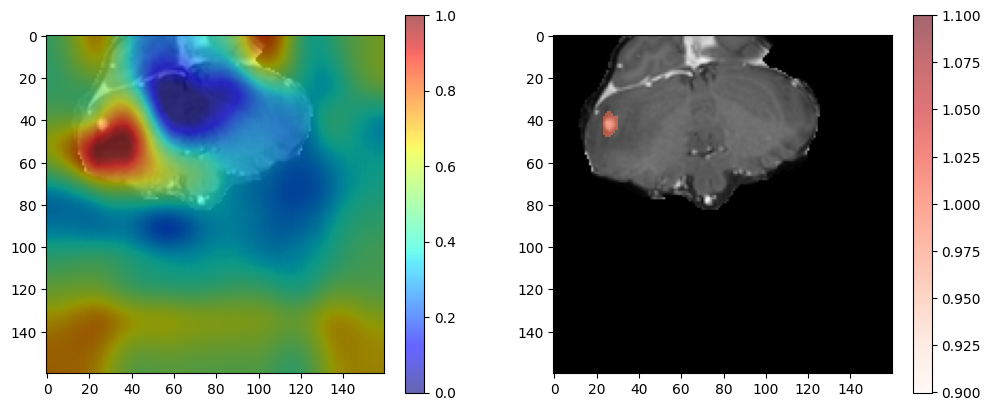

(2,)
115
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([1])
guided_gradients1 17395
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 1


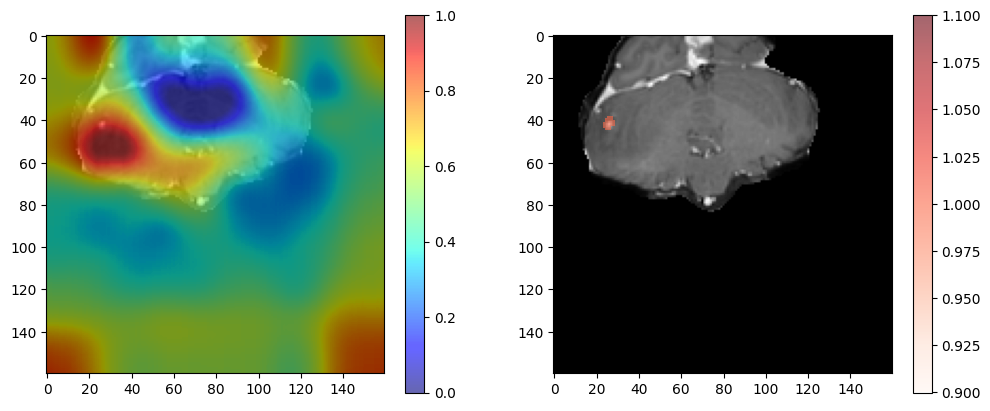

(2,)
116
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([1])
guided_gradients1 17399
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 1


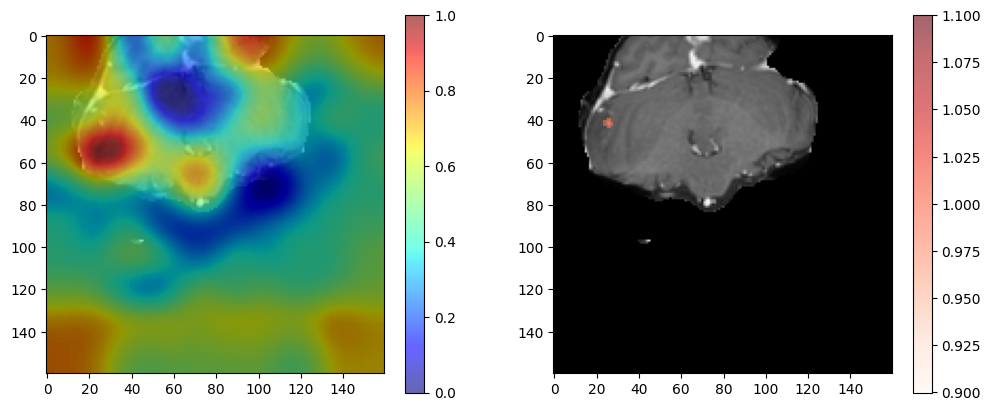

(2,)
117
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([1])
guided_gradients1 17403
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 1


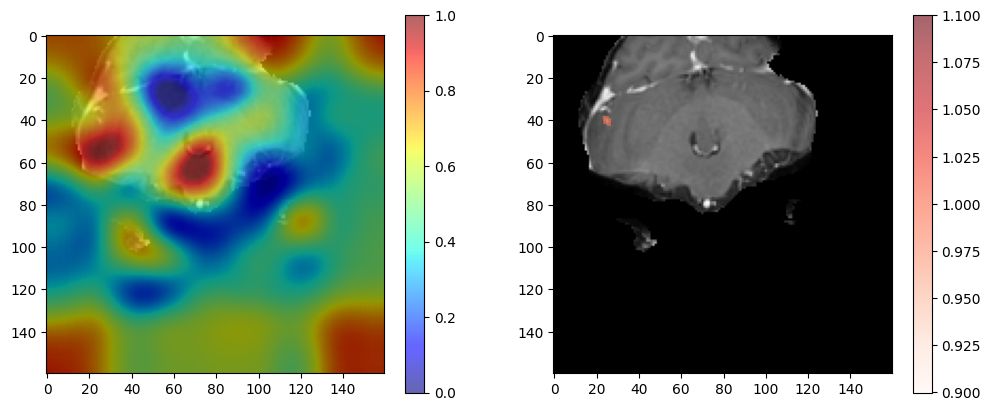

(2,)
118
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([0])
guided_gradients1 17407
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 0


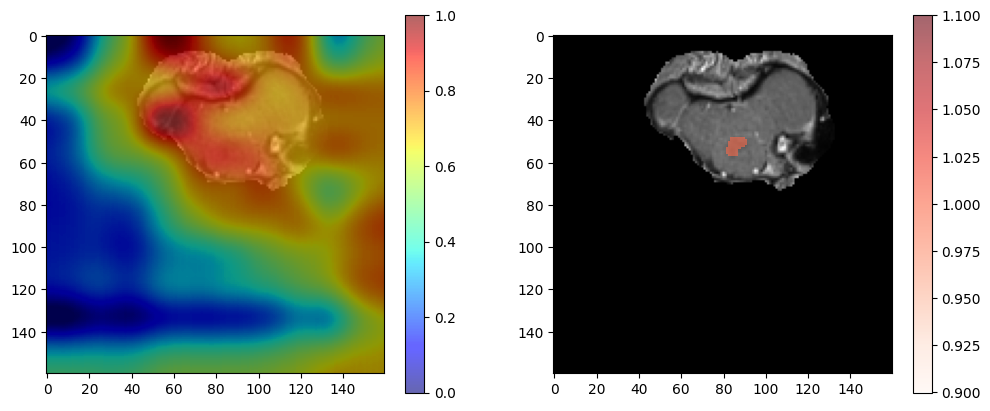

(2,)
119
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([0])
guided_gradients1 17411
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 0


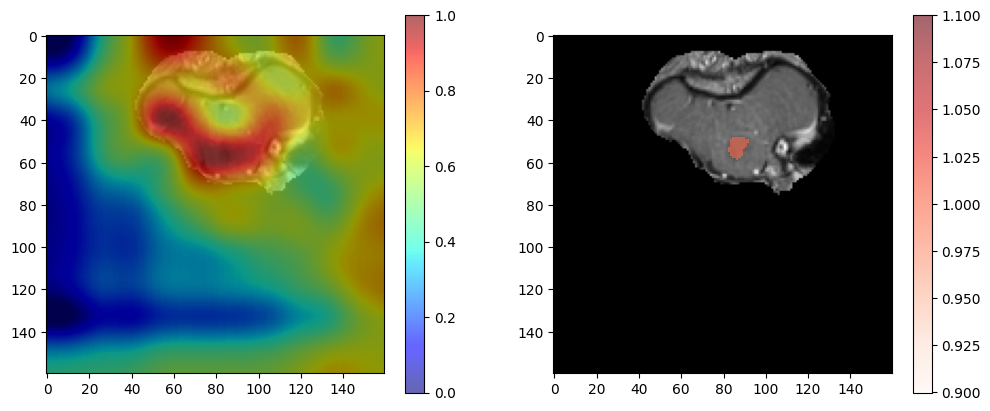

(2,)
120
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([0])
guided_gradients1 17415
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 0


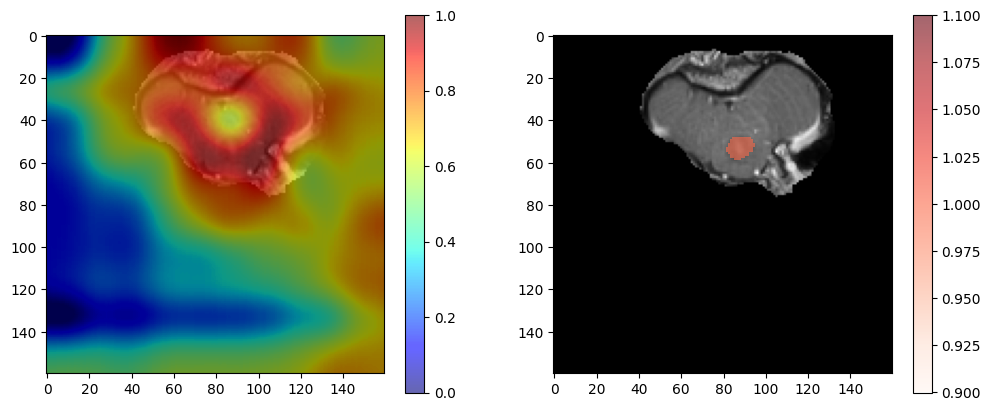

(2,)
121
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([0])
guided_gradients1 17419
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 0


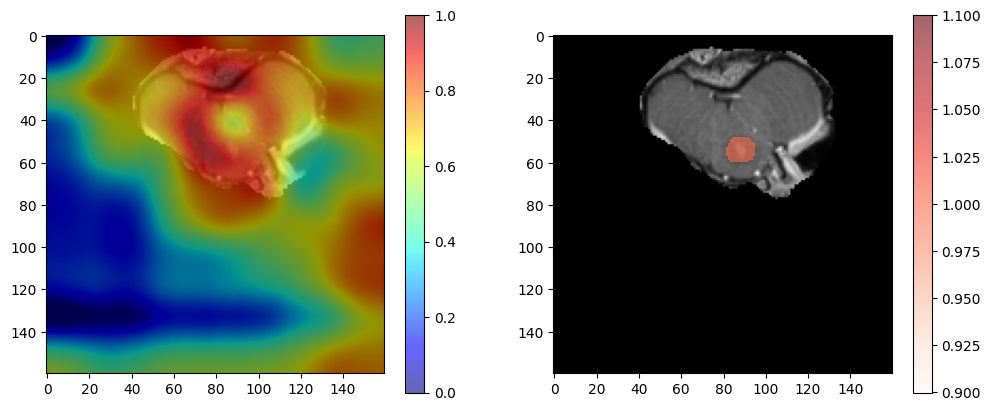

(2,)
122
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([0])
guided_gradients1 17423
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 0


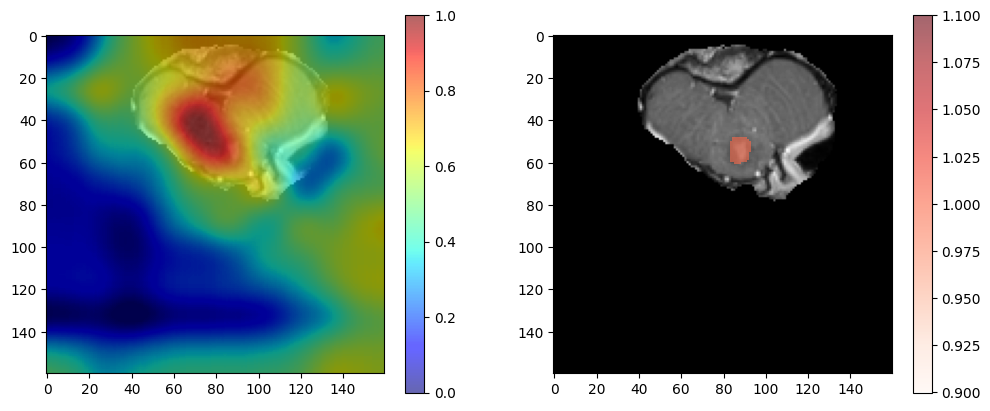

(2,)
123
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([0])
guided_gradients1 17427
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 0


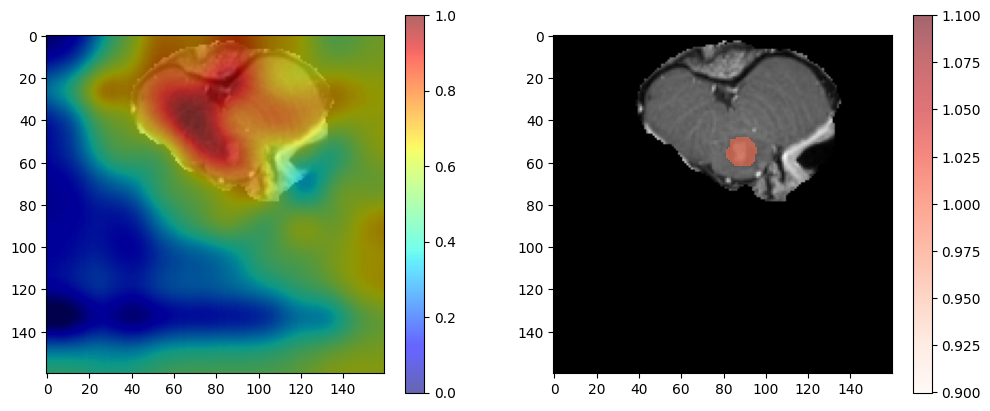

(2,)
124
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([0])
guided_gradients1 17431
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 0


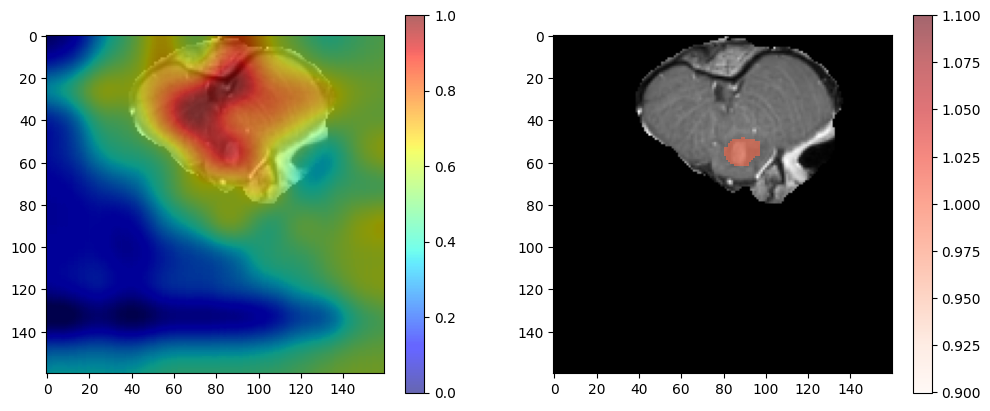

(2,)
125
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([0])
guided_gradients1 17435
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 0


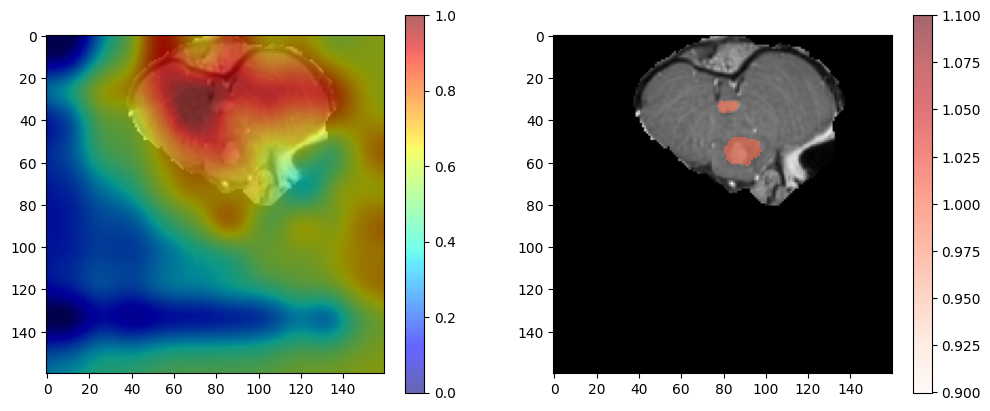

(2,)
126
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([0])
guided_gradients1 17439
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 0


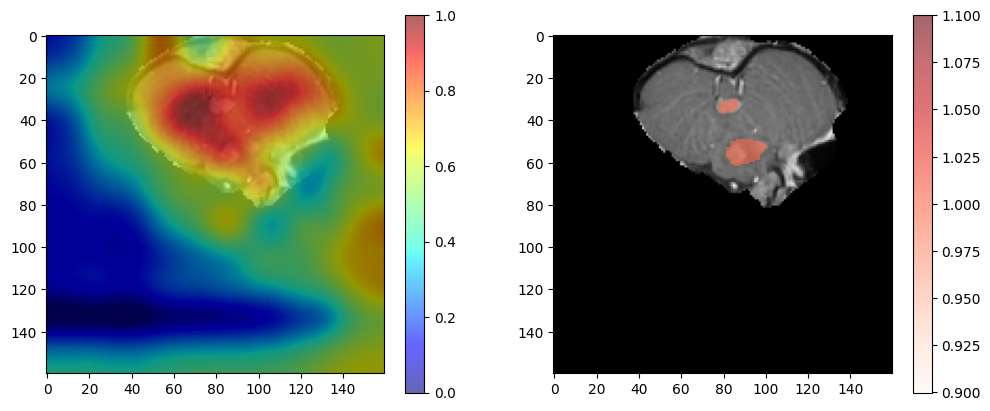

(2,)
127
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([0])
guided_gradients1 17443
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 0


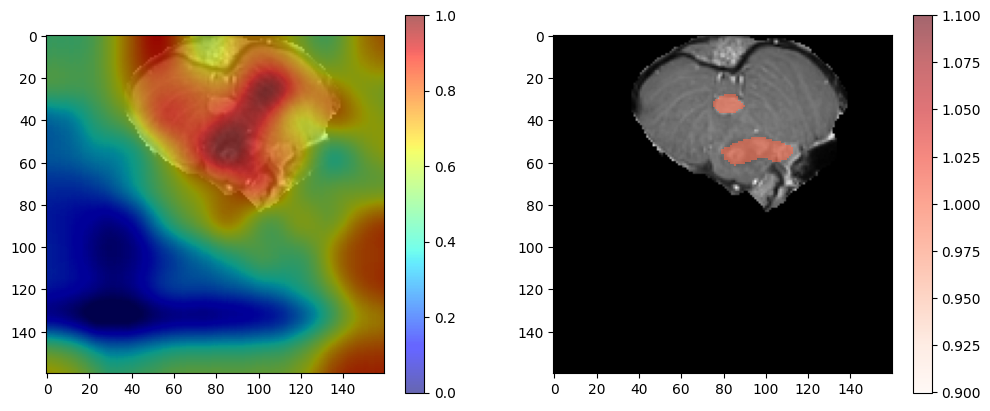

(2,)
128
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([0])
guided_gradients1 17447
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 0


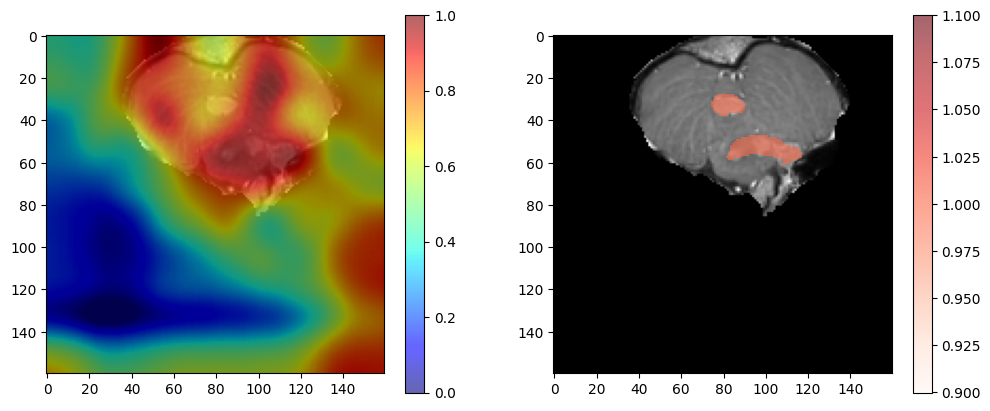

(2,)
129
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([0])
guided_gradients1 17451
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 0


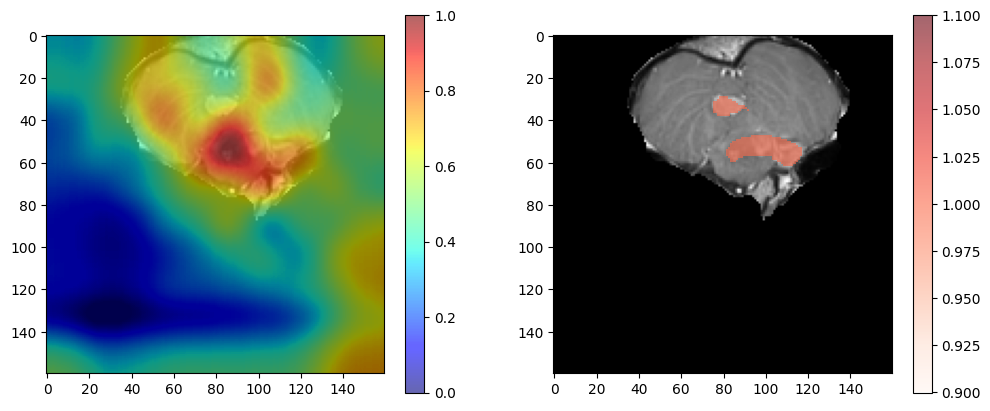

(2,)
130
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([0])
guided_gradients1 17455
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 0


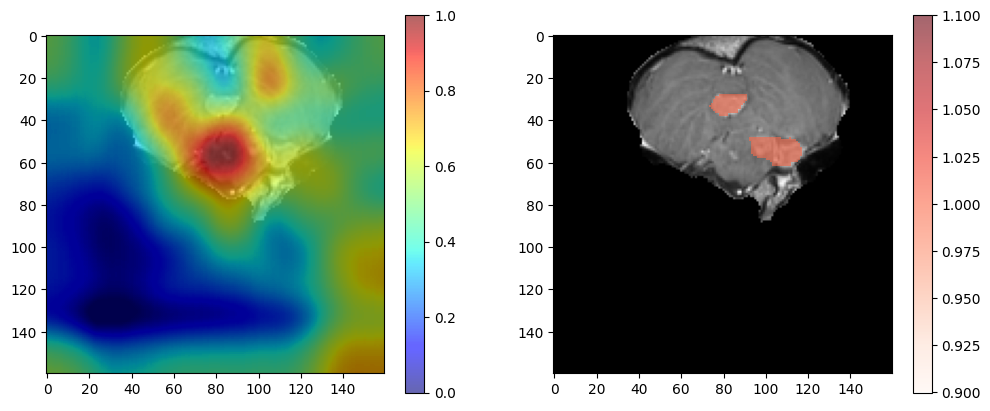

(2,)
131
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([0])
guided_gradients1 17459
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 0


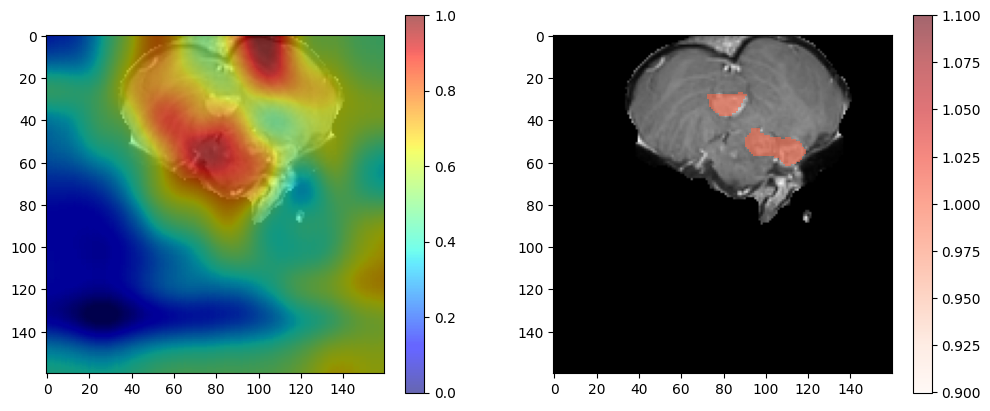

(2,)
132
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([0])
guided_gradients1 17463
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 0


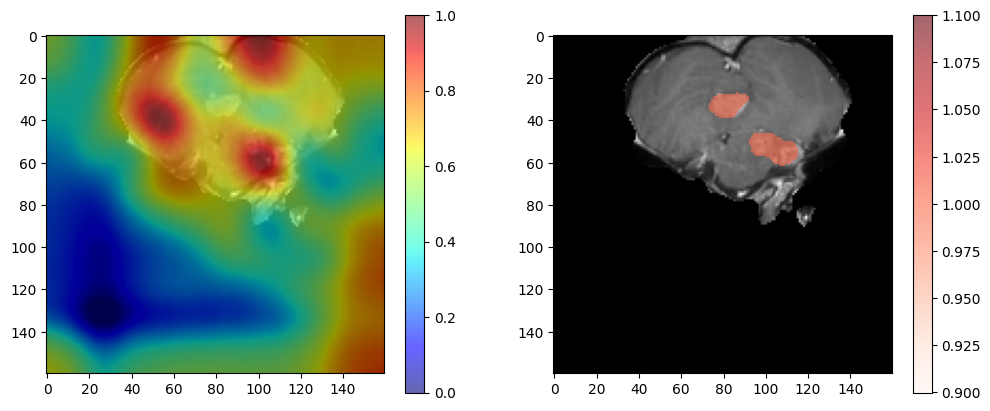

(2,)
133
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([0])
guided_gradients1 17467
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 0


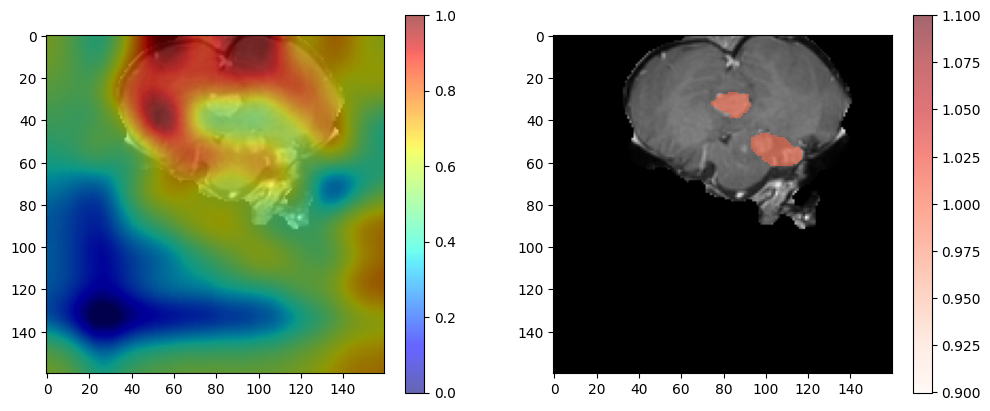

(2,)
134
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([0])
guided_gradients1 17471
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 0


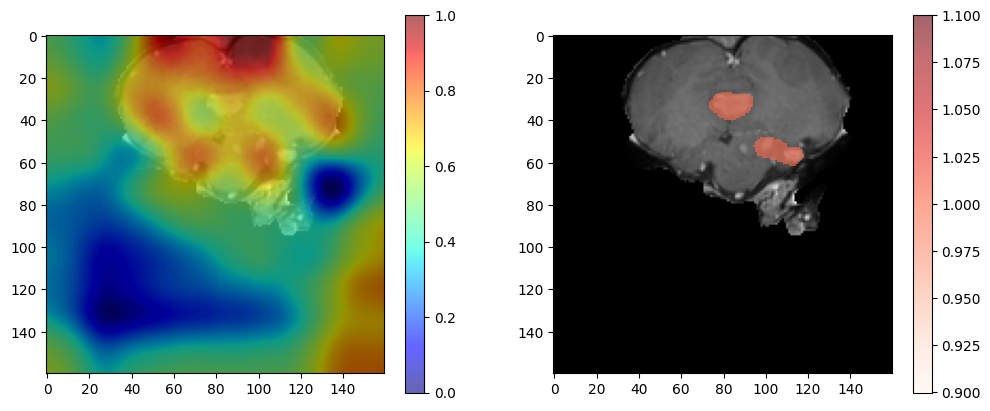

(2,)
135
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([0])
guided_gradients1 17475
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 0


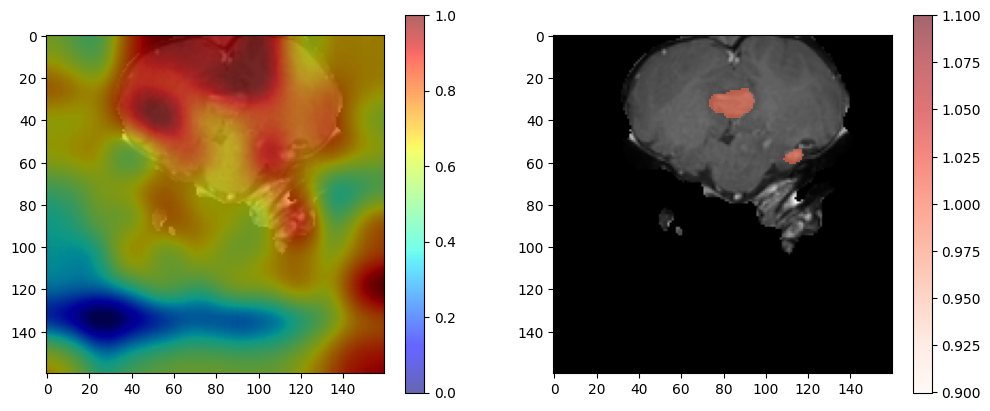

(2,)
136
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([0])
guided_gradients1 17479
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 0


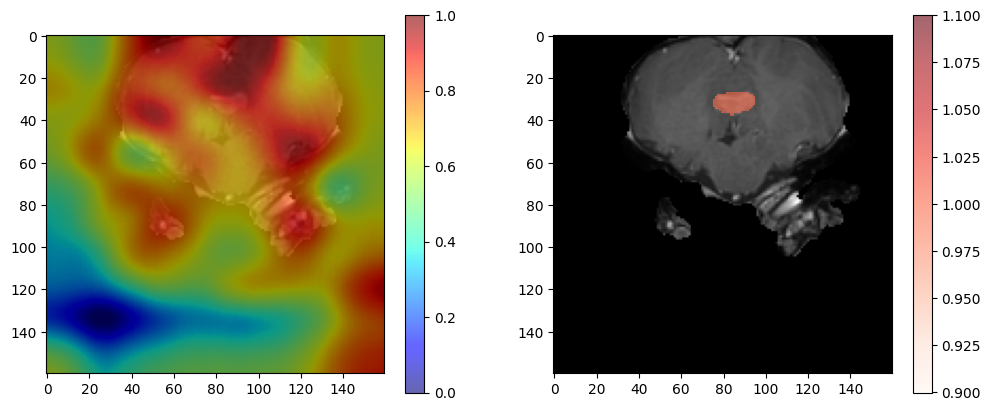

(2,)
137
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([0])
guided_gradients1 17483
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 0


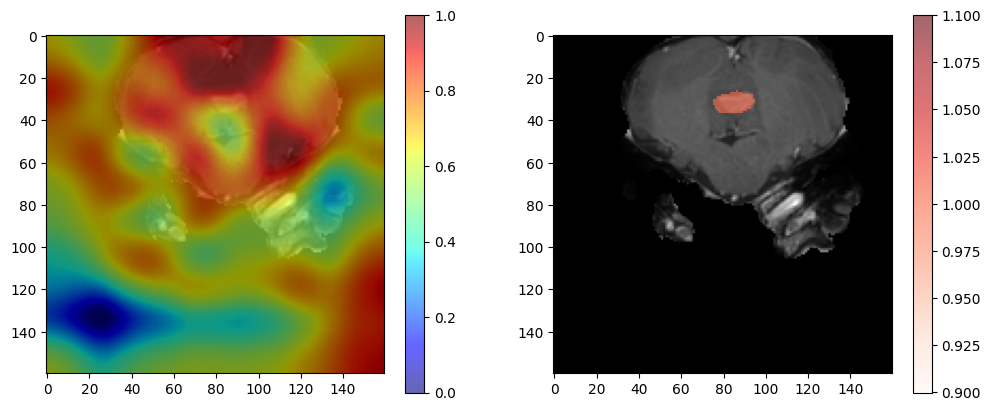

(2,)
138
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([0])
guided_gradients1 17487
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 0


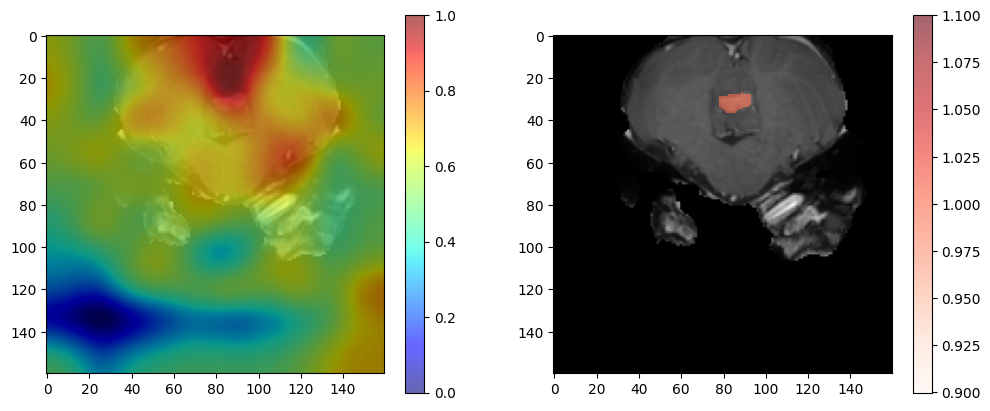

(2,)
139
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([0])
guided_gradients1 17491
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 0


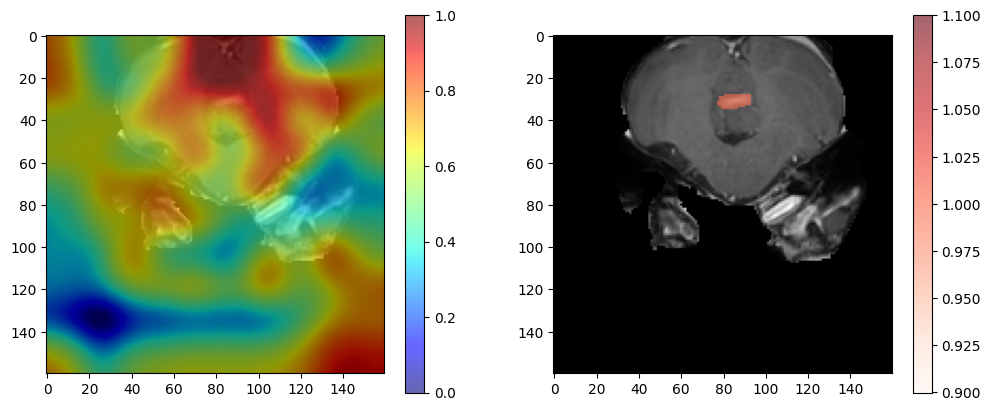

(2,)
140
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([0])
guided_gradients1 17495
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 0


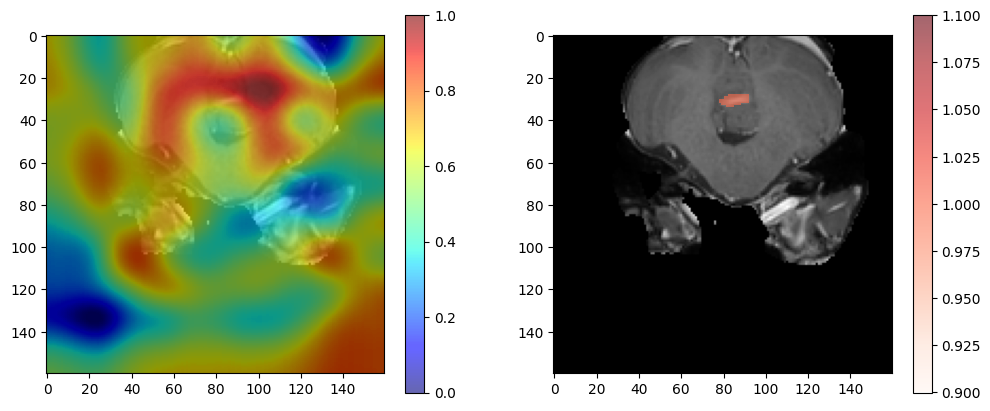

(2,)
141
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([0])
guided_gradients1 17499
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 0


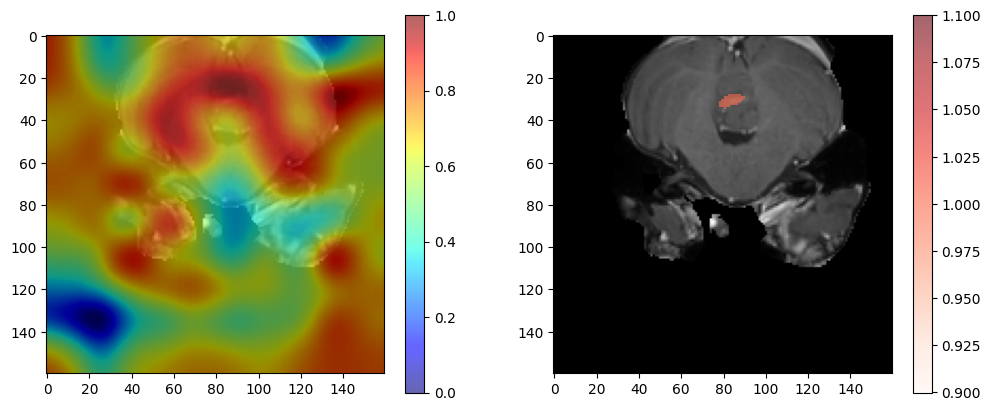

(2,)
142
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([0])
guided_gradients1 17503
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 0


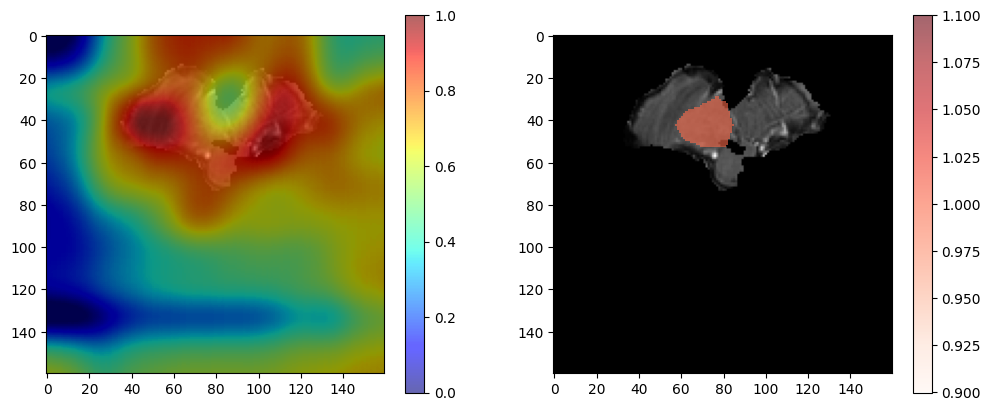

(2,)
143
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([0])
guided_gradients1 17507
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 0


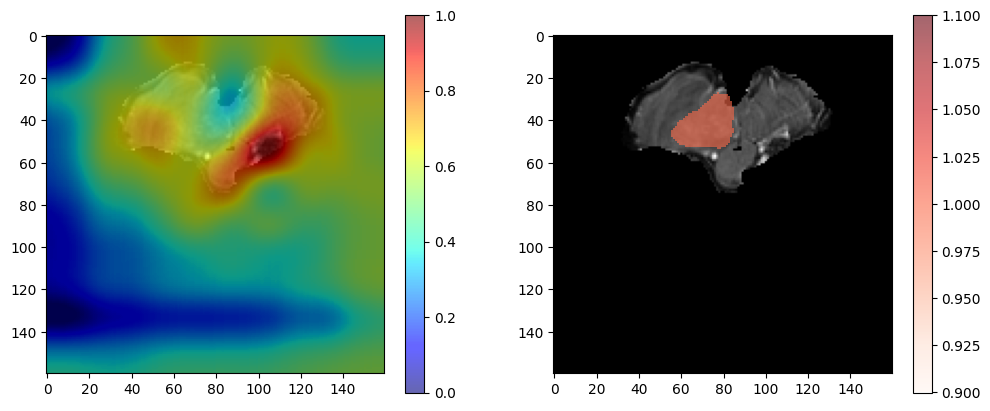

(2,)
144
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([0])
guided_gradients1 17511
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 0


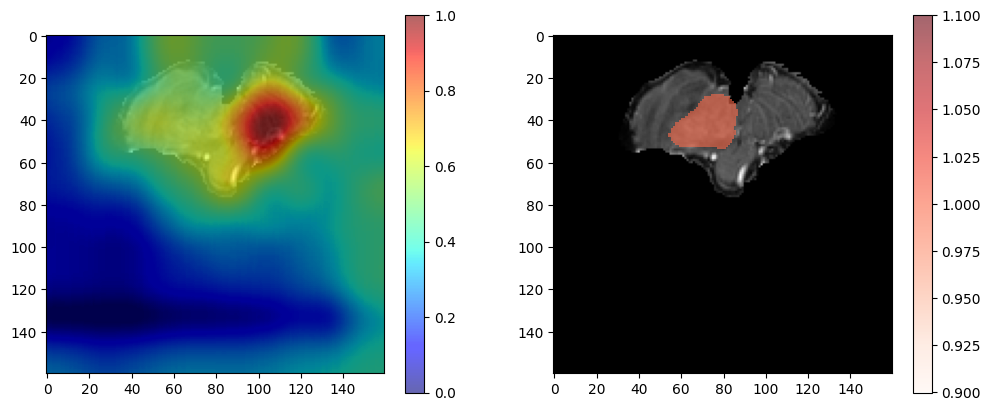

(2,)
145
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([0])
guided_gradients1 17515
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 0


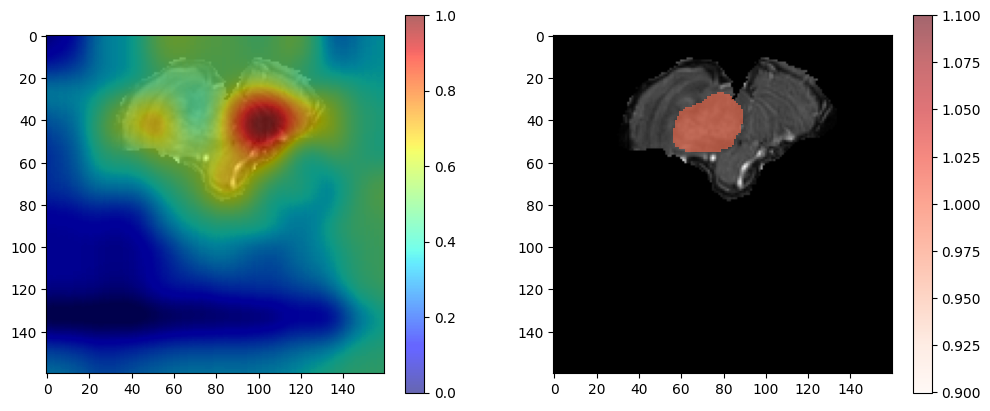

(2,)
146
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([0])
guided_gradients1 17519
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 0


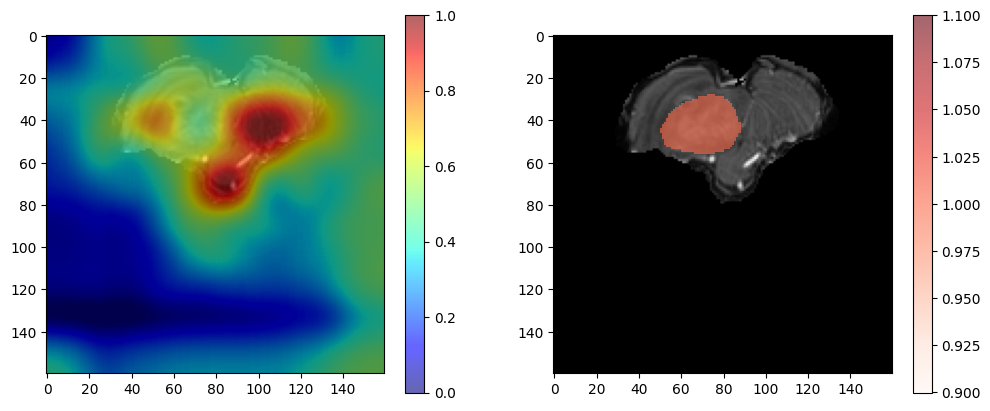

(2,)
147
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([0])
guided_gradients1 17523
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 0


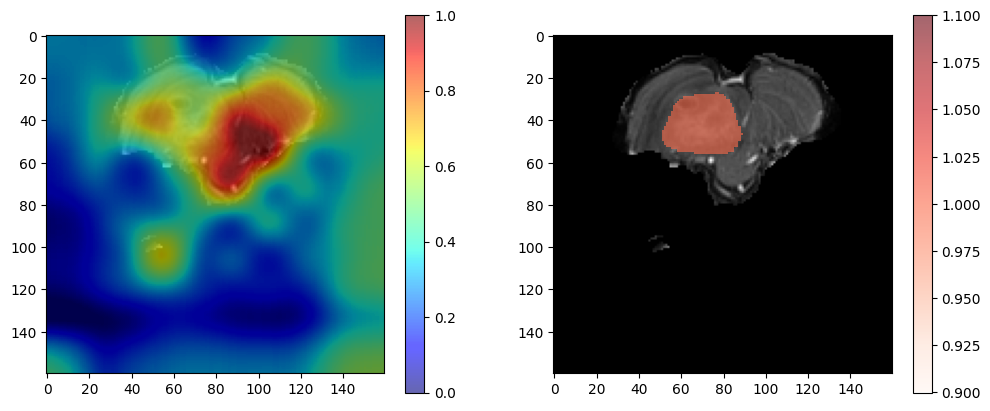

(2,)
148
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([0])
guided_gradients1 17527
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 0


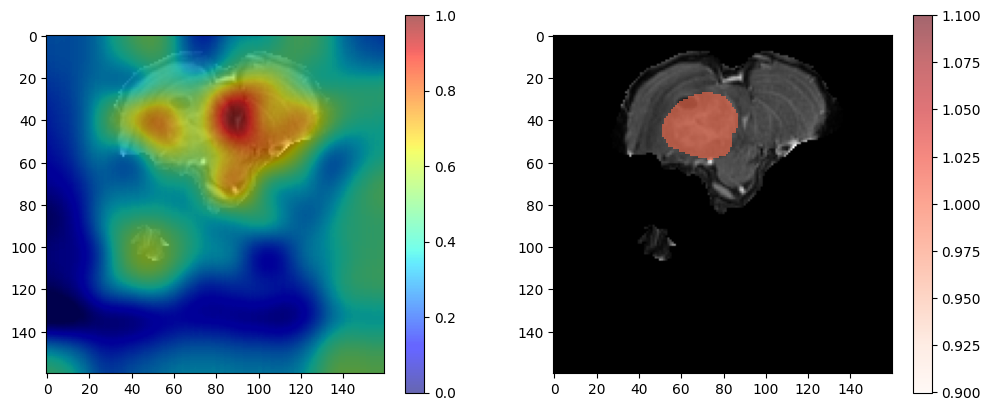

(2,)
149
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([0])
guided_gradients1 17531
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 0


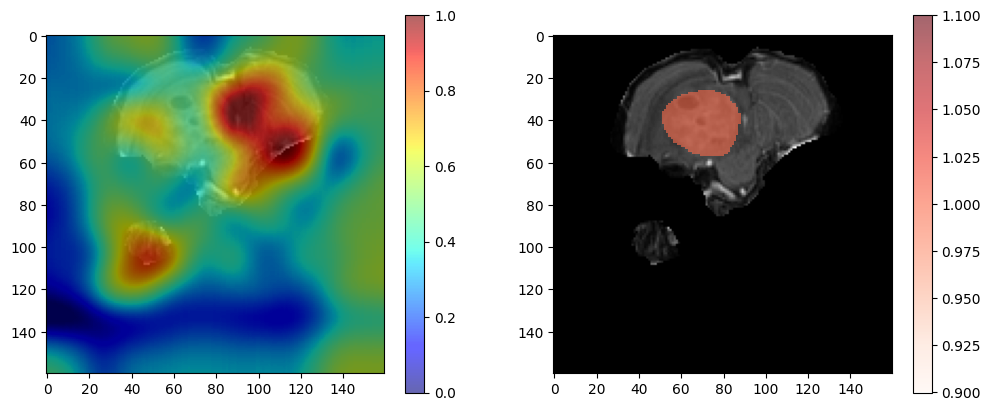

(2,)
150
torch.Size([1, 1, 160, 160])
torch.Size([1, 160, 160])
tensor([0])
guided_gradients1 17535
guided_gradients2 (256, 10, 10)
guided_gradients3 (256,)
target (256, 10, 10)
cam (10, 10)
maxindex 0


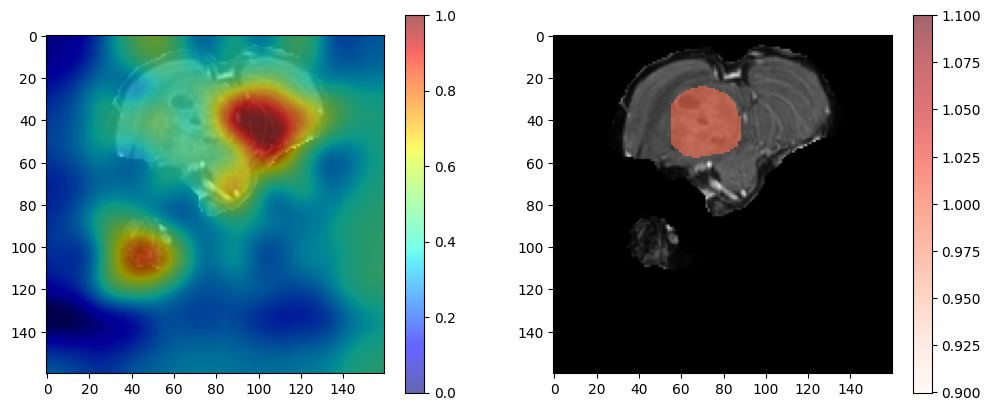

(2,)


In [57]:
for idx, i in enumerate(val_dataLoader):
#     print(idx)
    print(idx)
    print(i[0].shape)
    print(i[1].shape)
    print(i[2])
    
    pred, cam = Gcam.generate_cam(i[0], 2, target_class=i[2].item())
    pred = pred.squeeze().detach().numpy()
    maxindex = np.argmax(pred)
    print('maxindex', maxindex)
    
    if maxindex == i[2].item():
        fig = plt.figure(figsize=(12, 5), dpi=100)
        image = i[0].detach().numpy().squeeze()
        plt.subplot(121)
        plt.imshow(image,cmap='gray')
        plt.imshow(cam,alpha=0.6, cmap='jet')
        plt.colorbar()
#         plt.show()
        
        mask = i[1].detach().numpy().squeeze().astype('float')
#         mask = mask*255
        mask[mask==0.] = np.NaN
        plt.subplot(122)
        plt.imshow(image,cmap='gray')
        plt.imshow(mask,cmap='Reds', alpha=0.6)
        plt.colorbar()
        plt.show()
        print(pred.shape)
#         break
    if idx == 150:
        break

In [80]:
import numpy as np
from mindspore import Tensor
from mindspore.nn.metrics import HausdorffDistance

x = Tensor(np.array([[3, 0, 1], [1, 3, 0], [1, 0, 2]]))
y = Tensor(np.array([[0, 2, 1], [1, 2, 1], [0, 0, 1]]))
metric = HausdorffDistance()
metric.clear()
metric.update(x, y, 0)
distance = metric.eval()
print(distance)


1.4142135623730951


In [81]:
x

Tensor(shape=[3, 3], dtype=Int64, value=
[[3, 0, 1],
 [1, 3, 0],
 [1, 0, 2]])

In [82]:
y

Tensor(shape=[3, 3], dtype=Int64, value=
[[0, 2, 1],
 [1, 2, 1],
 [0, 0, 1]])

In [88]:
a = np.array([1,2,3])
a = np.array([1,2,3])
c = np.stack([a,a])

In [89]:
c.shape

(2, 3)

In [90]:
a.sum()

6